In [ ]:
import torch

print("CUDA available:", torch.cuda.is_available())
print("Current GPU:", torch.cuda.get_device_name(0))
print("CUDA version:", torch.version.cuda)
print("cuDNN version:", torch.backends.cudnn.version())


CUDA available: True
Current GPU: NVIDIA L4
CUDA version: 12.1
cuDNN version: 90100


In [ ]:
## Data Clearing ##
## Missing Data ##

MCAR with Ridge model: MSE = 0.0454
MCAR with Lasso model: MSE = 0.0878
MCAR with MLP model: MSE = 0.0037
MAR with Ridge model: MSE = 0.0545
MAR with Lasso model: MSE = 0.1242
MAR with MLP model: MSE = 0.0051
MNAR with Ridge model: MSE = 0.0030
MNAR with Lasso model: MSE = 0.9851
MNAR with MLP model: MSE = 0.0046

Experiment Demonstration:
  Missing Type  Model       MSE
0         MCAR  Ridge  0.045445
1         MCAR  Lasso  0.087837
2         MCAR    MLP  0.003703
3          MAR  Ridge  0.054535
4          MAR  Lasso  0.124187
5          MAR    MLP  0.005081
6         MNAR  Ridge  0.003041
7         MNAR  Lasso  0.985051
8         MNAR    MLP  0.004597


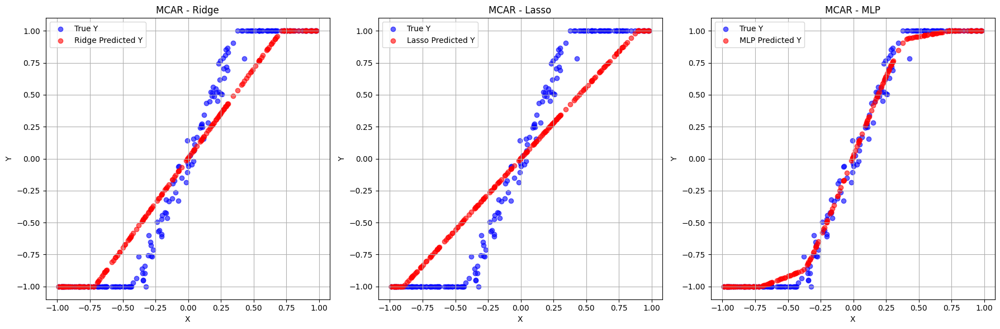

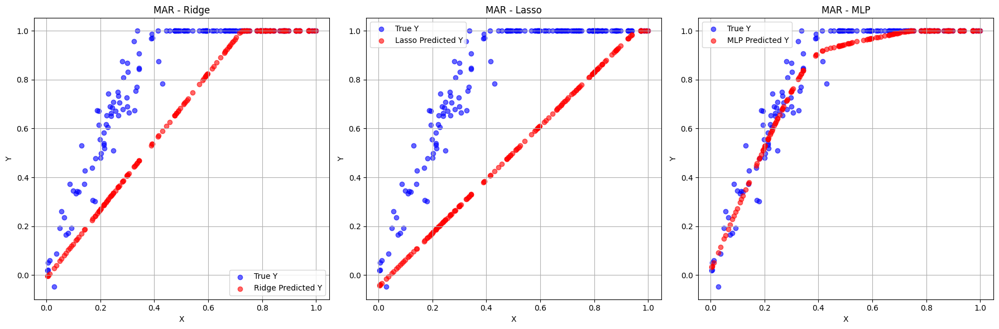

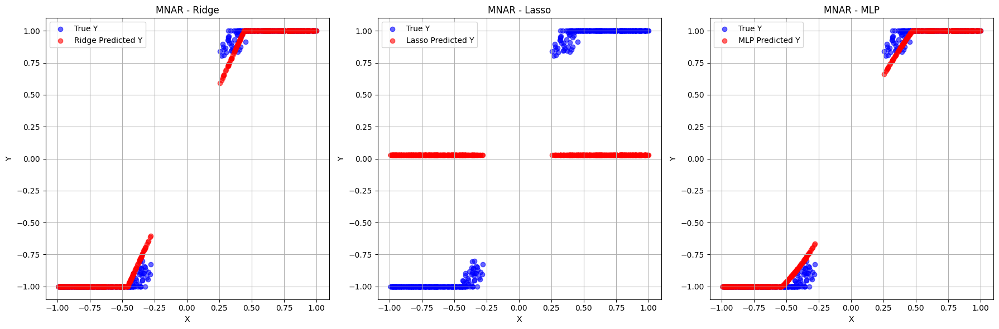

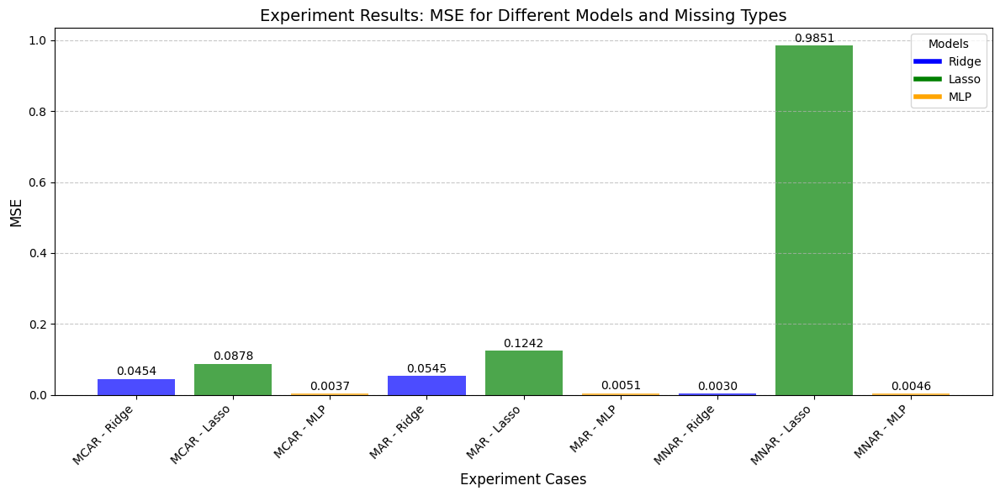

In [ ]:
import numpy as np
import pandas as pd
from sklearn.linear_model import Ridge, Lasso
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

np.random.seed(42)
n_samples = 1000
# X is the independent variable, Y is the dependent variable
X = np.random.uniform(low=-1, high=1, size=n_samples)
Y = 2.5 * X + np.random.normal(loc=0, scale=0.1, size=n_samples)
Y = np.clip(Y, -1, 1)
data = pd.DataFrame({'X': X, 'Y': Y})

def run_experiment(data_with_missing, model, model_name):
    train_data = data_with_missing.dropna()
    predict_data = data_with_missing[data_with_missing['Y'].isna()].copy()

    X_train = train_data[['X']]
    y_train = train_data['Y']
    X_predict = predict_data[['X']]

    model.fit(X_train, y_train)

    # predict missing Y
    predict_data.loc[:, f'Y_pred_{model_name}'] = np.clip(model.predict(X_predict), -1, 1)

    # Combine predictions with true values
    predicted_data = predict_data[['X', f'Y_pred_{model_name}']].copy()
    predicted_data['Y_true'] = data.loc[predict_data.index, 'Y']

    # MSE Loss
    mse = mean_squared_error(predicted_data['Y_true'], predicted_data[f'Y_pred_{model_name}'])

    return mse, predicted_data

# Simulate datasets with three types of missingness
mcar_data = data.copy() # Missing Completely At Random (MCAR)
mcar_data.loc[mcar_data.sample(frac=0.2, random_state=42).index, 'Y'] = np.nan # Randomly remove 20% of Y values

mar_data = data.copy() # Missing At Random (MAR)
mar_data.loc[(mar_data['X'] > 0) & (np.random.rand(n_samples) < 0.3), 'Y'] = np.nan # 30% probability of missing Y when X > 0

mnar_data = data.copy() # Missing Not At Random (MNAR)
mnar_data.loc[(mnar_data['Y'] > 0.8) | (mnar_data['Y'] < -0.8), 'Y'] = np.nan # Missing Y at extreme values, lower than -0.8 and higher than 0.8

# Define Models
ridge_model = Ridge(alpha=1.0)
lasso_model = Lasso(alpha=0.1)
mlp_model = MLPRegressor(hidden_layer_sizes=(100, 50), activation='relu', solver='adam', max_iter=1000)
results = []

# Conduct experiments on Ridge, Lasso and MLP
for missing_type, missing_data in zip(['MCAR', 'MAR', 'MNAR'], [mcar_data, mar_data, mnar_data]):
    for model, model_name in zip([ridge_model, lasso_model, mlp_model], ['Ridge', 'Lasso', 'MLP']):
        mse, predicted_data = run_experiment(missing_data.copy(), model, model_name)
        results.append({
            'Missing Type': missing_type,
            'Model': model_name,
            'MSE': mse
        })
        print(f"{missing_type} with {model_name} model: MSE = {mse:.4f}")

# Demo
results_df = pd.DataFrame(results)
print("\nExperiment Demonstration:")
print(results_df)

# visualization
for missing_type in ['MCAR', 'MAR', 'MNAR']:
    plt.figure(figsize=(18, 6))
    for i, model_name in enumerate(['Ridge', 'Lasso', 'MLP']):
        plt.subplot(1, 3, i+1)
        data_to_plot = run_experiment(eval(f'{missing_type.lower()}_data'), eval(f'{model_name.lower()}_model'), model_name)[1]
        plt.scatter(data_to_plot['X'], data_to_plot['Y_true'], color='blue', alpha=0.6, label='True Y')
        plt.scatter(data_to_plot['X'], data_to_plot[f'Y_pred_{model_name}'], color='red', alpha=0.6, label=f'{model_name} Predicted Y')
        plt.title(f'{missing_type} - {model_name}')
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.legend()
        plt.grid(True)
    plt.tight_layout()
    plt.show()

# Bar plot for MSE values
plt.figure(figsize=(12, 6))
colors = {'Ridge': 'blue', 'Lasso': 'green', 'MLP': 'orange'}

# Create a bar chart
bar_positions = []
for i, missing_type in enumerate(results_df['Missing Type'].unique()):
    subset = results_df[results_df['Missing Type'] == missing_type]
    positions = range(i * 3, i * 3 + len(subset))
    bar_positions.extend(positions)
    plt.bar(
        positions,
        subset['MSE'],
        color=[colors[model] for model in subset['Model']],
        alpha=0.7,
        label=missing_type if i == 0 else ""
    )

# Annotate each bar with its value
for position, row in zip(bar_positions, results_df.iterrows()):
    index, row = row
    plt.text(
        position,
        row['MSE'] + 0.01,  # Position the text slightly above the bar
        f"{row['MSE']:.4f}",
        ha='center',
        fontsize=10
    )

# Add labels, title, and legend
plt.xlabel('Experiment Cases', fontsize=12)
plt.ylabel('MSE', fontsize=12)
plt.title('Experiment Results: MSE for Different Models and Missing Types', fontsize=14)
plt.xticks(bar_positions, [f"{row['Missing Type']} - {row['Model']}" for _, row in results_df.iterrows()], rotation=45, ha='right')
plt.legend(handles=[plt.Line2D([0], [0], color=color, lw=4) for color in colors.values()], labels=colors.keys(), title="Models", fontsize=10)
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


In [ ]:
## Data Clearing ##
## Outliers ##

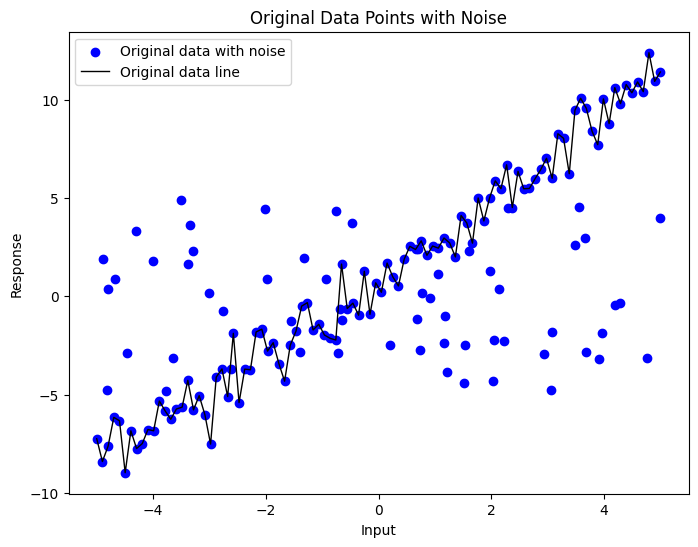

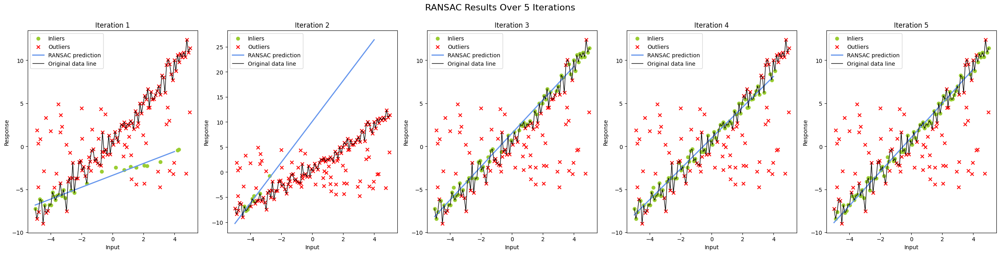

RANSAC Parameters and Results:
Minimum Samples: 2
Threshold: 1.0
Max Trials: 5
Inliers Count for each iteration: [27, 9, 64, 67, 70]


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import linear_model

np.random.seed(0)
n_samples = 100
n_outliers = 60
X = np.linspace(-5, 5, n_samples)
y = 2 * X + 1 + np.random.normal(size=X.shape)

# Add noise
X_with_noise = np.concatenate([X, np.random.uniform(-5, 5, n_outliers)])
y_with_noise = np.concatenate([y, 10 * (np.random.random(n_outliers) - 0.5)])

plt.figure(figsize=(8, 6))
plt.scatter(X_with_noise, y_with_noise, color='blue', marker='o', label='Original data with noise')
plt.plot(X, y, color='black', linewidth=1, label='Original data line')
plt.title("Original Data Points with Noise")
plt.xlabel("Input")
plt.ylabel("Response")
plt.legend(loc='best')
plt.show()

X_with_noise_reshaped = X_with_noise.reshape(-1, 1)

# RANSAC Parameters
ransac_params = {
    'min_samples': 2,
    'residual_threshold': 1.0,
    'max_trials': 5,
}

ransac = linear_model.RANSACRegressor(
    min_samples=ransac_params['min_samples'],
    residual_threshold=ransac_params['residual_threshold'],
    max_trials=ransac_params['max_trials']
)

fig, axes = plt.subplots(1, 5, figsize=(25, 6))

# record outliers during each epoch
inliers_counts = []

for i in range(1, 6):
    ransac.set_params(max_trials=i)
    ransac.fit(X_with_noise_reshaped, y_with_noise)

    line_X = np.arange(X_with_noise.min(), X_with_noise.max())[:, np.newaxis]
    line_y_ransac = ransac.predict(line_X)
    inlier_mask = ransac.inlier_mask_
    outlier_mask = np.logical_not(inlier_mask)

    # Record Outliers Each Epoch
    current_inliers = np.sum(inlier_mask)
    inliers_counts.append(current_inliers)

    ax = axes[i-1]
    ax.scatter(X_with_noise[inlier_mask], y_with_noise[inlier_mask], color='yellowgreen', marker='o', label='Inliers')
    ax.scatter(X_with_noise[outlier_mask], y_with_noise[outlier_mask], color='red', marker='x', label='Outliers')
    ax.plot(line_X, line_y_ransac, color='cornflowerblue', linewidth=2, label=f'RANSAC prediction')
    ax.plot(X, y, color='black', linewidth=1, label='Original data line')
    ax.set_title(f"Iteration {i}")
    ax.set_xlabel("Input")
    ax.set_ylabel("Response")
    ax.legend(loc='best')

# Visualization
plt.tight_layout()
plt.suptitle("RANSAC Results Over 5 Iterations", y=1.05, fontsize=16)
plt.show()

# Output Outliers
print("RANSAC Parameters and Results:")
print(f"Minimum Samples: {ransac_params['min_samples']}")
print(f"Threshold: {ransac_params['residual_threshold']}")
print(f"Max Trials: {ransac_params['max_trials']}")
print("Inliers Count for each iteration:", inliers_counts)


In [ ]:
## Feature Engineering ##
## Feature Mapping for LDA ##

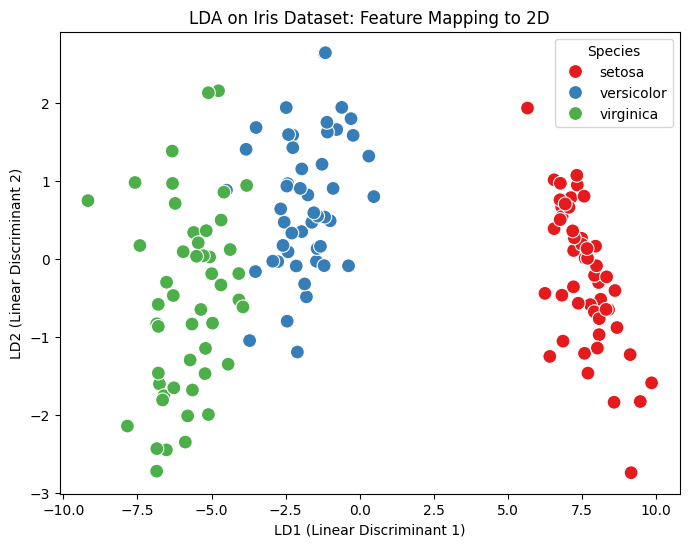

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.datasets import load_iris
import pandas as pd

# Loading Iris
data = load_iris()
X = data.data  # Feature
y = data.target  # Label
target_names = data.target_names

# Preserve Two Components by LDA
lda = LinearDiscriminantAnalysis(n_components=2)
X_lda = lda.fit_transform(X, y)
df = pd.DataFrame(X_lda, columns=["LD1", "LD2"])
df['Species'] = [target_names[label] for label in y]

# Visualization
plt.figure(figsize=(8, 6))
sns.scatterplot(x="LD1", y="LD2", hue="Species", data=df, palette='Set1', s=100)
plt.legend(title="Species", loc="best")
plt.title("LDA on Iris Dataset: Feature Mapping to 2D")
plt.xlabel("LD1 (Linear Discriminant 1)")
plt.ylabel("LD2 (Linear Discriminant 2)")
plt.show()


In [ ]:
## Feature Engineering ##
## Feature Mapping for SVM ##

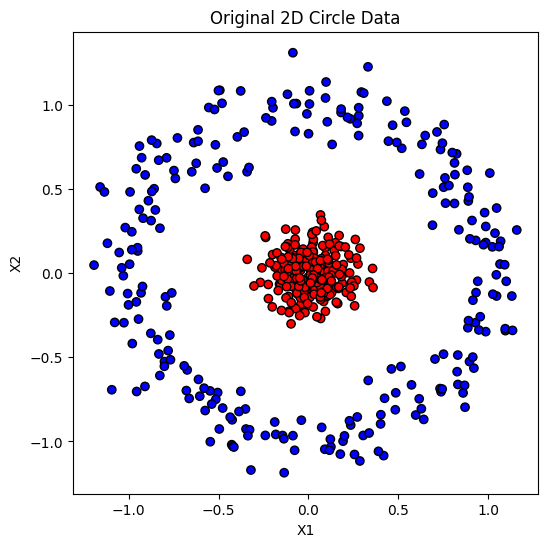

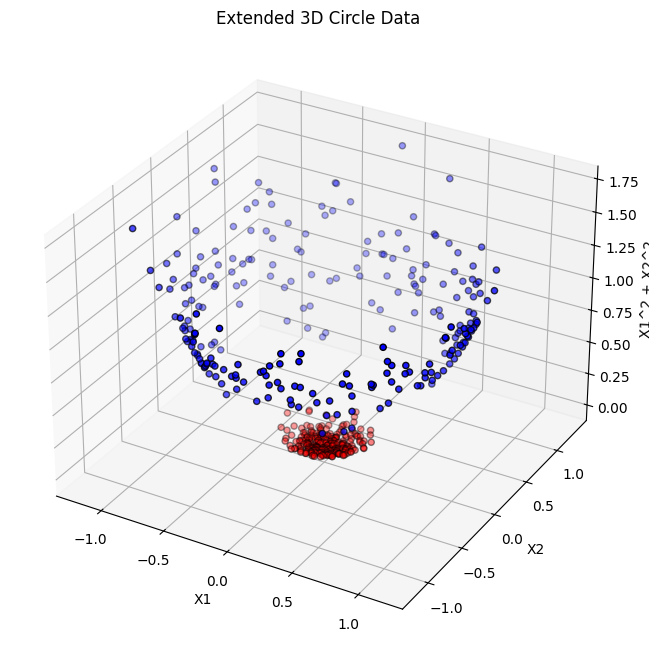

Hyperplane equation: 0.13 * X1 + 0.03 * X2 + -2.56 * X3 + -1.01 = 0


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.svm import SVC
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler

# Circular Dataset Initialization
X, y = datasets.make_circles(n_samples=500, factor=0.1, noise=0.1, random_state=42)

# Extend to Three Dimensional Space
X_extended = np.hstack([X, (X[:, 0]**2 + X[:, 1]**2).reshape(-1, 1)])

# Visualization Two Dimensional Space
plt.figure(figsize=(6, 6))
colors = np.where(y == 0, 'blue', 'red')  # Red Inlier and Blue Outliers
plt.scatter(X[:, 0], X[:, 1], c=colors, edgecolor='k')
plt.title('Original 2D Circle Data')
plt.xlabel('X1')
plt.ylabel('X2')
plt.show()

scaler = StandardScaler()
X_extended_scaled = scaler.fit_transform(X_extended)

# Visualization Three Dimensional Space
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(X_extended[:, 0], X_extended[:, 1], X_extended[:, 2], c=colors, edgecolor='k')
ax.set_title('Extended 3D Circle Data')
ax.set_xlabel('X1')
ax.set_ylabel('X2')
ax.set_zlabel('X1^2 + X2^2')
plt.show()

# Classification Demonstration in Three Dimensional Space
svm_model = SVC(kernel='linear')
svm_model.fit(X_extended_scaled, y)

# SVM Parameter Setting
w = svm_model.coef_[0]  # SVM weight coefficient
b = svm_model.intercept_[0]  # SVM intercept coefficient

# Hyperplane Function：w1 * x1 + w2 * x2 + w3 * x3 + b = 0
hyperplane_equation = f'{w[0]:.2f} * X1 + {w[1]:.2f} * X2 + {w[2]:.2f} * X3 + {b:.2f} = 0'
print("Hyperplane equation:", hyperplane_equation)


In [ ]:
## Feature Engineering ##
## Feature Clustering ##

2D Clustering - Correctly clustered points: 172
2D Clustering - Clustering accuracy: 96.63%
3D Clustering - Correctly clustered points: 172
3D Clustering - Clustering accuracy: 96.63%


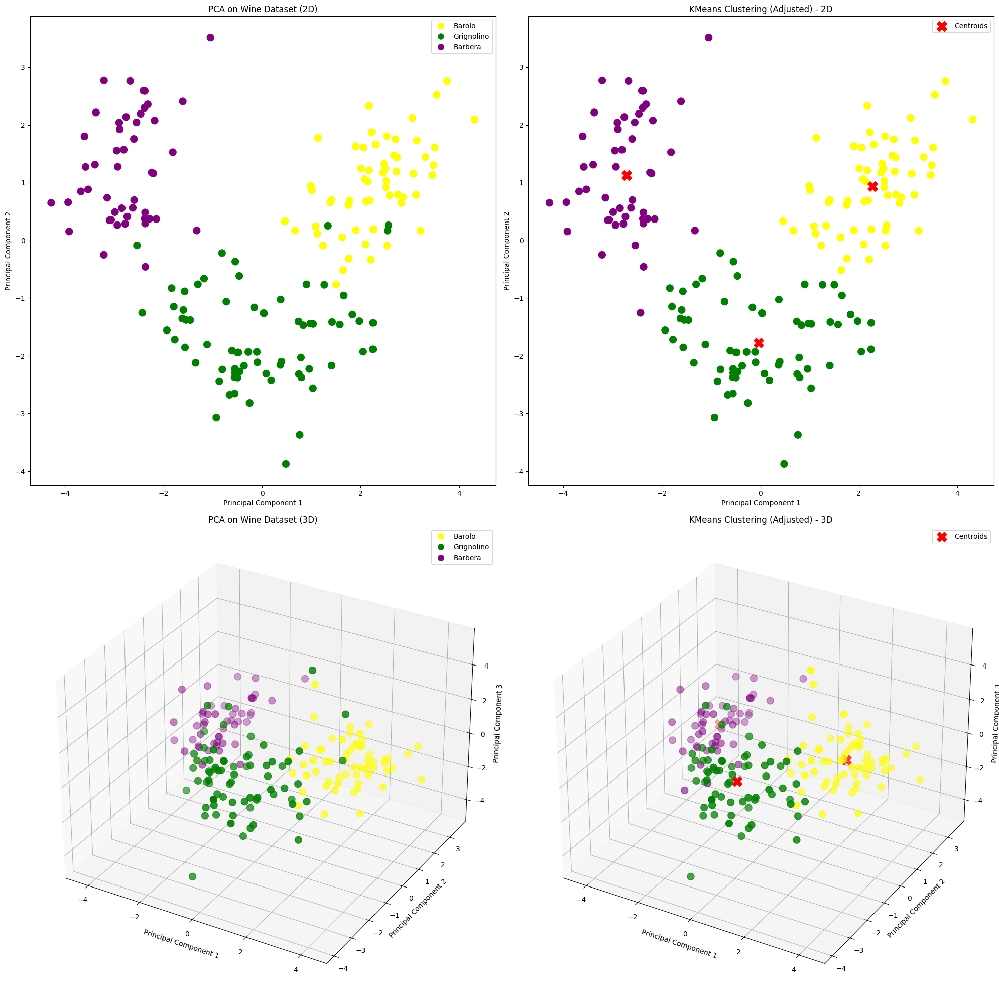

In [ ]:
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
import numpy as np

# Load the Wine dataset
data = datasets.load_wine()
X = data.data  # Features
y = data.target  # True labels
target_names = data.target_names  # Class names
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform PCA for 2D and 3D
pca_2d = PCA(n_components=2)
X_pca_2d = pca_2d.fit_transform(X_scaled)

pca_3d = PCA(n_components=3)
X_pca_3d = pca_3d.fit_transform(X_scaled)

# Apply KMeans clustering
kmeans = KMeans(n_clusters=3, random_state=42)
kmeans_labels_2d = kmeans.fit_predict(X_pca_2d)
kmeans_labels_3d = kmeans.fit_predict(X_pca_3d)

# Adjust KMeans labels to match true classes
adjusted_labels_2d = np.zeros_like(kmeans_labels_2d)
adjusted_labels_3d = np.zeros_like(kmeans_labels_3d)
for i in range(3):  # Iterate over clusters
    mask_2d = (kmeans_labels_2d == i)
    mask_3d = (kmeans_labels_3d == i)
    target_class_2d = np.bincount(y[mask_2d]).argmax()
    target_class_3d = np.bincount(y[mask_3d]).argmax()
    adjusted_labels_2d[mask_2d] = target_class_2d
    adjusted_labels_3d[mask_3d] = target_class_3d

# Calculate the number and percentage of correctly clustered points
correct_count_2d = np.sum(adjusted_labels_2d == y)
correct_count_3d = np.sum(adjusted_labels_3d == y)
total_count = len(y)
accuracy_2d = correct_count_2d / total_count
accuracy_3d = correct_count_3d / total_count

print(f"2D Clustering - Correctly clustered points: {correct_count_2d}")
print(f"2D Clustering - Clustering accuracy: {accuracy_2d:.2%}")
print(f"3D Clustering - Correctly clustered points: {correct_count_3d}")
print(f"3D Clustering - Clustering accuracy: {accuracy_3d:.2%}")

# Define color mapping for true labels
color_map = {0: 'yellow', 1: 'green', 2: 'purple'}
colors_true = [color_map[label] for label in y]
colors_kmeans_2d = [color_map[label] for label in adjusted_labels_2d]
colors_kmeans_3d = [color_map[label] for label in adjusted_labels_3d]

# Visualization
fig = plt.figure(figsize=(20, 20))

# 2D PCA visualization (true labels)
ax1 = fig.add_subplot(221)
scatter1 = ax1.scatter(X_pca_2d[:, 0], X_pca_2d[:, 1], c=colors_true, s=100)
ax1.set_xlabel('Principal Component 1')
ax1.set_ylabel('Principal Component 2')
ax1.set_title('PCA on Wine Dataset (2D)')
ax1.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='yellow', markersize=10, label='Barolo'),
                    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='Grignolino'),
                    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='purple', markersize=10, label='Barbera')],
           loc='best')

# 2D KMeans clustering visualization
ax2 = fig.add_subplot(222)
scatter2 = ax2.scatter(X_pca_2d[:, 0], X_pca_2d[:, 1], c=colors_kmeans_2d, s=100)
ax2.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', marker='X', s=200, label='Centroids')
ax2.set_xlabel('Principal Component 1')
ax2.set_ylabel('Principal Component 2')
ax2.set_title('KMeans Clustering (Adjusted) - 2D')
ax2.legend()

# 3D PCA visualization (true labels)
ax3 = fig.add_subplot(223, projection='3d')
scatter3 = ax3.scatter(X_pca_3d[:, 0], X_pca_3d[:, 1], X_pca_3d[:, 2], c=colors_true, s=100)
ax3.set_xlabel('Principal Component 1')
ax3.set_ylabel('Principal Component 2')
ax3.set_zlabel('Principal Component 3')
ax3.set_title('PCA on Wine Dataset (3D)')
ax3.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='yellow', markersize=10, label='Barolo'),
                    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='green', markersize=10, label='Grignolino'),
                    plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='purple', markersize=10, label='Barbera')],
           loc='best')

# 3D KMeans clustering visualization
ax4 = fig.add_subplot(224, projection='3d')
scatter4 = ax4.scatter(X_pca_3d[:, 0], X_pca_3d[:, 1], X_pca_3d[:, 2], c=colors_kmeans_3d, s=100)
ax4.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], kmeans.cluster_centers_[:, 2], c='red', marker='X', s=200, label='Centroids')
ax4.set_xlabel('Principal Component 1')
ax4.set_ylabel('Principal Component 2')
ax4.set_zlabel('Principal Component 3')
ax4.set_title('KMeans Clustering (Adjusted) - 3D')
ax4.legend()

plt.tight_layout()
plt.show()


In [ ]:
## Data Augmentation ##
## Image Data Augmentation ##

Using device: cuda


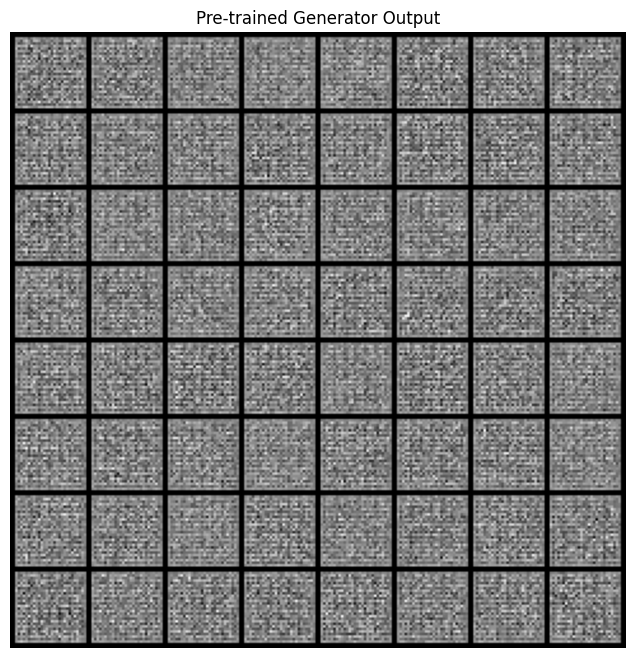

Starting Training Loop...
[0/100][0/235] Loss_D: 1.6524 Loss_G: 1.5460 D(x): 0.4600 D(G(z)): 0.5060/0.2520
[0/100][50/235] Loss_D: 2.7387 Loss_G: 2.9140 D(x): 0.9890 D(G(z)): 0.9094/0.0742
[0/100][100/235] Loss_D: 0.8387 Loss_G: 2.3327 D(x): 0.9183 D(G(z)): 0.5127/0.1077
[0/100][150/235] Loss_D: 0.3676 Loss_G: 1.9020 D(x): 0.8276 D(G(z)): 0.1553/0.1648
[0/100][200/235] Loss_D: 0.3155 Loss_G: 2.2846 D(x): 0.8675 D(G(z)): 0.1542/0.1122


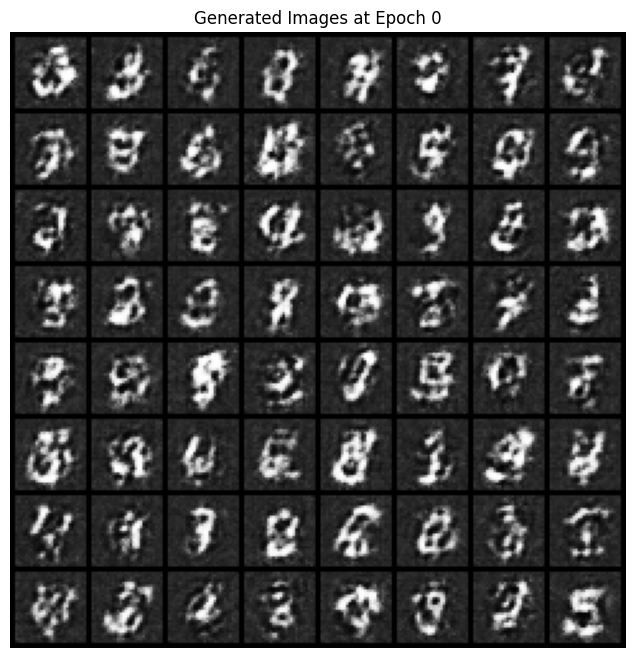

[1/100][0/235] Loss_D: 0.2917 Loss_G: 2.1307 D(x): 0.8666 D(G(z)): 0.1317/0.1317
[1/100][50/235] Loss_D: 0.2868 Loss_G: 2.5656 D(x): 0.9061 D(G(z)): 0.1675/0.0859
[1/100][100/235] Loss_D: 0.8058 Loss_G: 1.4580 D(x): 0.6576 D(G(z)): 0.2977/0.2525
[1/100][150/235] Loss_D: 0.4501 Loss_G: 1.4894 D(x): 0.7341 D(G(z)): 0.1165/0.2472
[1/100][200/235] Loss_D: 0.5515 Loss_G: 1.9262 D(x): 0.7558 D(G(z)): 0.2168/0.1637


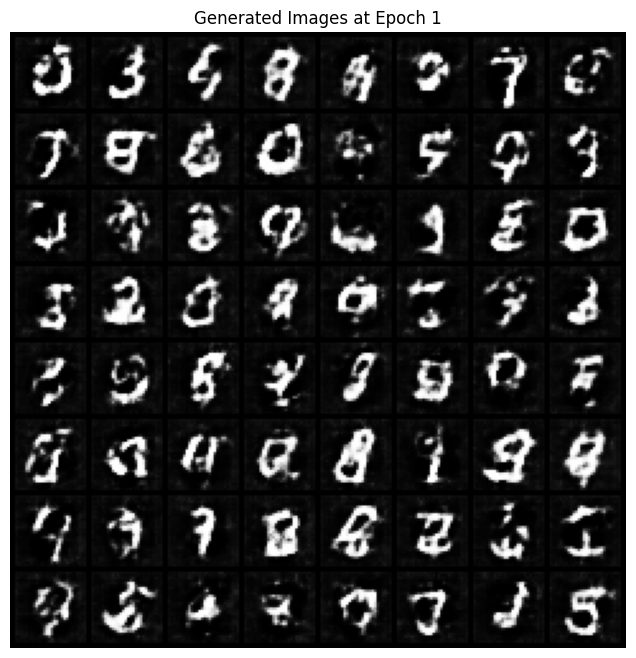

[2/100][0/235] Loss_D: 0.4123 Loss_G: 1.4569 D(x): 0.7342 D(G(z)): 0.0785/0.2581
[2/100][50/235] Loss_D: 0.7564 Loss_G: 1.0828 D(x): 0.5953 D(G(z)): 0.1686/0.3611
[2/100][100/235] Loss_D: 0.5608 Loss_G: 1.1781 D(x): 0.6691 D(G(z)): 0.1192/0.3319
[2/100][150/235] Loss_D: 0.6629 Loss_G: 3.1828 D(x): 0.9330 D(G(z)): 0.4311/0.0473
[2/100][200/235] Loss_D: 0.8523 Loss_G: 0.8050 D(x): 0.5744 D(G(z)): 0.2196/0.4631


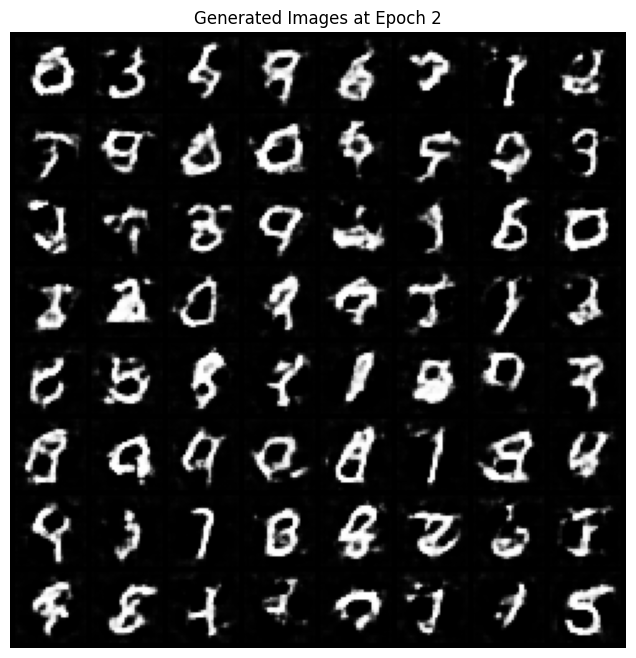

[3/100][0/235] Loss_D: 0.7806 Loss_G: 0.6070 D(x): 0.5466 D(G(z)): 0.1114/0.5657
[3/100][50/235] Loss_D: 0.9218 Loss_G: 0.7380 D(x): 0.4799 D(G(z)): 0.1179/0.4977
[3/100][100/235] Loss_D: 0.9029 Loss_G: 0.5633 D(x): 0.5050 D(G(z)): 0.1455/0.5888
[3/100][150/235] Loss_D: 1.4537 Loss_G: 2.3447 D(x): 0.9340 D(G(z)): 0.7181/0.1111
[3/100][200/235] Loss_D: 0.8774 Loss_G: 1.2254 D(x): 0.6176 D(G(z)): 0.2917/0.3257


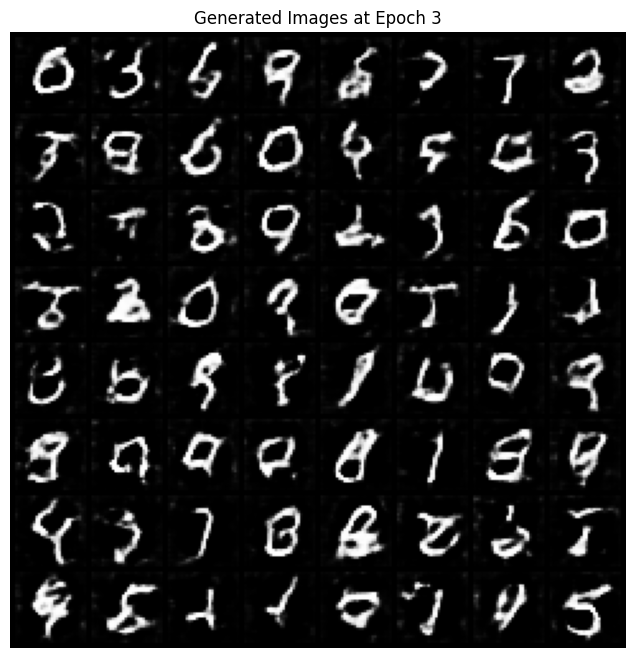

[4/100][0/235] Loss_D: 0.7954 Loss_G: 1.5557 D(x): 0.6976 D(G(z)): 0.3234/0.2356
[4/100][50/235] Loss_D: 0.8533 Loss_G: 1.9454 D(x): 0.8381 D(G(z)): 0.4661/0.1664
[4/100][100/235] Loss_D: 0.6884 Loss_G: 1.6172 D(x): 0.7571 D(G(z)): 0.3107/0.2201
[4/100][150/235] Loss_D: 0.9208 Loss_G: 0.8126 D(x): 0.5627 D(G(z)): 0.2578/0.4636
[4/100][200/235] Loss_D: 1.0954 Loss_G: 2.5623 D(x): 0.8839 D(G(z)): 0.5954/0.0883


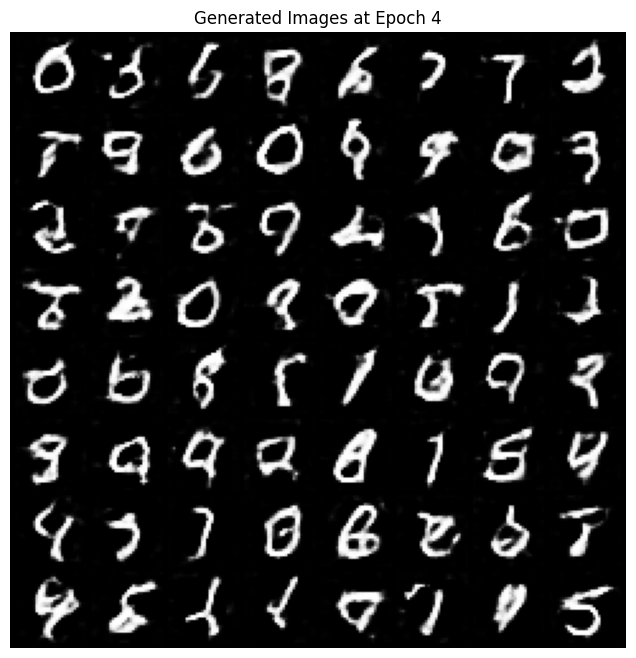

[5/100][0/235] Loss_D: 0.9606 Loss_G: 0.6738 D(x): 0.4926 D(G(z)): 0.1747/0.5272
[5/100][50/235] Loss_D: 1.0200 Loss_G: 0.5741 D(x): 0.4411 D(G(z)): 0.1205/0.5830
[5/100][100/235] Loss_D: 0.8925 Loss_G: 0.9540 D(x): 0.5692 D(G(z)): 0.2429/0.4120
[5/100][150/235] Loss_D: 0.7004 Loss_G: 1.1602 D(x): 0.6544 D(G(z)): 0.2163/0.3399
[5/100][200/235] Loss_D: 0.9086 Loss_G: 1.4489 D(x): 0.7317 D(G(z)): 0.4263/0.2541


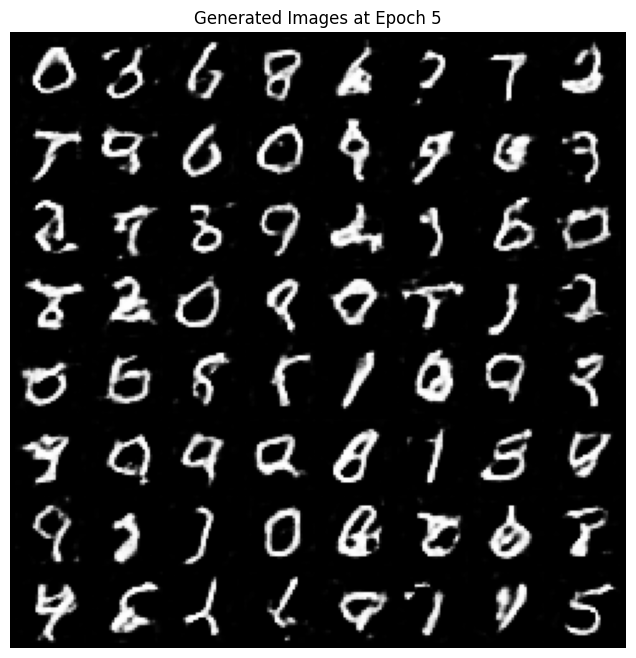

[6/100][0/235] Loss_D: 0.8182 Loss_G: 1.2247 D(x): 0.6627 D(G(z)): 0.2983/0.3161
[6/100][50/235] Loss_D: 0.8560 Loss_G: 1.0050 D(x): 0.6281 D(G(z)): 0.2908/0.3935
[6/100][100/235] Loss_D: 1.0690 Loss_G: 1.0915 D(x): 0.4722 D(G(z)): 0.1926/0.3727
[6/100][150/235] Loss_D: 0.7630 Loss_G: 1.7403 D(x): 0.7320 D(G(z)): 0.3309/0.1975
[6/100][200/235] Loss_D: 0.7141 Loss_G: 2.0142 D(x): 0.7851 D(G(z)): 0.3484/0.1615


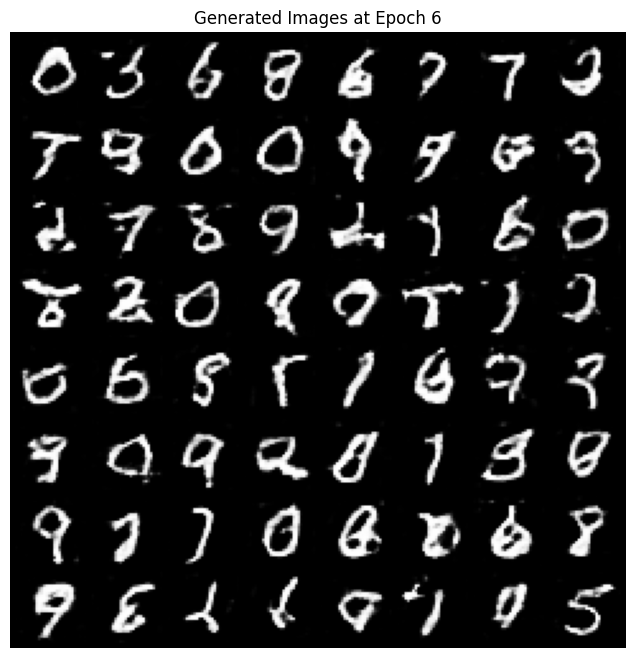

[7/100][0/235] Loss_D: 1.1917 Loss_G: 1.2104 D(x): 0.6462 D(G(z)): 0.4979/0.3213
[7/100][50/235] Loss_D: 1.0288 Loss_G: 0.8729 D(x): 0.5290 D(G(z)): 0.2823/0.4447
[7/100][100/235] Loss_D: 0.8937 Loss_G: 1.1732 D(x): 0.6123 D(G(z)): 0.2948/0.3399
[7/100][150/235] Loss_D: 0.9533 Loss_G: 1.8877 D(x): 0.8221 D(G(z)): 0.5054/0.1696
[7/100][200/235] Loss_D: 0.8111 Loss_G: 1.2828 D(x): 0.6806 D(G(z)): 0.3203/0.2990


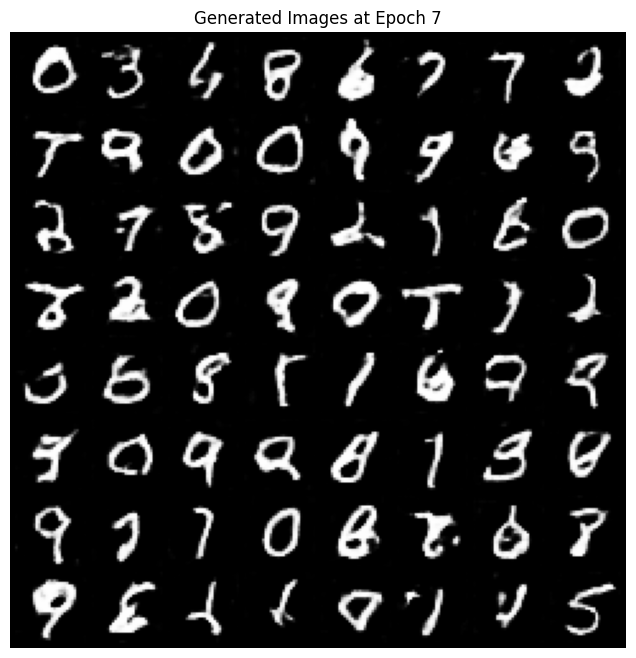

[8/100][0/235] Loss_D: 1.3440 Loss_G: 0.7770 D(x): 0.3317 D(G(z)): 0.0999/0.4887
[8/100][50/235] Loss_D: 0.8374 Loss_G: 1.2736 D(x): 0.6509 D(G(z)): 0.2998/0.3032
[8/100][100/235] Loss_D: 0.8708 Loss_G: 1.1840 D(x): 0.6569 D(G(z)): 0.3257/0.3301
[8/100][150/235] Loss_D: 0.8773 Loss_G: 1.2523 D(x): 0.5813 D(G(z)): 0.2417/0.3131
[8/100][200/235] Loss_D: 1.0363 Loss_G: 1.6190 D(x): 0.7609 D(G(z)): 0.5007/0.2189


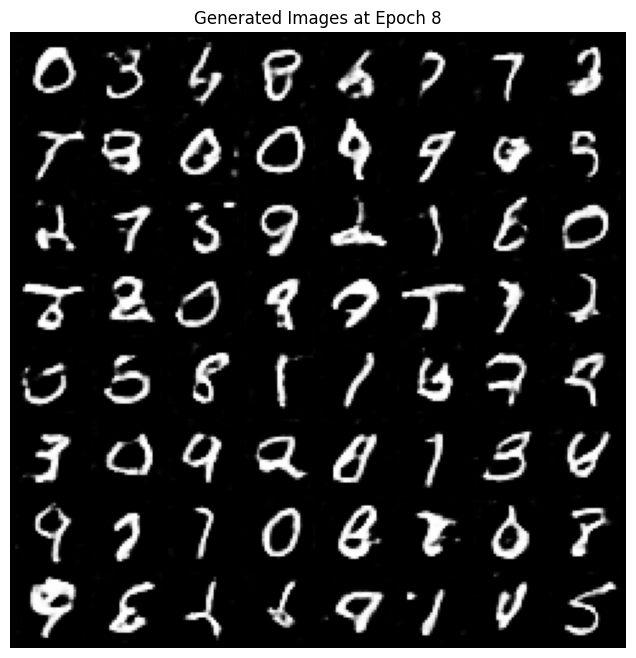

[9/100][0/235] Loss_D: 1.1003 Loss_G: 2.7254 D(x): 0.8795 D(G(z)): 0.5867/0.0798
[9/100][50/235] Loss_D: 1.1770 Loss_G: 0.6949 D(x): 0.4007 D(G(z)): 0.1402/0.5242
[9/100][100/235] Loss_D: 0.8017 Loss_G: 1.2818 D(x): 0.7050 D(G(z)): 0.3341/0.3030
[9/100][150/235] Loss_D: 1.0251 Loss_G: 0.7445 D(x): 0.5152 D(G(z)): 0.2441/0.4989
[9/100][200/235] Loss_D: 0.8485 Loss_G: 2.1407 D(x): 0.8246 D(G(z)): 0.4486/0.1393


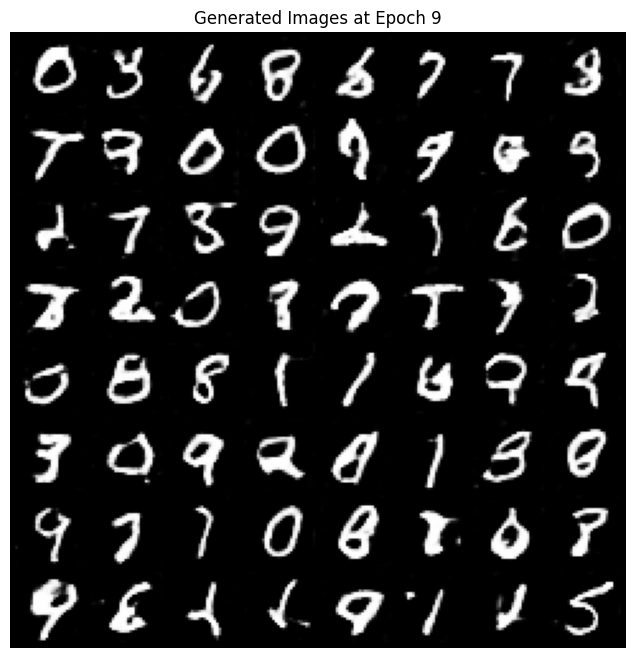

[10/100][0/235] Loss_D: 0.8498 Loss_G: 0.3421 D(x): 0.5745 D(G(z)): 0.1838/0.7286
[10/100][50/235] Loss_D: 1.5883 Loss_G: 2.7989 D(x): 0.9173 D(G(z)): 0.7339/0.0817
[10/100][100/235] Loss_D: 0.9343 Loss_G: 2.2102 D(x): 0.8328 D(G(z)): 0.4974/0.1328
[10/100][150/235] Loss_D: 1.1159 Loss_G: 1.1460 D(x): 0.6003 D(G(z)): 0.4077/0.3407
[10/100][200/235] Loss_D: 0.8901 Loss_G: 0.7433 D(x): 0.5244 D(G(z)): 0.1626/0.4987


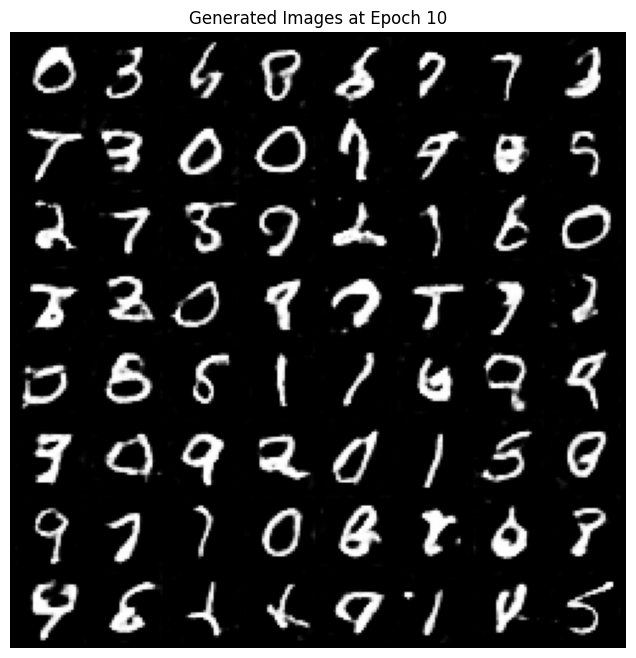

[11/100][0/235] Loss_D: 1.5739 Loss_G: 3.8348 D(x): 0.9221 D(G(z)): 0.7095/0.0458
[11/100][50/235] Loss_D: 0.6516 Loss_G: 1.2268 D(x): 0.6905 D(G(z)): 0.2123/0.3257
[11/100][100/235] Loss_D: 0.8052 Loss_G: 0.9260 D(x): 0.6237 D(G(z)): 0.2363/0.4300
[11/100][150/235] Loss_D: 1.5244 Loss_G: 1.0683 D(x): 0.7304 D(G(z)): 0.6468/0.3771
[11/100][200/235] Loss_D: 1.1451 Loss_G: 0.7383 D(x): 0.4626 D(G(z)): 0.2514/0.5097


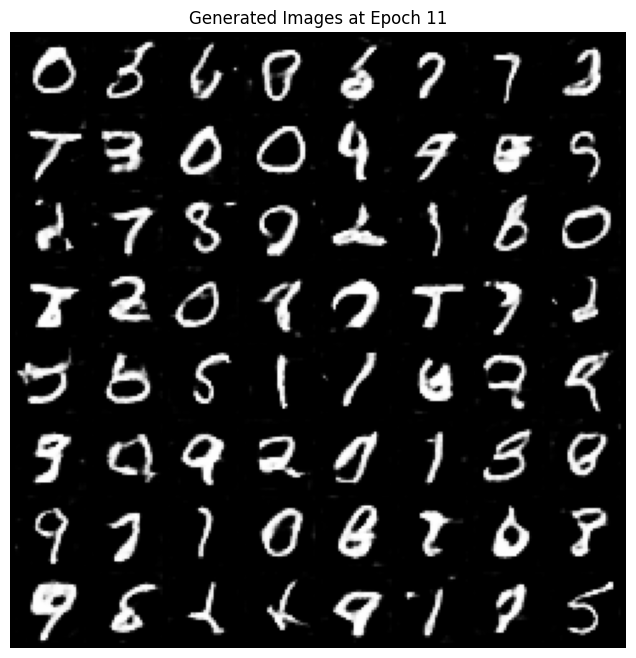

[12/100][0/235] Loss_D: 0.9009 Loss_G: 1.4223 D(x): 0.7235 D(G(z)): 0.3998/0.2692
[12/100][50/235] Loss_D: 0.8710 Loss_G: 1.1518 D(x): 0.5840 D(G(z)): 0.2152/0.3469
[12/100][100/235] Loss_D: 0.8455 Loss_G: 1.4462 D(x): 0.6616 D(G(z)): 0.3114/0.2630
[12/100][150/235] Loss_D: 0.8508 Loss_G: 1.2712 D(x): 0.6405 D(G(z)): 0.2901/0.3097
[12/100][200/235] Loss_D: 0.7615 Loss_G: 2.6335 D(x): 0.8066 D(G(z)): 0.3861/0.0925


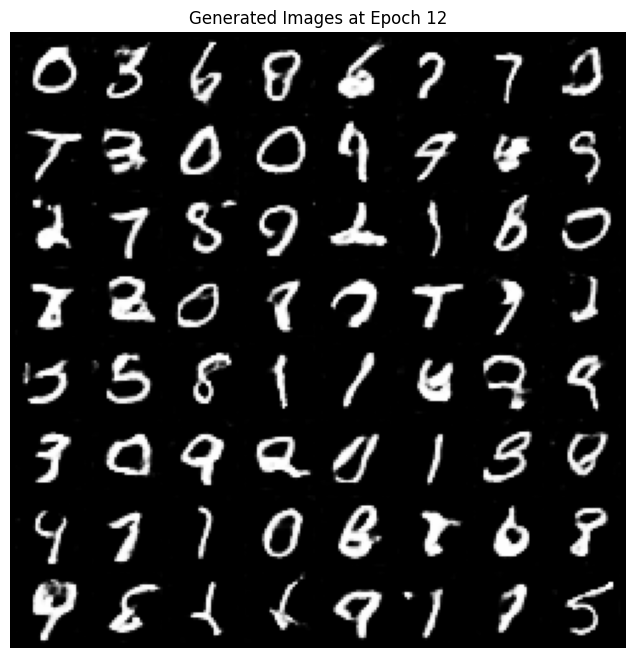

[13/100][0/235] Loss_D: 0.7792 Loss_G: 1.6587 D(x): 0.6739 D(G(z)): 0.2650/0.2314
[13/100][50/235] Loss_D: 1.0848 Loss_G: 0.4251 D(x): 0.4475 D(G(z)): 0.1292/0.6828
[13/100][100/235] Loss_D: 1.1890 Loss_G: 1.2449 D(x): 0.6163 D(G(z)): 0.4500/0.3220
[13/100][150/235] Loss_D: 0.8781 Loss_G: 0.9680 D(x): 0.5816 D(G(z)): 0.2302/0.4205
[13/100][200/235] Loss_D: 0.6987 Loss_G: 1.4198 D(x): 0.7261 D(G(z)): 0.2785/0.2759


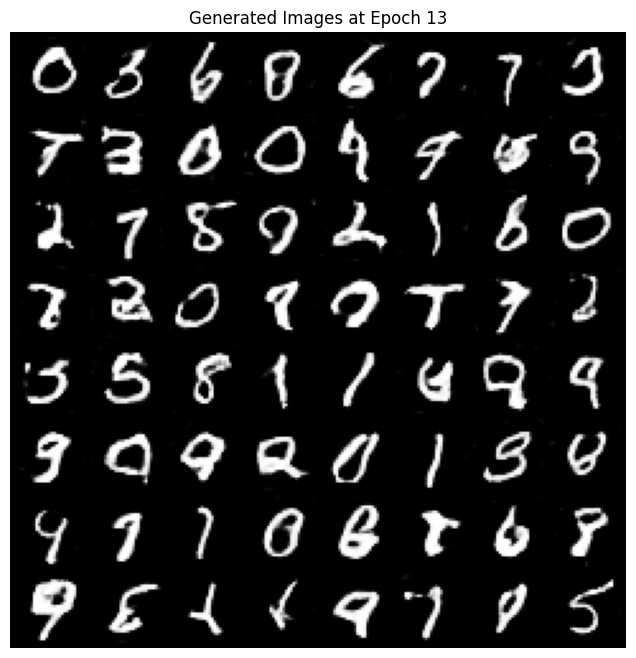

[14/100][0/235] Loss_D: 0.9317 Loss_G: 1.3617 D(x): 0.6450 D(G(z)): 0.3375/0.2922
[14/100][50/235] Loss_D: 1.2620 Loss_G: 0.7656 D(x): 0.3783 D(G(z)): 0.1027/0.5214
[14/100][100/235] Loss_D: 0.9445 Loss_G: 1.3571 D(x): 0.7717 D(G(z)): 0.4608/0.2844
[14/100][150/235] Loss_D: 1.4991 Loss_G: 2.7398 D(x): 0.9118 D(G(z)): 0.7061/0.0996
[14/100][200/235] Loss_D: 0.9750 Loss_G: 2.0560 D(x): 0.8682 D(G(z)): 0.5244/0.1545


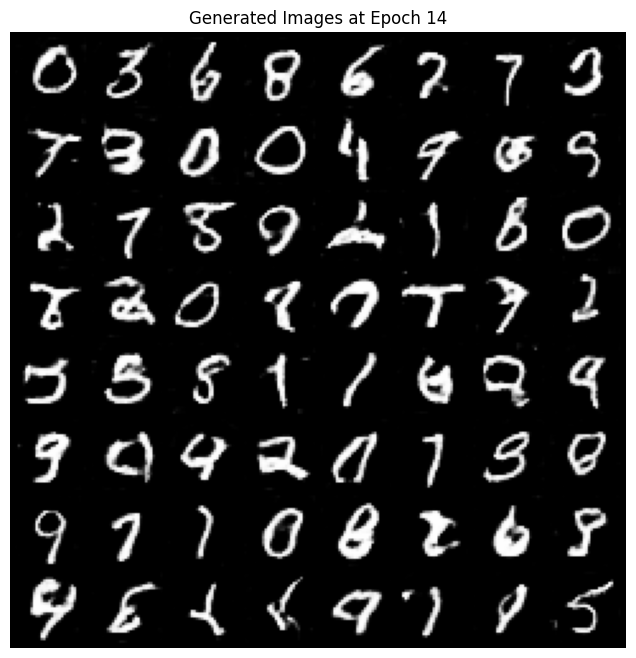

[15/100][0/235] Loss_D: 0.8140 Loss_G: 1.9310 D(x): 0.7582 D(G(z)): 0.3713/0.1764
[15/100][50/235] Loss_D: 1.1644 Loss_G: 2.2054 D(x): 0.8979 D(G(z)): 0.6049/0.1381
[15/100][100/235] Loss_D: 1.0492 Loss_G: 2.3869 D(x): 0.8651 D(G(z)): 0.5535/0.1166
[15/100][150/235] Loss_D: 0.7661 Loss_G: 1.5042 D(x): 0.7090 D(G(z)): 0.3018/0.2584
[15/100][200/235] Loss_D: 0.7080 Loss_G: 2.2677 D(x): 0.7735 D(G(z)): 0.3245/0.1331


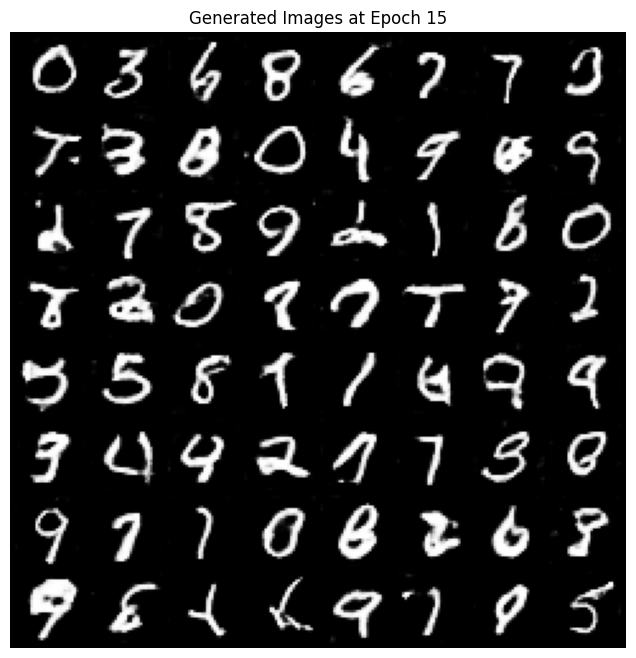

[16/100][0/235] Loss_D: 0.8876 Loss_G: 1.1938 D(x): 0.6197 D(G(z)): 0.2899/0.3415
[16/100][50/235] Loss_D: 1.6381 Loss_G: 0.6710 D(x): 0.2772 D(G(z)): 0.0802/0.5567
[16/100][100/235] Loss_D: 0.8401 Loss_G: 1.4859 D(x): 0.6240 D(G(z)): 0.2510/0.2626
[16/100][150/235] Loss_D: 0.9662 Loss_G: 1.2192 D(x): 0.6133 D(G(z)): 0.3209/0.3360
[16/100][200/235] Loss_D: 0.8439 Loss_G: 1.4017 D(x): 0.6804 D(G(z)): 0.3211/0.2830


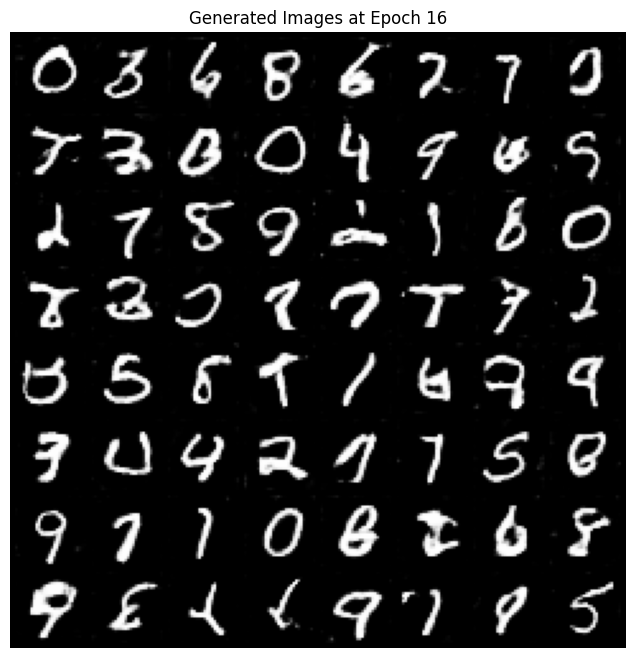

[17/100][0/235] Loss_D: 0.7301 Loss_G: 1.0986 D(x): 0.6217 D(G(z)): 0.1754/0.3843
[17/100][50/235] Loss_D: 1.0250 Loss_G: 0.4084 D(x): 0.4484 D(G(z)): 0.0853/0.6946
[17/100][100/235] Loss_D: 1.4194 Loss_G: 0.8264 D(x): 0.3409 D(G(z)): 0.0973/0.4851
[17/100][150/235] Loss_D: 0.7878 Loss_G: 2.1980 D(x): 0.8456 D(G(z)): 0.4266/0.1398
[17/100][200/235] Loss_D: 0.7088 Loss_G: 1.2378 D(x): 0.6525 D(G(z)): 0.1998/0.3359


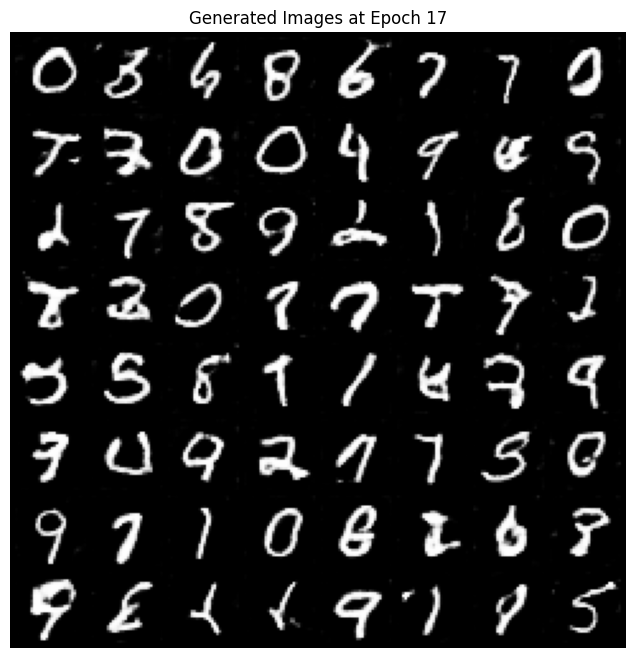

[18/100][0/235] Loss_D: 0.6708 Loss_G: 1.7117 D(x): 0.7377 D(G(z)): 0.2676/0.2243
[18/100][50/235] Loss_D: 0.8066 Loss_G: 1.1001 D(x): 0.5457 D(G(z)): 0.1228/0.3806
[18/100][100/235] Loss_D: 1.3257 Loss_G: 1.4309 D(x): 0.3846 D(G(z)): 0.1170/0.2967
[18/100][150/235] Loss_D: 0.8349 Loss_G: 2.0316 D(x): 0.7318 D(G(z)): 0.3673/0.1614
[18/100][200/235] Loss_D: 0.7456 Loss_G: 2.3160 D(x): 0.8115 D(G(z)): 0.3758/0.1286


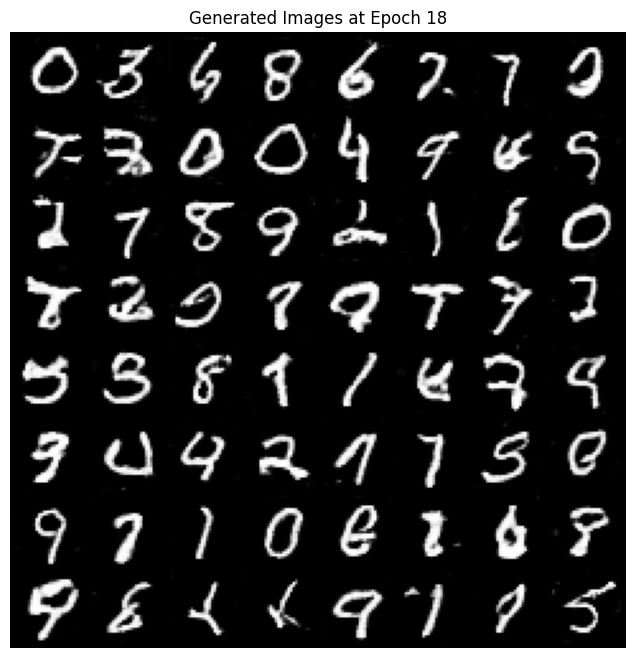

[19/100][0/235] Loss_D: 1.2503 Loss_G: 1.8658 D(x): 0.7954 D(G(z)): 0.5939/0.1863
[19/100][50/235] Loss_D: 0.8666 Loss_G: 1.5881 D(x): 0.6829 D(G(z)): 0.3389/0.2373
[19/100][100/235] Loss_D: 0.7813 Loss_G: 1.1329 D(x): 0.6906 D(G(z)): 0.2912/0.3574
[19/100][150/235] Loss_D: 0.9380 Loss_G: 0.9413 D(x): 0.4973 D(G(z)): 0.1207/0.4381
[19/100][200/235] Loss_D: 0.9455 Loss_G: 0.7196 D(x): 0.4797 D(G(z)): 0.0989/0.5241


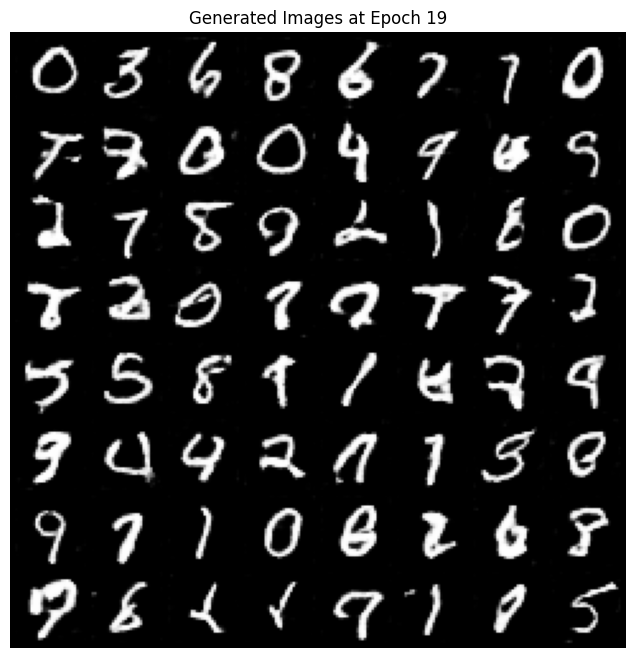

[20/100][0/235] Loss_D: 0.7973 Loss_G: 1.9877 D(x): 0.8110 D(G(z)): 0.4032/0.1700
[20/100][50/235] Loss_D: 0.8450 Loss_G: 1.6940 D(x): 0.7756 D(G(z)): 0.3934/0.2250
[20/100][100/235] Loss_D: 1.1051 Loss_G: 2.8631 D(x): 0.9175 D(G(z)): 0.5857/0.0799
[20/100][150/235] Loss_D: 1.0023 Loss_G: 2.1677 D(x): 0.8823 D(G(z)): 0.5302/0.1517
[20/100][200/235] Loss_D: 0.8410 Loss_G: 1.5387 D(x): 0.7530 D(G(z)): 0.3718/0.2603


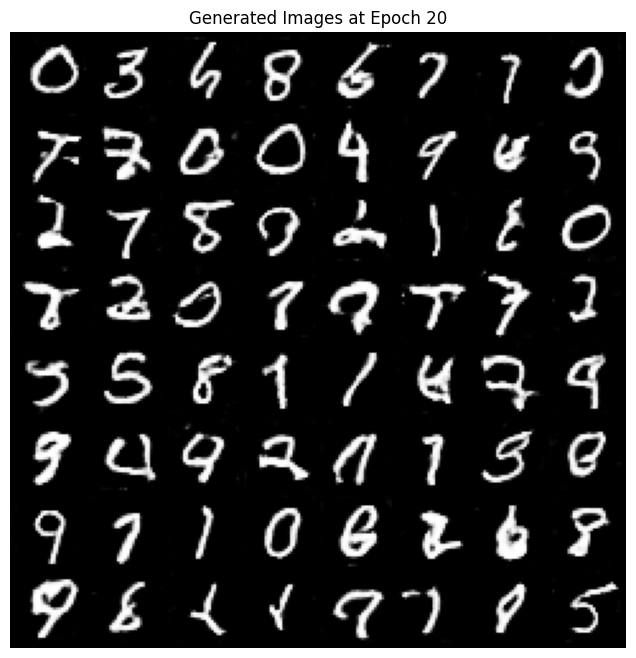

[21/100][0/235] Loss_D: 0.8673 Loss_G: 1.0794 D(x): 0.5611 D(G(z)): 0.1798/0.3827
[21/100][50/235] Loss_D: 0.8612 Loss_G: 1.4833 D(x): 0.6909 D(G(z)): 0.3353/0.2702
[21/100][100/235] Loss_D: 0.9666 Loss_G: 1.5113 D(x): 0.7082 D(G(z)): 0.4089/0.2558
[21/100][150/235] Loss_D: 1.1039 Loss_G: 0.5810 D(x): 0.4095 D(G(z)): 0.0763/0.6060
[21/100][200/235] Loss_D: 0.8615 Loss_G: 1.8003 D(x): 0.7977 D(G(z)): 0.4244/0.2001


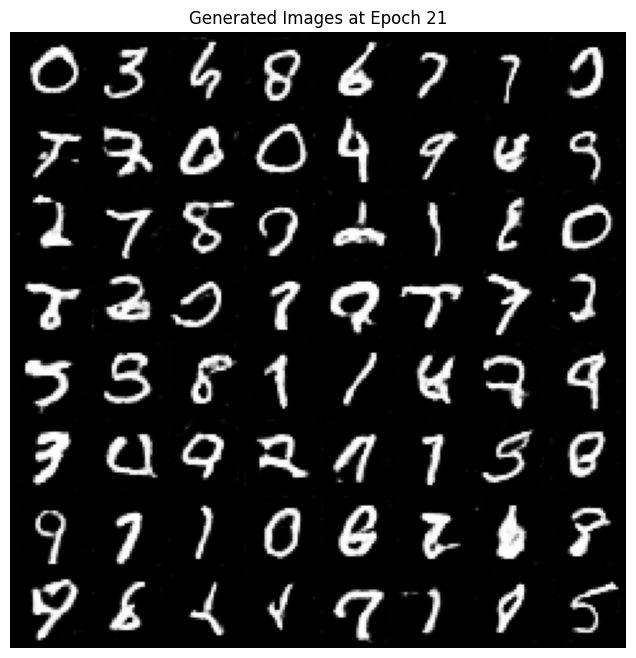

[22/100][0/235] Loss_D: 0.7665 Loss_G: 0.7630 D(x): 0.5812 D(G(z)): 0.1284/0.5102
[22/100][50/235] Loss_D: 0.6077 Loss_G: 2.0515 D(x): 0.7699 D(G(z)): 0.2529/0.1684
[22/100][100/235] Loss_D: 1.1702 Loss_G: 2.2641 D(x): 0.8629 D(G(z)): 0.5920/0.1350
[22/100][150/235] Loss_D: 0.7583 Loss_G: 1.7629 D(x): 0.7154 D(G(z)): 0.3048/0.2045
[22/100][200/235] Loss_D: 0.6399 Loss_G: 1.4334 D(x): 0.7254 D(G(z)): 0.2348/0.2819


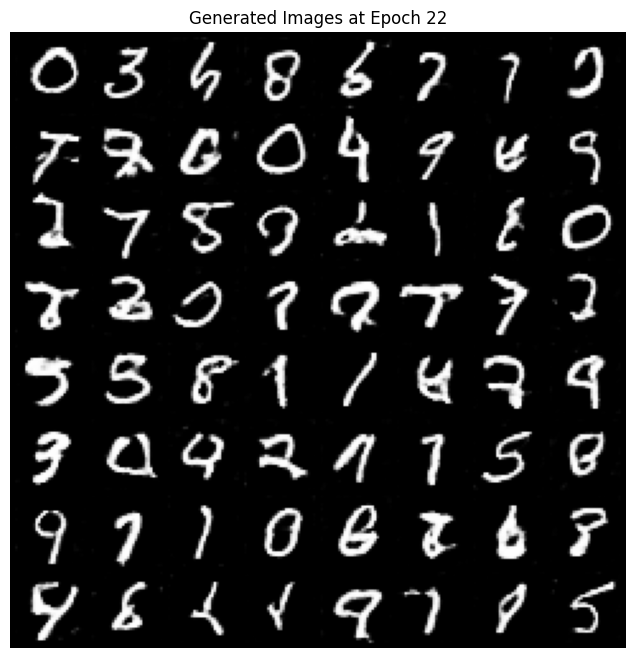

[23/100][0/235] Loss_D: 1.2016 Loss_G: 0.9546 D(x): 0.3956 D(G(z)): 0.0929/0.4472
[23/100][50/235] Loss_D: 0.8137 Loss_G: 1.4667 D(x): 0.6256 D(G(z)): 0.2310/0.2835
[23/100][100/235] Loss_D: 0.9494 Loss_G: 0.6821 D(x): 0.5065 D(G(z)): 0.1373/0.5443
[23/100][150/235] Loss_D: 0.6880 Loss_G: 1.3760 D(x): 0.6985 D(G(z)): 0.2307/0.3019
[23/100][200/235] Loss_D: 1.2291 Loss_G: 3.4813 D(x): 0.9348 D(G(z)): 0.6320/0.0454


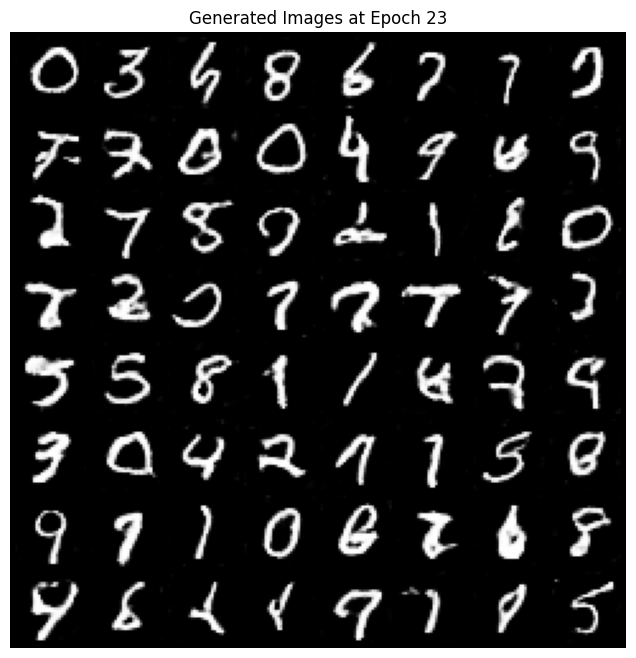

[24/100][0/235] Loss_D: 0.7200 Loss_G: 1.2370 D(x): 0.6754 D(G(z)): 0.2284/0.3352
[24/100][50/235] Loss_D: 0.8056 Loss_G: 2.7106 D(x): 0.8069 D(G(z)): 0.4055/0.0908
[24/100][100/235] Loss_D: 0.7152 Loss_G: 1.1703 D(x): 0.6447 D(G(z)): 0.1864/0.3584
[24/100][150/235] Loss_D: 1.0111 Loss_G: 1.0370 D(x): 0.5231 D(G(z)): 0.1995/0.4030
[24/100][200/235] Loss_D: 0.7277 Loss_G: 1.8021 D(x): 0.7595 D(G(z)): 0.3155/0.2167


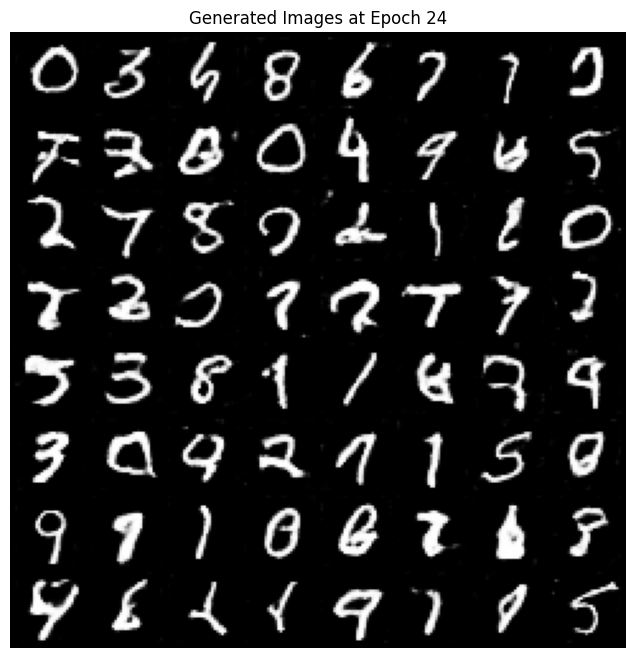

[25/100][0/235] Loss_D: 0.7668 Loss_G: 2.4931 D(x): 0.8059 D(G(z)): 0.3747/0.1098
[25/100][50/235] Loss_D: 0.8105 Loss_G: 1.1980 D(x): 0.5651 D(G(z)): 0.1289/0.3508
[25/100][100/235] Loss_D: 1.1329 Loss_G: 0.5713 D(x): 0.4091 D(G(z)): 0.0521/0.6087
[25/100][150/235] Loss_D: 0.9276 Loss_G: 2.6781 D(x): 0.9103 D(G(z)): 0.5242/0.0906
[25/100][200/235] Loss_D: 0.7957 Loss_G: 1.1512 D(x): 0.6330 D(G(z)): 0.2247/0.3624


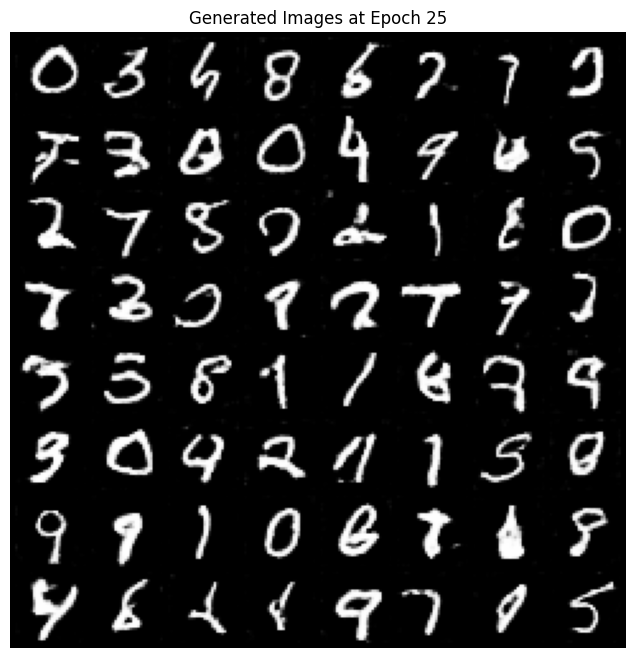

[26/100][0/235] Loss_D: 0.6494 Loss_G: 2.3868 D(x): 0.7980 D(G(z)): 0.2982/0.1236
[26/100][50/235] Loss_D: 2.2879 Loss_G: 3.8473 D(x): 0.9837 D(G(z)): 0.8582/0.0342
[26/100][100/235] Loss_D: 1.0635 Loss_G: 0.8250 D(x): 0.4389 D(G(z)): 0.0900/0.4839
[26/100][150/235] Loss_D: 0.7385 Loss_G: 1.8796 D(x): 0.7858 D(G(z)): 0.3504/0.1834
[26/100][200/235] Loss_D: 0.8776 Loss_G: 2.1094 D(x): 0.8120 D(G(z)): 0.4213/0.1616


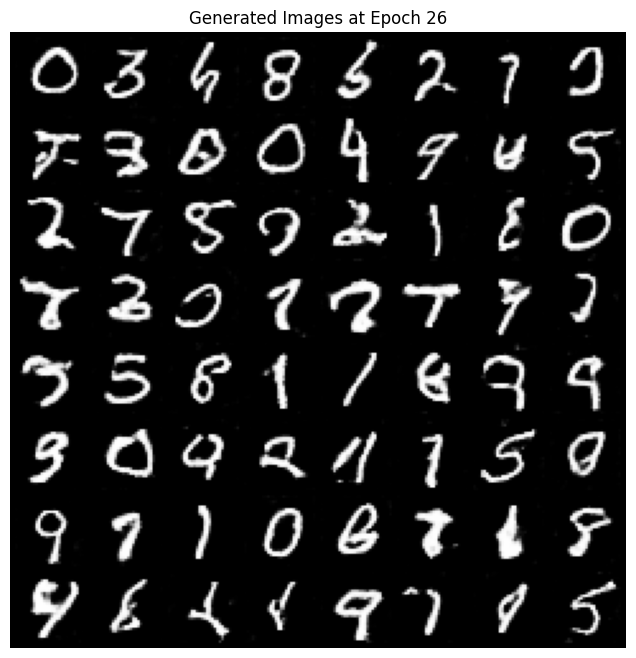

[27/100][0/235] Loss_D: 1.0347 Loss_G: 1.0135 D(x): 0.5025 D(G(z)): 0.1741/0.4086
[27/100][50/235] Loss_D: 0.9391 Loss_G: 2.9096 D(x): 0.8365 D(G(z)): 0.4833/0.0729
[27/100][100/235] Loss_D: 0.7219 Loss_G: 1.8472 D(x): 0.7893 D(G(z)): 0.3344/0.2000
[27/100][150/235] Loss_D: 0.6236 Loss_G: 1.8426 D(x): 0.7395 D(G(z)): 0.2351/0.1957
[27/100][200/235] Loss_D: 1.4930 Loss_G: 2.7038 D(x): 0.8980 D(G(z)): 0.6606/0.1078


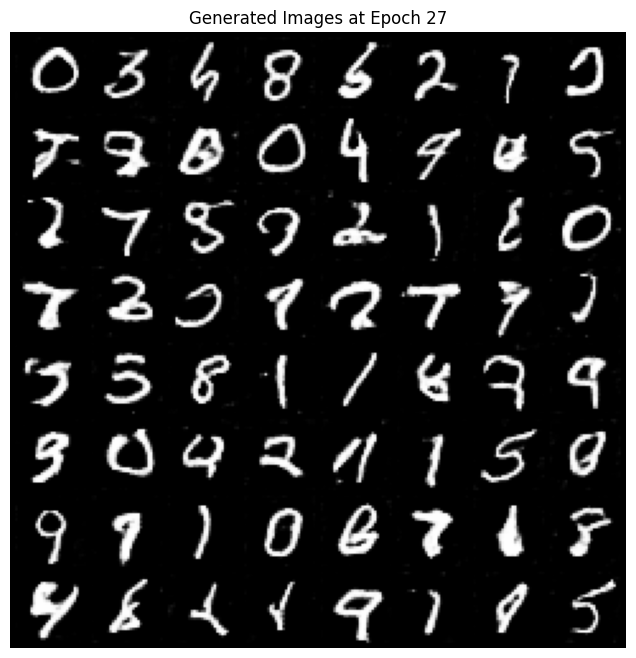

[28/100][0/235] Loss_D: 0.6313 Loss_G: 1.4846 D(x): 0.7227 D(G(z)): 0.2175/0.2807
[28/100][50/235] Loss_D: 1.0399 Loss_G: 2.3824 D(x): 0.8426 D(G(z)): 0.5162/0.1280
[28/100][100/235] Loss_D: 1.0667 Loss_G: 0.5829 D(x): 0.4424 D(G(z)): 0.0853/0.6042
[28/100][150/235] Loss_D: 0.7544 Loss_G: 1.6891 D(x): 0.7273 D(G(z)): 0.3032/0.2270
[28/100][200/235] Loss_D: 0.6231 Loss_G: 1.4202 D(x): 0.7309 D(G(z)): 0.2203/0.2994


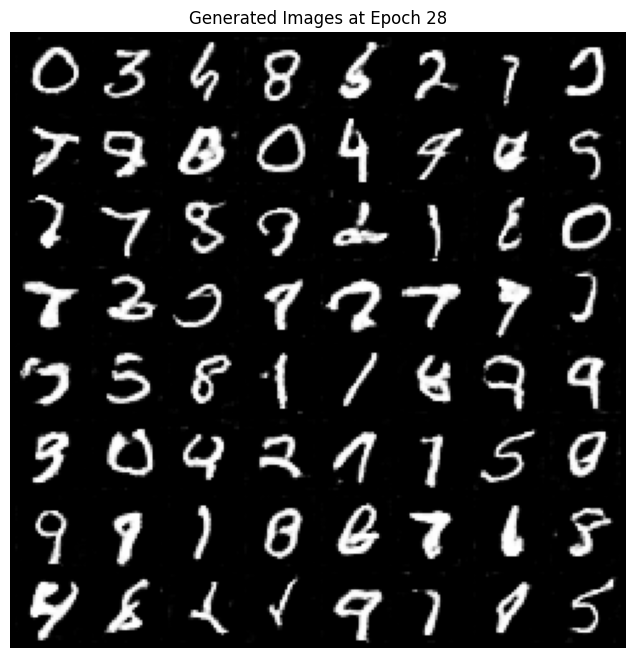

[29/100][0/235] Loss_D: 0.9815 Loss_G: 0.9845 D(x): 0.4748 D(G(z)): 0.0887/0.4264
[29/100][50/235] Loss_D: 0.7061 Loss_G: 3.0665 D(x): 0.8752 D(G(z)): 0.3903/0.0661
[29/100][100/235] Loss_D: 1.0284 Loss_G: 0.4381 D(x): 0.4528 D(G(z)): 0.0674/0.6785
[29/100][150/235] Loss_D: 1.0782 Loss_G: 3.7384 D(x): 0.9382 D(G(z)): 0.5805/0.0351
[29/100][200/235] Loss_D: 0.7970 Loss_G: 2.3265 D(x): 0.8230 D(G(z)): 0.4042/0.1268


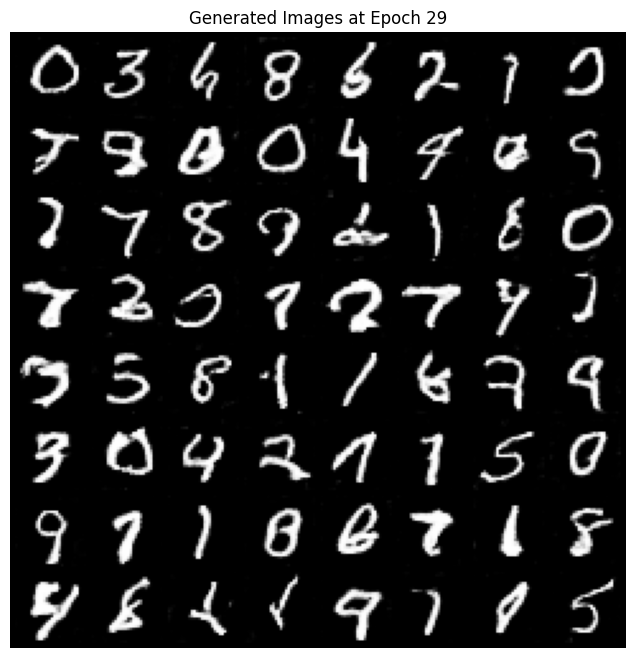

[30/100][0/235] Loss_D: 1.1161 Loss_G: 0.7930 D(x): 0.4771 D(G(z)): 0.2035/0.5022
[30/100][50/235] Loss_D: 0.7616 Loss_G: 0.8959 D(x): 0.6111 D(G(z)): 0.1737/0.4567
[30/100][100/235] Loss_D: 0.7650 Loss_G: 2.0181 D(x): 0.8138 D(G(z)): 0.3818/0.1675
[30/100][150/235] Loss_D: 0.8946 Loss_G: 0.3471 D(x): 0.4884 D(G(z)): 0.0560/0.7326
[30/100][200/235] Loss_D: 0.7066 Loss_G: 2.2490 D(x): 0.8067 D(G(z)): 0.3396/0.1405


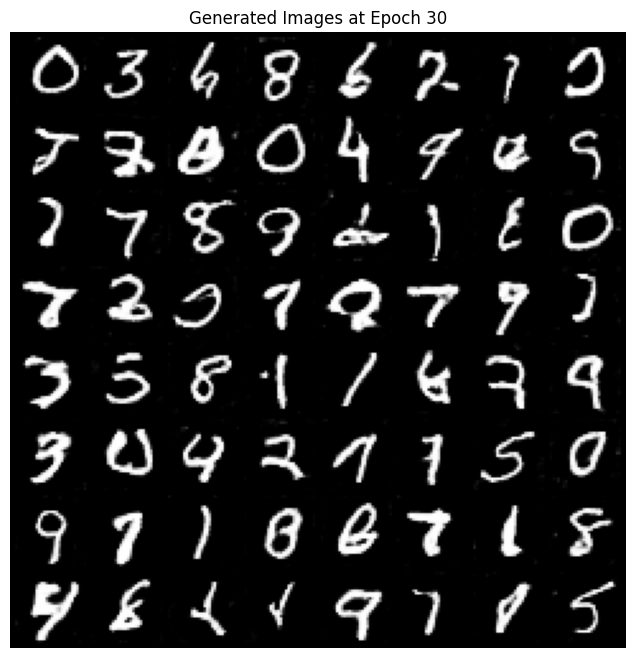

[31/100][0/235] Loss_D: 0.9782 Loss_G: 3.8336 D(x): 0.9462 D(G(z)): 0.5472/0.0339
[31/100][50/235] Loss_D: 0.7491 Loss_G: 0.7703 D(x): 0.5887 D(G(z)): 0.1146/0.5250
[31/100][100/235] Loss_D: 0.5538 Loss_G: 2.2227 D(x): 0.7816 D(G(z)): 0.2309/0.1414
[31/100][150/235] Loss_D: 0.6890 Loss_G: 1.8656 D(x): 0.7559 D(G(z)): 0.2896/0.1967
[31/100][200/235] Loss_D: 0.7400 Loss_G: 1.2808 D(x): 0.6912 D(G(z)): 0.2495/0.3338


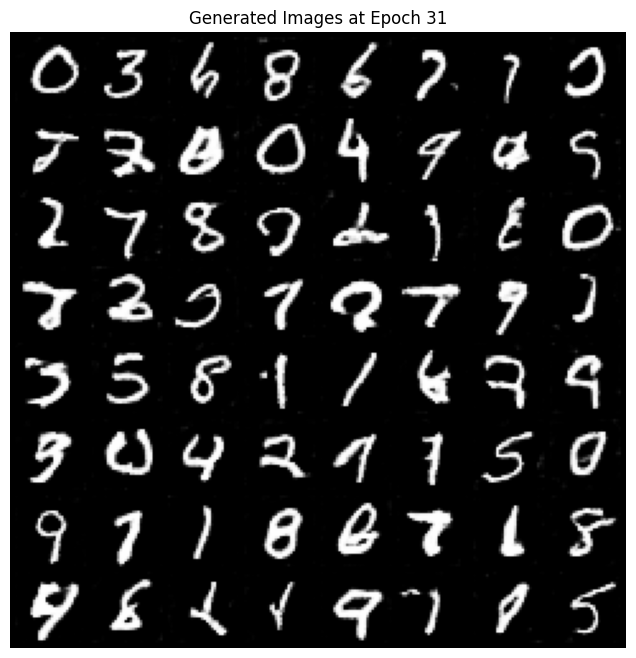

[32/100][0/235] Loss_D: 1.3172 Loss_G: 0.8855 D(x): 0.3782 D(G(z)): 0.0925/0.4725
[32/100][50/235] Loss_D: 0.8863 Loss_G: 0.5681 D(x): 0.5359 D(G(z)): 0.1213/0.6099
[32/100][100/235] Loss_D: 0.6782 Loss_G: 2.2933 D(x): 0.8109 D(G(z)): 0.3334/0.1338
[32/100][150/235] Loss_D: 0.8973 Loss_G: 1.8041 D(x): 0.8049 D(G(z)): 0.4349/0.2098
[32/100][200/235] Loss_D: 0.6947 Loss_G: 1.4911 D(x): 0.6141 D(G(z)): 0.1280/0.2684


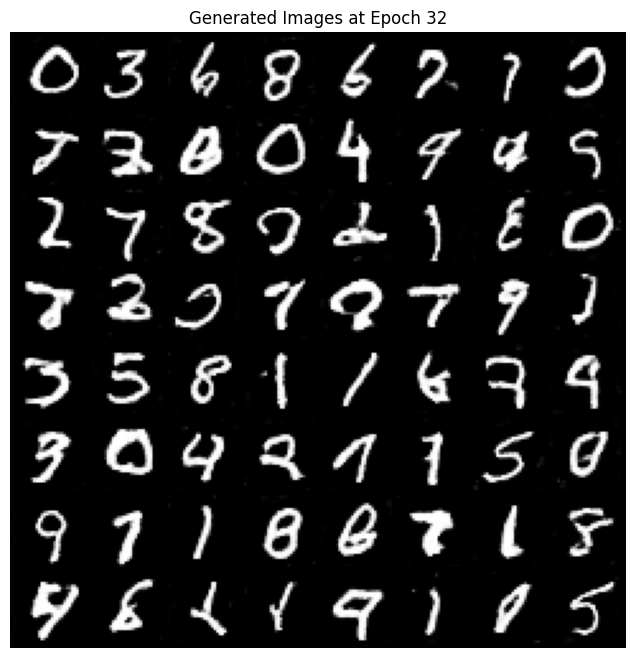

[33/100][0/235] Loss_D: 0.8848 Loss_G: 2.8984 D(x): 0.9155 D(G(z)): 0.4954/0.0787
[33/100][50/235] Loss_D: 0.7766 Loss_G: 3.0470 D(x): 0.8576 D(G(z)): 0.4173/0.0649
[33/100][100/235] Loss_D: 0.8617 Loss_G: 2.8837 D(x): 0.9004 D(G(z)): 0.4807/0.0755
[33/100][150/235] Loss_D: 1.0010 Loss_G: 1.4933 D(x): 0.4578 D(G(z)): 0.0600/0.2892
[33/100][200/235] Loss_D: 0.8051 Loss_G: 2.0653 D(x): 0.7703 D(G(z)): 0.3587/0.1699


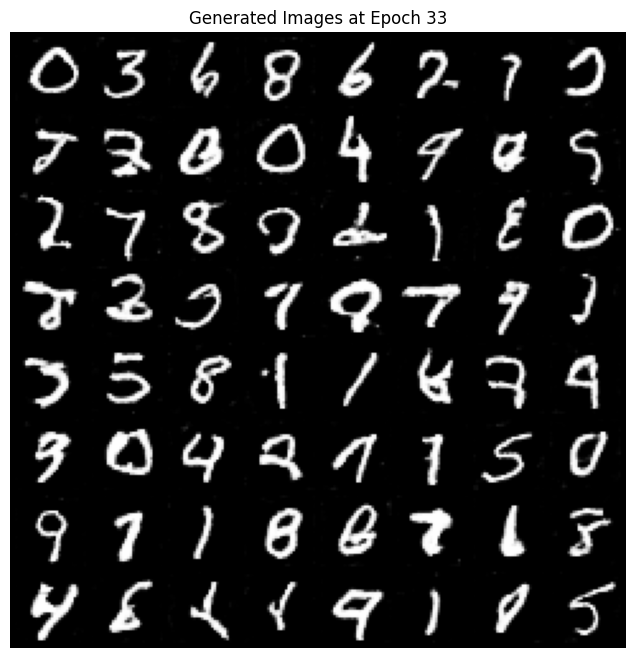

[34/100][0/235] Loss_D: 0.7394 Loss_G: 1.8621 D(x): 0.8550 D(G(z)): 0.3859/0.2072
[34/100][50/235] Loss_D: 0.5945 Loss_G: 2.0880 D(x): 0.8481 D(G(z)): 0.3084/0.1696
[34/100][100/235] Loss_D: 0.7835 Loss_G: 1.0751 D(x): 0.5602 D(G(z)): 0.0989/0.3926
[34/100][150/235] Loss_D: 0.7273 Loss_G: 1.8013 D(x): 0.7350 D(G(z)): 0.2930/0.2088
[34/100][200/235] Loss_D: 1.6541 Loss_G: 4.0675 D(x): 0.9631 D(G(z)): 0.7293/0.0311


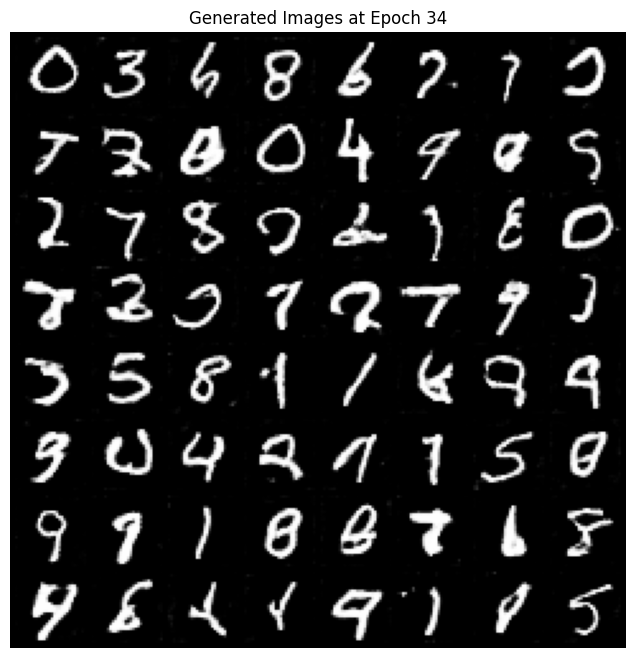

[35/100][0/235] Loss_D: 0.6824 Loss_G: 3.5895 D(x): 0.8452 D(G(z)): 0.3463/0.0452
[35/100][50/235] Loss_D: 0.6432 Loss_G: 2.2459 D(x): 0.7966 D(G(z)): 0.2960/0.1399
[35/100][100/235] Loss_D: 0.6370 Loss_G: 1.3830 D(x): 0.6993 D(G(z)): 0.1905/0.3002
[35/100][150/235] Loss_D: 0.9669 Loss_G: 0.8796 D(x): 0.4889 D(G(z)): 0.0953/0.4731
[35/100][200/235] Loss_D: 0.7589 Loss_G: 1.8644 D(x): 0.7209 D(G(z)): 0.2891/0.2022


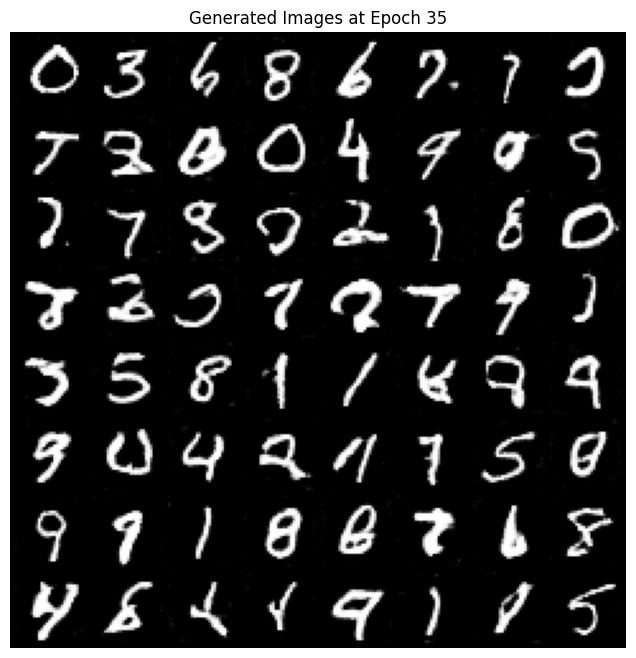

[36/100][0/235] Loss_D: 1.2940 Loss_G: 3.1742 D(x): 0.9402 D(G(z)): 0.6358/0.0707
[36/100][50/235] Loss_D: 0.7297 Loss_G: 1.5629 D(x): 0.6582 D(G(z)): 0.1960/0.2601
[36/100][100/235] Loss_D: 0.6391 Loss_G: 1.7685 D(x): 0.7412 D(G(z)): 0.2466/0.2147
[36/100][150/235] Loss_D: 0.5789 Loss_G: 2.1624 D(x): 0.7832 D(G(z)): 0.2439/0.1533
[36/100][200/235] Loss_D: 0.6486 Loss_G: 1.5357 D(x): 0.6879 D(G(z)): 0.1767/0.2673


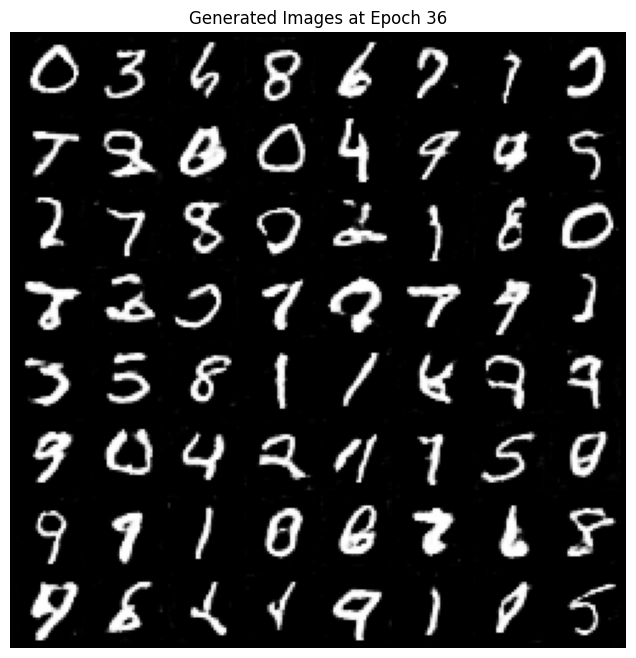

[37/100][0/235] Loss_D: 1.8757 Loss_G: 5.5372 D(x): 0.9160 D(G(z)): 0.7078/0.0143
[37/100][50/235] Loss_D: 0.6739 Loss_G: 1.6019 D(x): 0.8176 D(G(z)): 0.3305/0.2495
[37/100][100/235] Loss_D: 0.6462 Loss_G: 1.9762 D(x): 0.7638 D(G(z)): 0.2595/0.1862
[37/100][150/235] Loss_D: 0.6267 Loss_G: 1.4244 D(x): 0.7162 D(G(z)): 0.2055/0.2927
[37/100][200/235] Loss_D: 1.4493 Loss_G: 0.3269 D(x): 0.3096 D(G(z)): 0.0410/0.7508


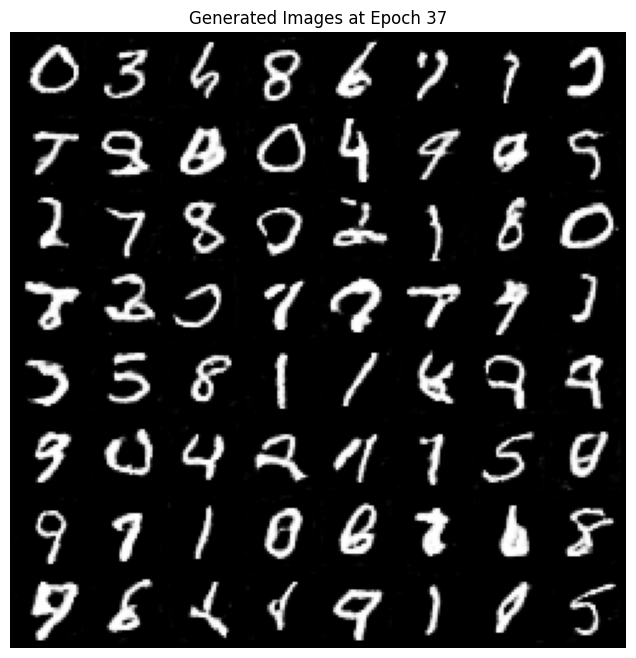

[38/100][0/235] Loss_D: 0.7527 Loss_G: 2.4473 D(x): 0.8291 D(G(z)): 0.3779/0.1160
[38/100][50/235] Loss_D: 0.5823 Loss_G: 1.8154 D(x): 0.7613 D(G(z)): 0.2139/0.2131
[38/100][100/235] Loss_D: 1.0656 Loss_G: 1.5159 D(x): 0.4697 D(G(z)): 0.1064/0.2954
[38/100][150/235] Loss_D: 0.7691 Loss_G: 2.1888 D(x): 0.8713 D(G(z)): 0.4137/0.1564
[38/100][200/235] Loss_D: 0.7246 Loss_G: 2.3789 D(x): 0.8711 D(G(z)): 0.3963/0.1242


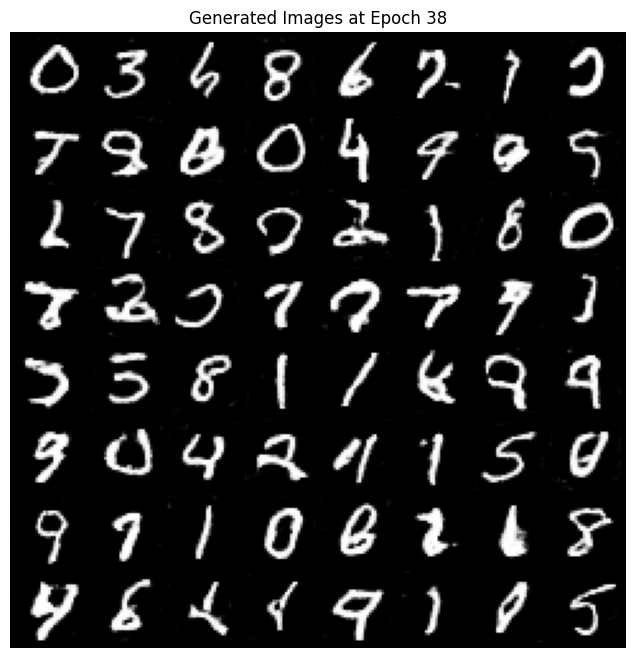

[39/100][0/235] Loss_D: 0.6280 Loss_G: 2.4075 D(x): 0.8096 D(G(z)): 0.2860/0.1298
[39/100][50/235] Loss_D: 0.6510 Loss_G: 0.6552 D(x): 0.6461 D(G(z)): 0.1033/0.5630
[39/100][100/235] Loss_D: 0.7545 Loss_G: 1.5509 D(x): 0.7143 D(G(z)): 0.2865/0.2619
[39/100][150/235] Loss_D: 0.5889 Loss_G: 2.8709 D(x): 0.9015 D(G(z)): 0.3435/0.0796
[39/100][200/235] Loss_D: 0.7579 Loss_G: 2.2434 D(x): 0.8750 D(G(z)): 0.4123/0.1460


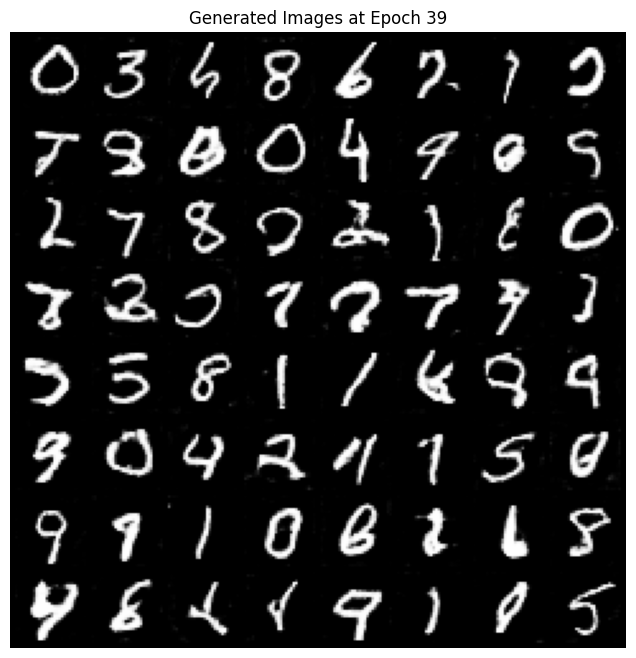

[40/100][0/235] Loss_D: 0.6753 Loss_G: 1.3260 D(x): 0.6584 D(G(z)): 0.1638/0.3272
[40/100][50/235] Loss_D: 0.6123 Loss_G: 1.6137 D(x): 0.6804 D(G(z)): 0.1472/0.2534
[40/100][100/235] Loss_D: 0.7673 Loss_G: 1.8944 D(x): 0.8261 D(G(z)): 0.3633/0.1992
[40/100][150/235] Loss_D: 1.2037 Loss_G: 0.4588 D(x): 0.3978 D(G(z)): 0.0540/0.7062
[40/100][200/235] Loss_D: 0.6305 Loss_G: 1.5131 D(x): 0.6768 D(G(z)): 0.1585/0.2852


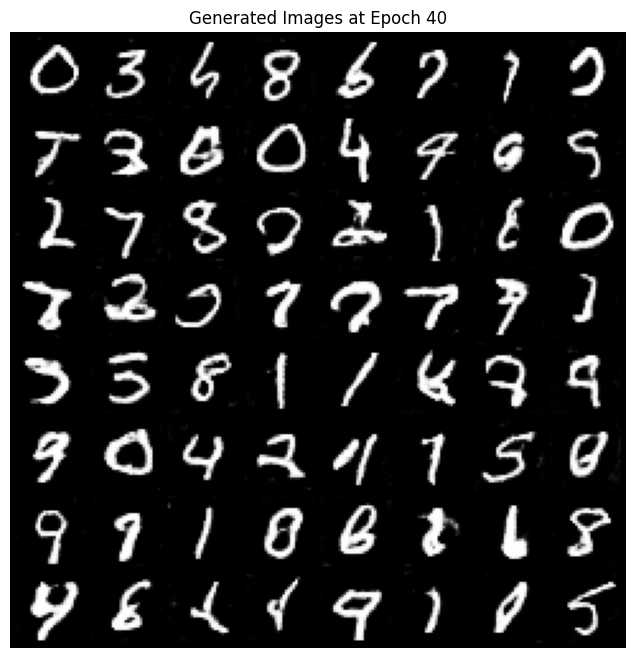

[41/100][0/235] Loss_D: 0.6229 Loss_G: 1.8295 D(x): 0.6603 D(G(z)): 0.1282/0.2108
[41/100][50/235] Loss_D: 0.5677 Loss_G: 1.3108 D(x): 0.6995 D(G(z)): 0.1391/0.3304
[41/100][100/235] Loss_D: 0.5238 Loss_G: 2.2481 D(x): 0.8056 D(G(z)): 0.2163/0.1493
[41/100][150/235] Loss_D: 0.6670 Loss_G: 2.2996 D(x): 0.8161 D(G(z)): 0.3173/0.1390
[41/100][200/235] Loss_D: 0.6533 Loss_G: 1.3608 D(x): 0.6778 D(G(z)): 0.1685/0.3174


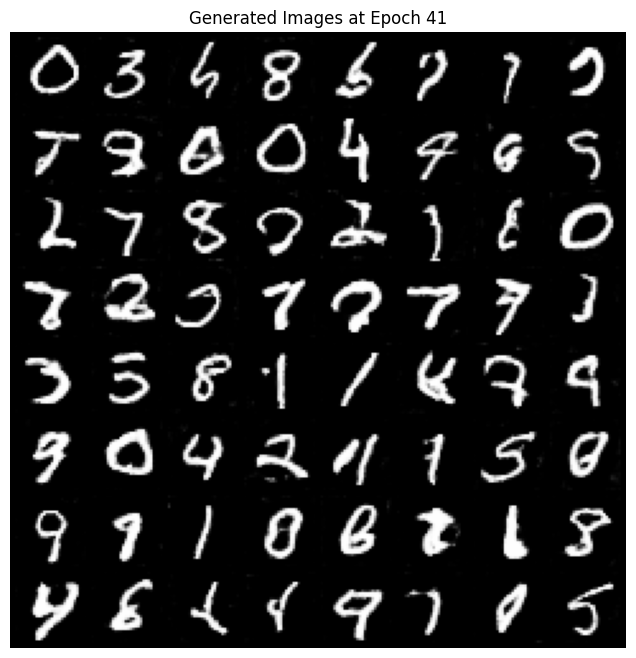

[42/100][0/235] Loss_D: 0.7037 Loss_G: 1.9287 D(x): 0.8016 D(G(z)): 0.3302/0.1879
[42/100][50/235] Loss_D: 0.7304 Loss_G: 1.8814 D(x): 0.8092 D(G(z)): 0.3555/0.1993
[42/100][100/235] Loss_D: 0.6463 Loss_G: 2.2338 D(x): 0.7123 D(G(z)): 0.1932/0.1535
[42/100][150/235] Loss_D: 0.5708 Loss_G: 2.4570 D(x): 0.8666 D(G(z)): 0.3047/0.1200
[42/100][200/235] Loss_D: 1.0060 Loss_G: 2.8400 D(x): 0.9341 D(G(z)): 0.5272/0.0962


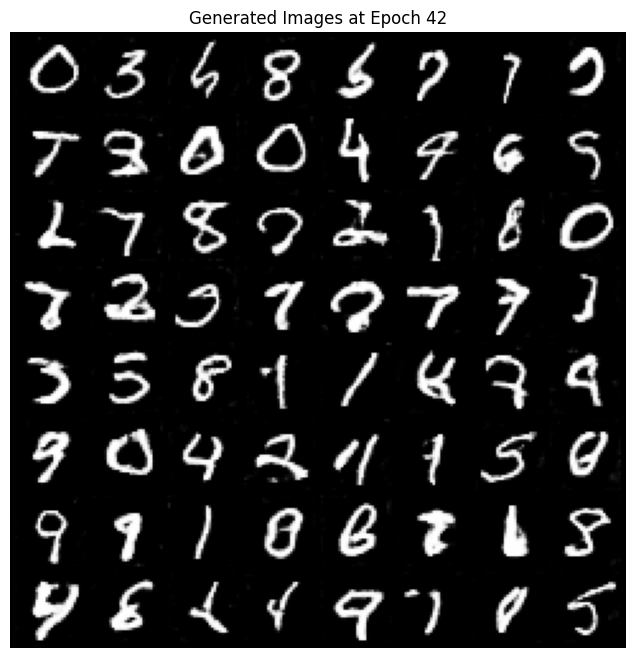

[43/100][0/235] Loss_D: 0.9080 Loss_G: 3.2519 D(x): 0.9301 D(G(z)): 0.4980/0.0644
[43/100][50/235] Loss_D: 0.8208 Loss_G: 1.4327 D(x): 0.7234 D(G(z)): 0.3266/0.2882
[43/100][100/235] Loss_D: 1.0962 Loss_G: 3.4170 D(x): 0.9360 D(G(z)): 0.5829/0.0515
[43/100][150/235] Loss_D: 0.6229 Loss_G: 2.7545 D(x): 0.8538 D(G(z)): 0.3156/0.0946
[43/100][200/235] Loss_D: 0.7282 Loss_G: 2.2122 D(x): 0.8441 D(G(z)): 0.3782/0.1471


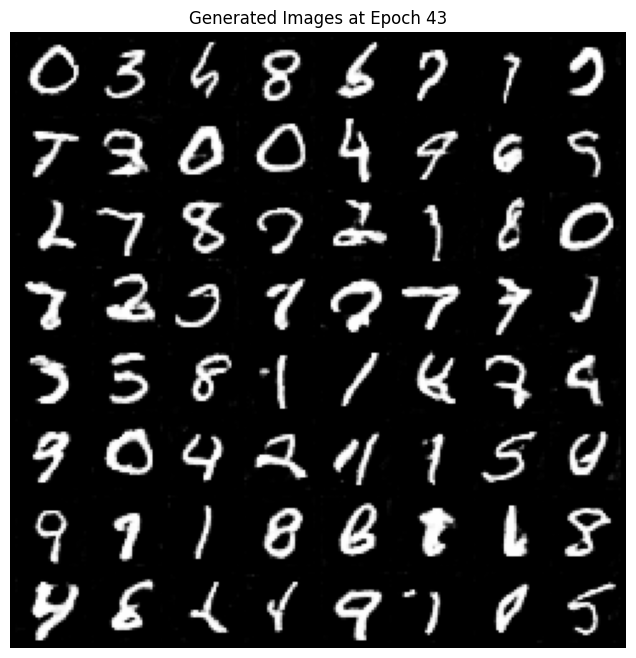

[44/100][0/235] Loss_D: 0.5505 Loss_G: 2.4077 D(x): 0.7726 D(G(z)): 0.2065/0.1312
[44/100][50/235] Loss_D: 0.6878 Loss_G: 2.3795 D(x): 0.8334 D(G(z)): 0.3500/0.1267
[44/100][100/235] Loss_D: 0.4706 Loss_G: 1.8371 D(x): 0.7571 D(G(z)): 0.1411/0.2105
[44/100][150/235] Loss_D: 0.6215 Loss_G: 0.8148 D(x): 0.6652 D(G(z)): 0.1149/0.4937
[44/100][200/235] Loss_D: 0.6624 Loss_G: 2.1433 D(x): 0.8182 D(G(z)): 0.3037/0.1621


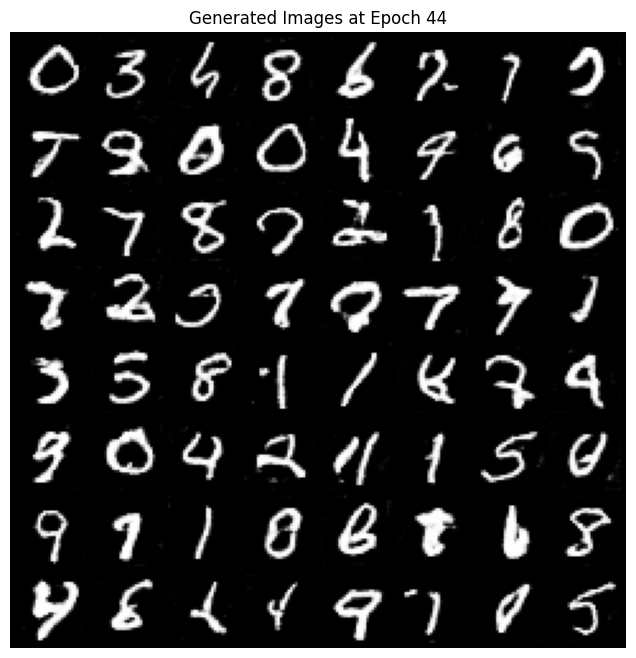

[45/100][0/235] Loss_D: 0.7140 Loss_G: 2.6871 D(x): 0.8557 D(G(z)): 0.3690/0.1073
[45/100][50/235] Loss_D: 0.9132 Loss_G: 1.2293 D(x): 0.5145 D(G(z)): 0.1170/0.3603
[45/100][100/235] Loss_D: 0.5835 Loss_G: 2.0732 D(x): 0.7617 D(G(z)): 0.2239/0.1666
[45/100][150/235] Loss_D: 0.7784 Loss_G: 1.6737 D(x): 0.6877 D(G(z)): 0.2670/0.2402
[45/100][200/235] Loss_D: 1.0387 Loss_G: 1.0496 D(x): 0.4499 D(G(z)): 0.0630/0.4301


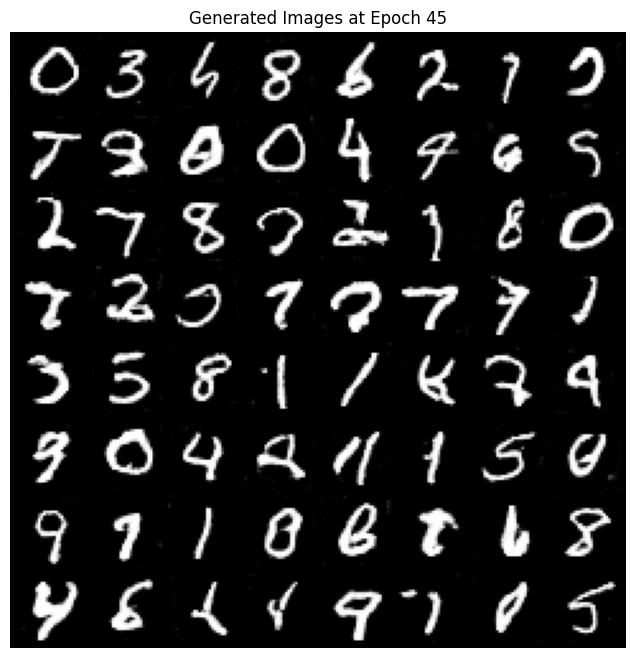

[46/100][0/235] Loss_D: 0.6744 Loss_G: 1.9554 D(x): 0.7605 D(G(z)): 0.2731/0.2013
[46/100][50/235] Loss_D: 0.6971 Loss_G: 1.6709 D(x): 0.7687 D(G(z)): 0.2967/0.2412
[46/100][100/235] Loss_D: 1.1620 Loss_G: 3.7002 D(x): 0.9539 D(G(z)): 0.5823/0.0434
[46/100][150/235] Loss_D: 0.8928 Loss_G: 2.8132 D(x): 0.8947 D(G(z)): 0.4726/0.1010
[46/100][200/235] Loss_D: 0.6277 Loss_G: 1.5473 D(x): 0.6609 D(G(z)): 0.1211/0.2925


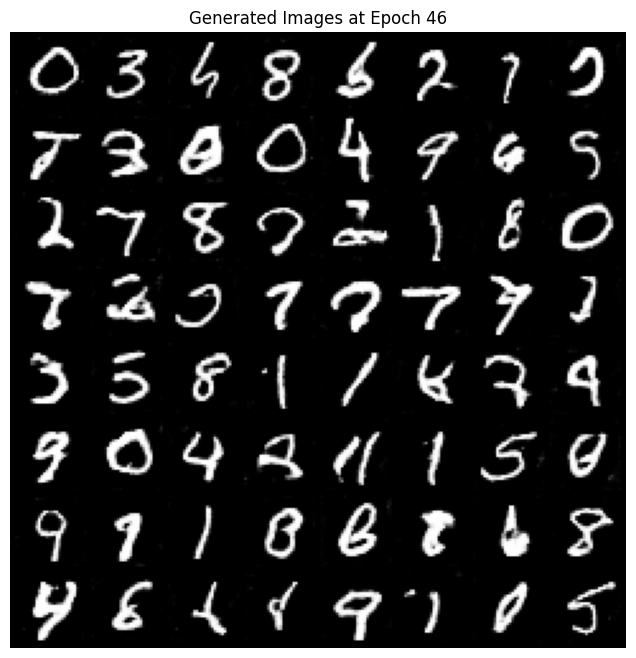

[47/100][0/235] Loss_D: 1.6467 Loss_G: 0.9408 D(x): 0.2807 D(G(z)): 0.0198/0.4727
[47/100][50/235] Loss_D: 0.6336 Loss_G: 1.6167 D(x): 0.6504 D(G(z)): 0.1200/0.2492
[47/100][100/235] Loss_D: 0.5331 Loss_G: 2.0090 D(x): 0.7706 D(G(z)): 0.1917/0.1789
[47/100][150/235] Loss_D: 1.6396 Loss_G: 1.3772 D(x): 0.3738 D(G(z)): 0.1444/0.3881
[47/100][200/235] Loss_D: 0.5824 Loss_G: 1.8924 D(x): 0.7664 D(G(z)): 0.2152/0.2060


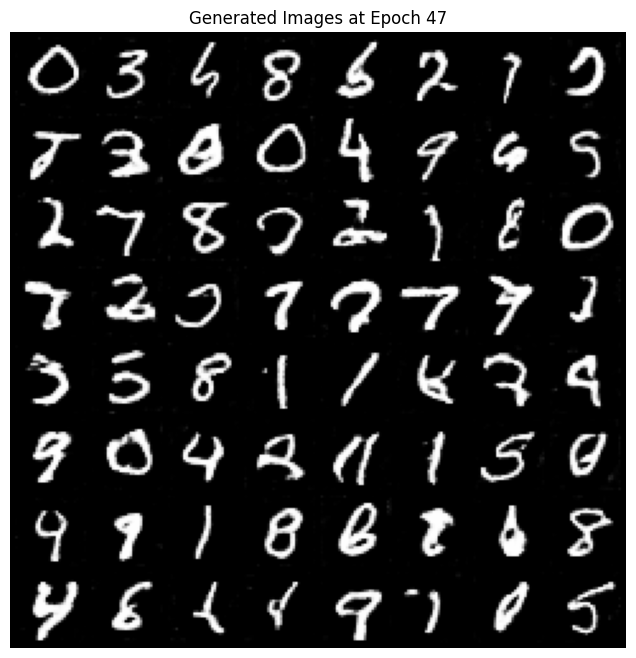

[48/100][0/235] Loss_D: 0.6653 Loss_G: 1.8712 D(x): 0.8590 D(G(z)): 0.3505/0.2044
[48/100][50/235] Loss_D: 0.7875 Loss_G: 2.2413 D(x): 0.8913 D(G(z)): 0.4221/0.1524
[48/100][100/235] Loss_D: 0.6212 Loss_G: 1.7418 D(x): 0.7421 D(G(z)): 0.2149/0.2392
[48/100][150/235] Loss_D: 0.5445 Loss_G: 2.9122 D(x): 0.8267 D(G(z)): 0.2535/0.0832
[48/100][200/235] Loss_D: 0.4496 Loss_G: 1.4691 D(x): 0.7774 D(G(z)): 0.1462/0.2881


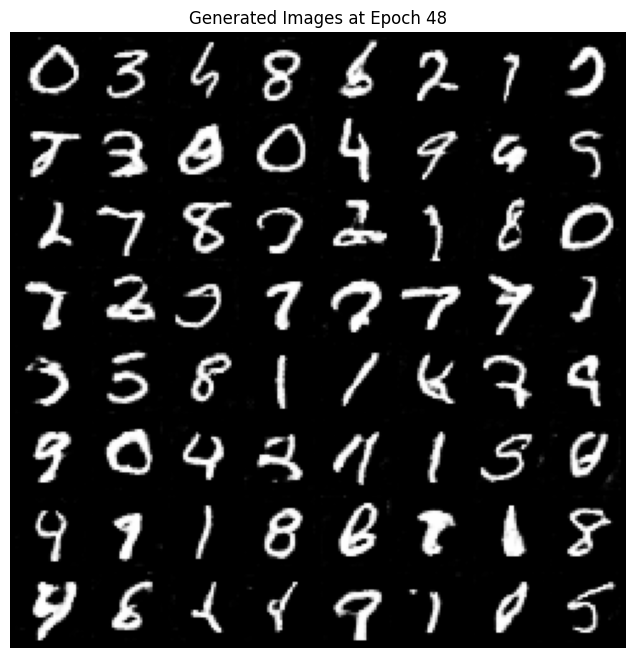

[49/100][0/235] Loss_D: 0.8012 Loss_G: 5.3042 D(x): 0.9153 D(G(z)): 0.4365/0.0092
[49/100][50/235] Loss_D: 0.7019 Loss_G: 1.7599 D(x): 0.7578 D(G(z)): 0.2881/0.2325
[49/100][100/235] Loss_D: 0.7169 Loss_G: 2.0874 D(x): 0.7214 D(G(z)): 0.2598/0.1708
[49/100][150/235] Loss_D: 0.5510 Loss_G: 1.6803 D(x): 0.7847 D(G(z)): 0.2269/0.2328
[49/100][200/235] Loss_D: 0.5508 Loss_G: 1.8381 D(x): 0.7694 D(G(z)): 0.2048/0.2033


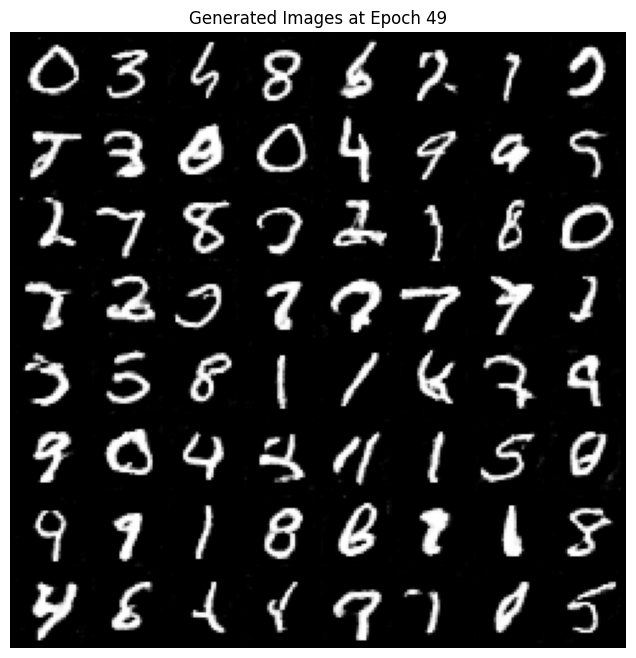

[50/100][0/235] Loss_D: 0.6502 Loss_G: 1.9398 D(x): 0.8172 D(G(z)): 0.3032/0.2001
[50/100][50/235] Loss_D: 0.5844 Loss_G: 2.2279 D(x): 0.7879 D(G(z)): 0.2435/0.1529
[50/100][100/235] Loss_D: 0.7160 Loss_G: 1.4477 D(x): 0.6303 D(G(z)): 0.1496/0.2854
[50/100][150/235] Loss_D: 0.8744 Loss_G: 3.9187 D(x): 0.9235 D(G(z)): 0.4764/0.0344
[50/100][200/235] Loss_D: 0.7084 Loss_G: 0.8731 D(x): 0.6014 D(G(z)): 0.0900/0.4821


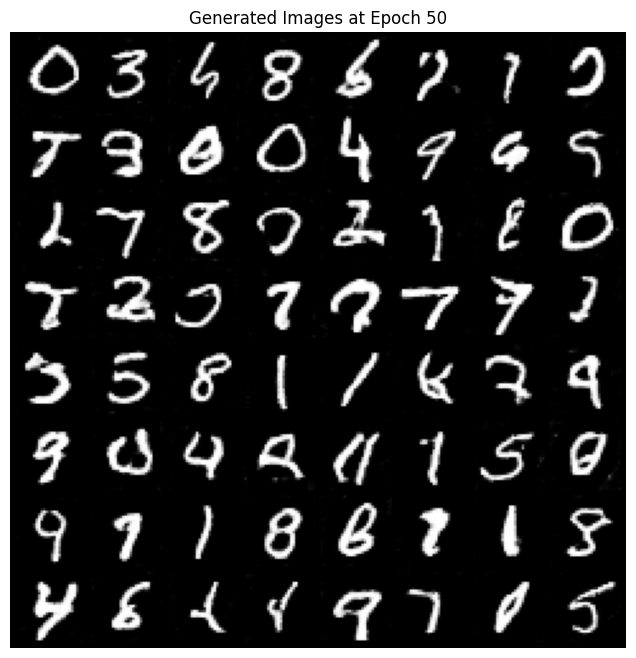

[51/100][0/235] Loss_D: 0.7647 Loss_G: 2.4983 D(x): 0.8731 D(G(z)): 0.3774/0.1289
[51/100][50/235] Loss_D: 0.6616 Loss_G: 1.6201 D(x): 0.7148 D(G(z)): 0.2215/0.2573
[51/100][100/235] Loss_D: 0.6492 Loss_G: 0.7682 D(x): 0.6457 D(G(z)): 0.1088/0.5364
[51/100][150/235] Loss_D: 0.5735 Loss_G: 2.4872 D(x): 0.8603 D(G(z)): 0.2971/0.1224
[51/100][200/235] Loss_D: 0.6434 Loss_G: 2.1463 D(x): 0.8799 D(G(z)): 0.3474/0.1591


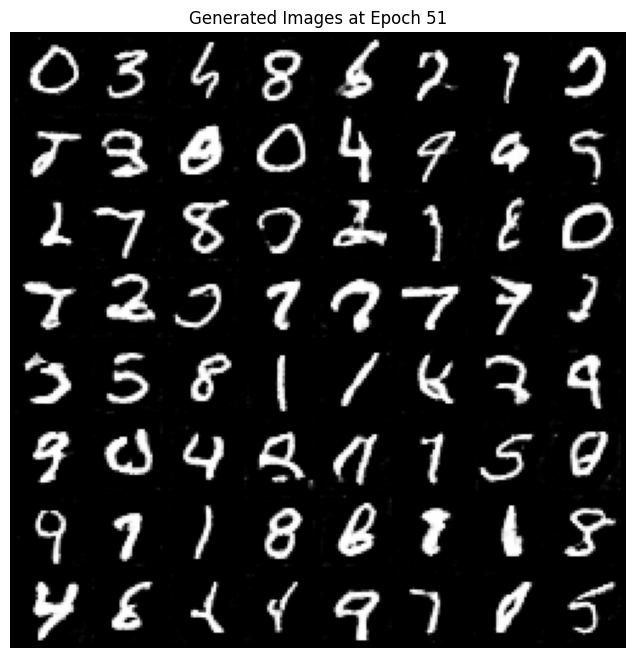

[52/100][0/235] Loss_D: 1.1120 Loss_G: 3.3038 D(x): 0.9629 D(G(z)): 0.5930/0.0581
[52/100][50/235] Loss_D: 0.8552 Loss_G: 0.5304 D(x): 0.5232 D(G(z)): 0.0658/0.6465
[52/100][100/235] Loss_D: 0.8387 Loss_G: 2.5431 D(x): 0.8915 D(G(z)): 0.4409/0.1189
[52/100][150/235] Loss_D: 1.1258 Loss_G: 0.9162 D(x): 0.5027 D(G(z)): 0.1764/0.4641
[52/100][200/235] Loss_D: 1.1517 Loss_G: 3.1333 D(x): 0.9405 D(G(z)): 0.5907/0.0766


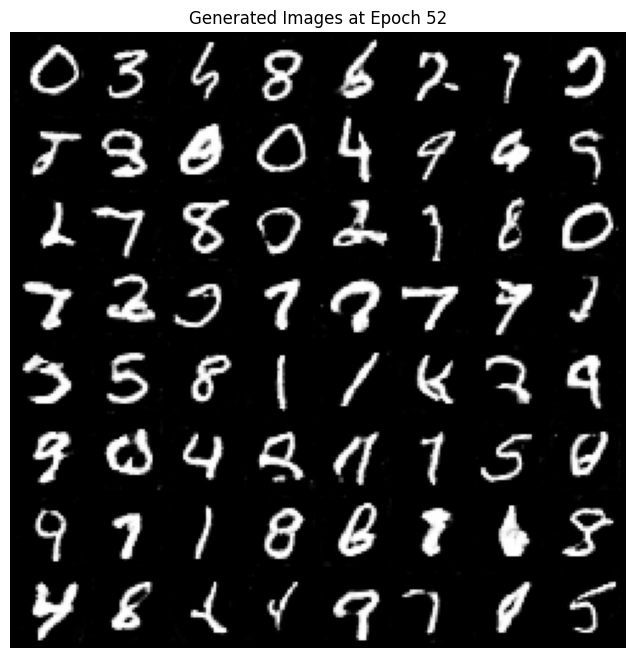

[53/100][0/235] Loss_D: 0.5980 Loss_G: 1.9234 D(x): 0.7833 D(G(z)): 0.2357/0.1978
[53/100][50/235] Loss_D: 0.5875 Loss_G: 2.5030 D(x): 0.8301 D(G(z)): 0.2794/0.1220
[53/100][100/235] Loss_D: 0.5969 Loss_G: 2.0685 D(x): 0.8152 D(G(z)): 0.2751/0.1697
[53/100][150/235] Loss_D: 0.5697 Loss_G: 2.2588 D(x): 0.8239 D(G(z)): 0.2637/0.1497
[53/100][200/235] Loss_D: 0.8953 Loss_G: 3.7276 D(x): 0.9455 D(G(z)): 0.5104/0.0384


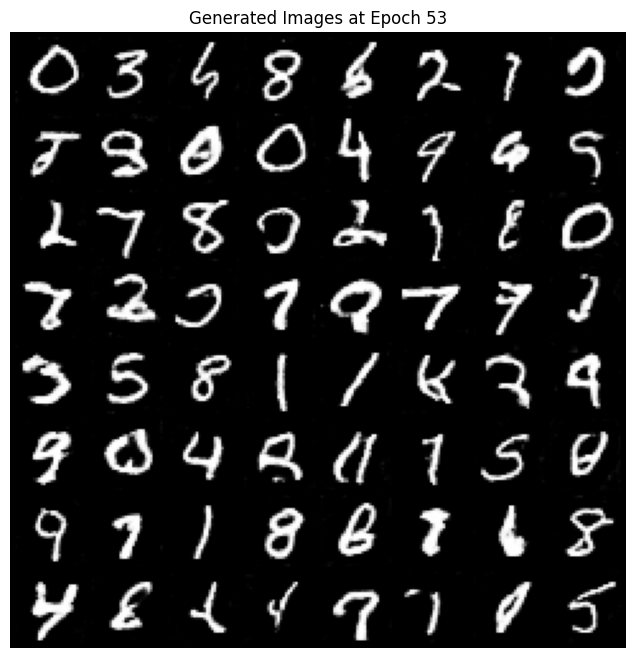

[54/100][0/235] Loss_D: 0.6452 Loss_G: 3.5426 D(x): 0.8775 D(G(z)): 0.3276/0.0520
[54/100][50/235] Loss_D: 0.6029 Loss_G: 2.0954 D(x): 0.8029 D(G(z)): 0.2619/0.1774
[54/100][100/235] Loss_D: 0.7502 Loss_G: 2.4452 D(x): 0.8451 D(G(z)): 0.3791/0.1232
[54/100][150/235] Loss_D: 0.6167 Loss_G: 2.2383 D(x): 0.7546 D(G(z)): 0.2349/0.1504
[54/100][200/235] Loss_D: 0.5715 Loss_G: 2.0400 D(x): 0.7971 D(G(z)): 0.2374/0.1856


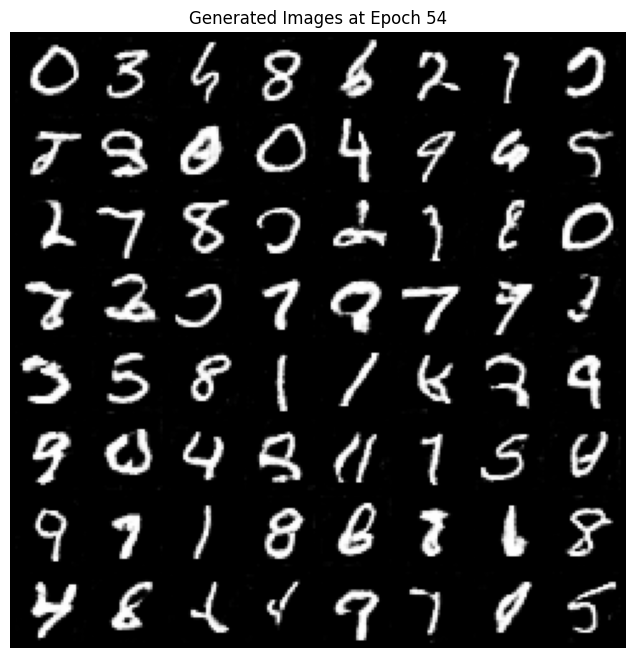

[55/100][0/235] Loss_D: 1.4016 Loss_G: 3.3110 D(x): 0.9468 D(G(z)): 0.6572/0.0664
[55/100][50/235] Loss_D: 0.6016 Loss_G: 1.5761 D(x): 0.6954 D(G(z)): 0.1535/0.2677
[55/100][100/235] Loss_D: 0.6292 Loss_G: 1.8861 D(x): 0.7849 D(G(z)): 0.2626/0.2145
[55/100][150/235] Loss_D: 0.6672 Loss_G: 1.8848 D(x): 0.7301 D(G(z)): 0.2210/0.2095
[55/100][200/235] Loss_D: 0.5340 Loss_G: 1.1316 D(x): 0.6929 D(G(z)): 0.0994/0.3873


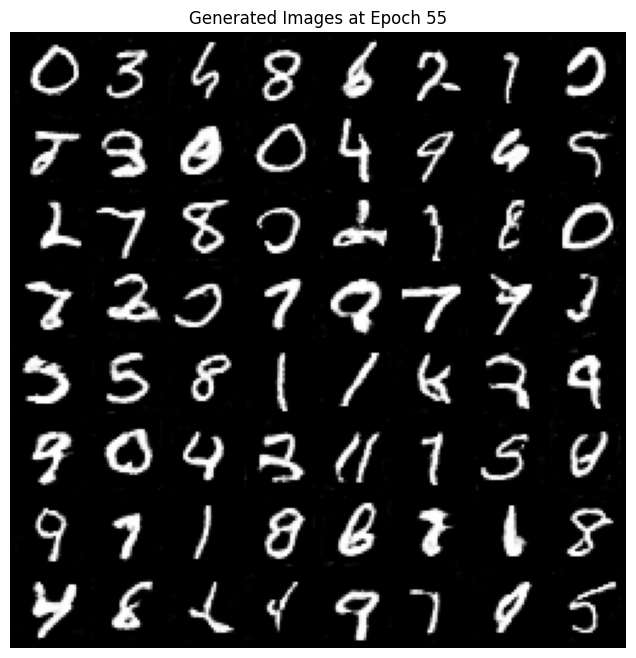

[56/100][0/235] Loss_D: 0.6309 Loss_G: 1.6467 D(x): 0.6695 D(G(z)): 0.1397/0.2559
[56/100][50/235] Loss_D: 0.6330 Loss_G: 2.0813 D(x): 0.8083 D(G(z)): 0.2939/0.1670
[56/100][100/235] Loss_D: 0.6448 Loss_G: 1.1361 D(x): 0.6523 D(G(z)): 0.1148/0.3881
[56/100][150/235] Loss_D: 0.6867 Loss_G: 3.0701 D(x): 0.9019 D(G(z)): 0.3904/0.0754
[56/100][200/235] Loss_D: 0.5800 Loss_G: 2.6704 D(x): 0.8361 D(G(z)): 0.2817/0.1062


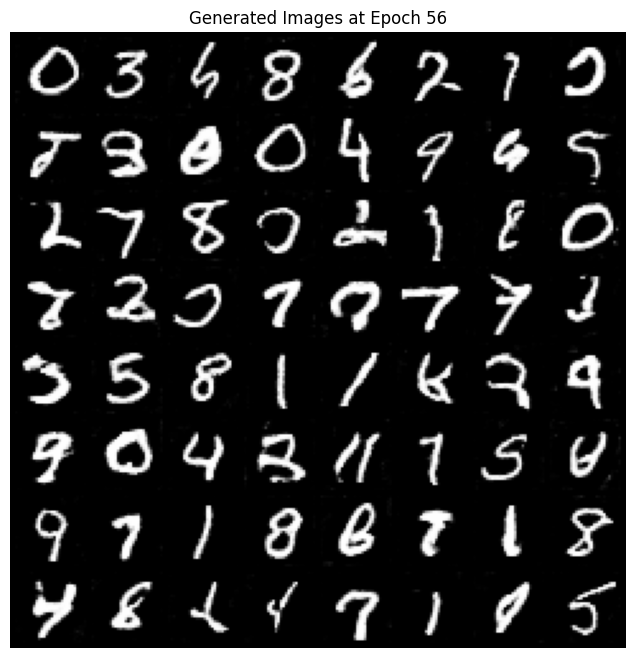

[57/100][0/235] Loss_D: 0.6794 Loss_G: 1.4226 D(x): 0.7229 D(G(z)): 0.2138/0.3081
[57/100][50/235] Loss_D: 0.9673 Loss_G: 2.7717 D(x): 0.8615 D(G(z)): 0.4939/0.0898
[57/100][100/235] Loss_D: 0.6189 Loss_G: 1.5224 D(x): 0.6831 D(G(z)): 0.1452/0.2770
[57/100][150/235] Loss_D: 0.6012 Loss_G: 1.5408 D(x): 0.7215 D(G(z)): 0.1837/0.2772
[57/100][200/235] Loss_D: 0.7410 Loss_G: 2.6021 D(x): 0.8862 D(G(z)): 0.4039/0.1098


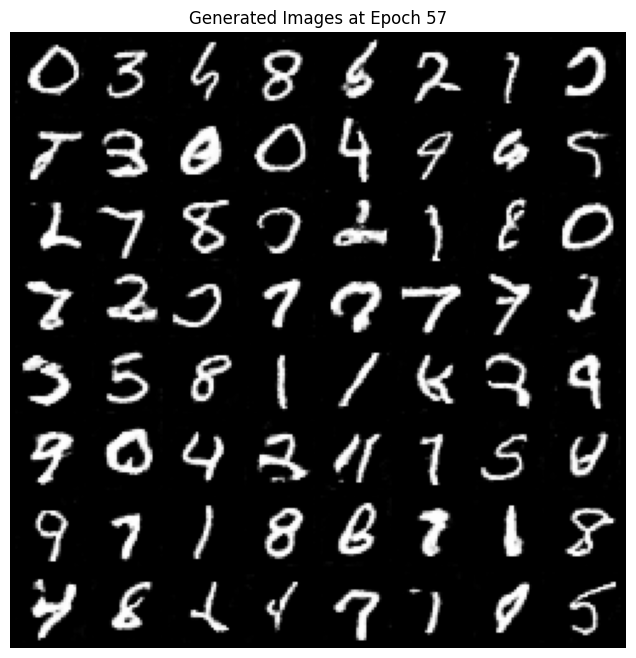

[58/100][0/235] Loss_D: 0.7624 Loss_G: 1.0846 D(x): 0.5748 D(G(z)): 0.0842/0.4180
[58/100][50/235] Loss_D: 0.5116 Loss_G: 1.9146 D(x): 0.7823 D(G(z)): 0.1921/0.2024
[58/100][100/235] Loss_D: 0.7954 Loss_G: 2.4610 D(x): 0.8099 D(G(z)): 0.3675/0.1511
[58/100][150/235] Loss_D: 0.6370 Loss_G: 1.3887 D(x): 0.6704 D(G(z)): 0.1369/0.3278
[58/100][200/235] Loss_D: 0.7567 Loss_G: 1.5821 D(x): 0.5946 D(G(z)): 0.0982/0.2782


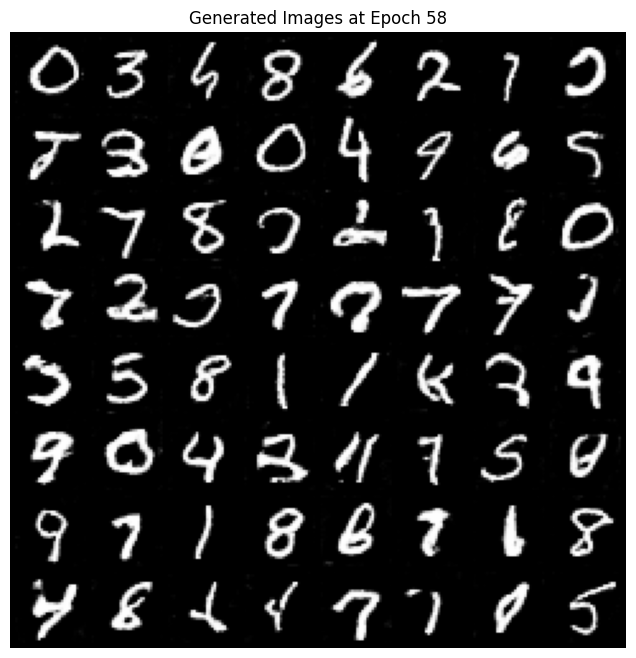

[59/100][0/235] Loss_D: 1.0657 Loss_G: 1.2606 D(x): 0.4551 D(G(z)): 0.0580/0.3577
[59/100][50/235] Loss_D: 0.7739 Loss_G: 1.8124 D(x): 0.7178 D(G(z)): 0.2893/0.2224
[59/100][100/235] Loss_D: 0.6413 Loss_G: 0.9831 D(x): 0.6239 D(G(z)): 0.0907/0.4528
[59/100][150/235] Loss_D: 0.6926 Loss_G: 1.6105 D(x): 0.6373 D(G(z)): 0.1349/0.2676
[59/100][200/235] Loss_D: 0.5814 Loss_G: 1.5977 D(x): 0.7173 D(G(z)): 0.1499/0.2617


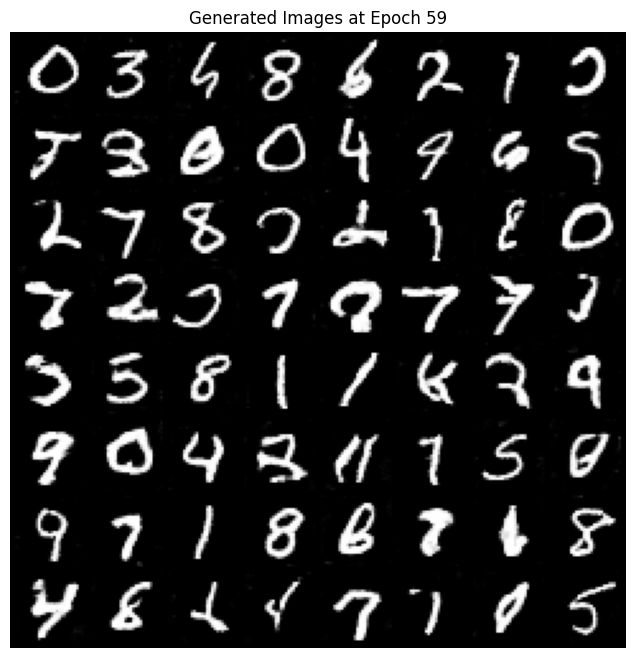

[60/100][0/235] Loss_D: 1.7408 Loss_G: 0.5348 D(x): 0.3012 D(G(z)): 0.0509/0.6572
[60/100][50/235] Loss_D: 0.5081 Loss_G: 2.1411 D(x): 0.8095 D(G(z)): 0.2135/0.1632
[60/100][100/235] Loss_D: 0.8758 Loss_G: 1.0302 D(x): 0.5335 D(G(z)): 0.0732/0.4300
[60/100][150/235] Loss_D: 0.8166 Loss_G: 4.1424 D(x): 0.8839 D(G(z)): 0.4295/0.0452
[60/100][200/235] Loss_D: 1.2309 Loss_G: 1.2608 D(x): 0.3997 D(G(z)): 0.0553/0.3622


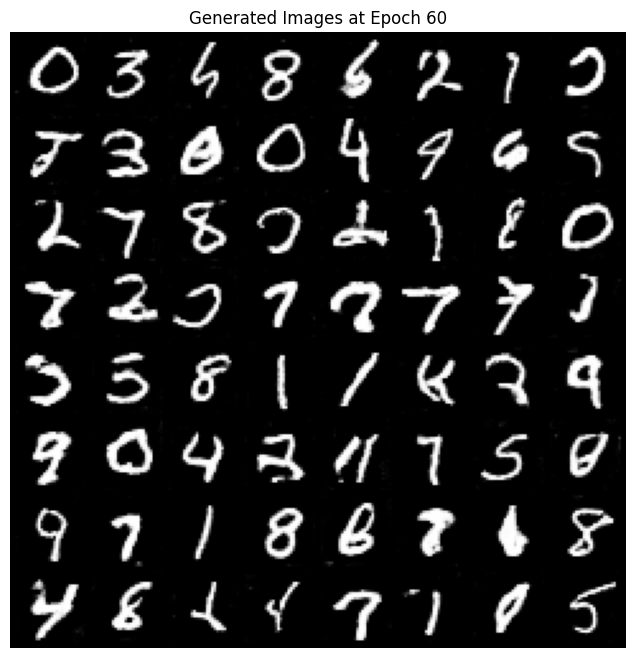

[61/100][0/235] Loss_D: 0.5559 Loss_G: 1.9174 D(x): 0.7124 D(G(z)): 0.1250/0.2108
[61/100][50/235] Loss_D: 0.5862 Loss_G: 1.9328 D(x): 0.8092 D(G(z)): 0.2589/0.2049
[61/100][100/235] Loss_D: 0.5300 Loss_G: 1.5336 D(x): 0.7215 D(G(z)): 0.1307/0.2835
[61/100][150/235] Loss_D: 0.6477 Loss_G: 1.6834 D(x): 0.7278 D(G(z)): 0.2140/0.2565
[61/100][200/235] Loss_D: 0.5796 Loss_G: 2.4627 D(x): 0.8038 D(G(z)): 0.2512/0.1377


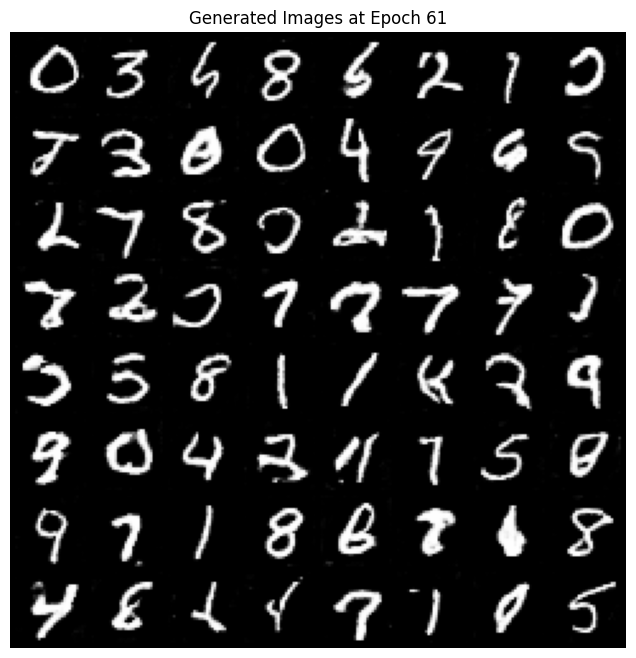

[62/100][0/235] Loss_D: 1.4066 Loss_G: 3.7087 D(x): 0.9707 D(G(z)): 0.6555/0.0521
[62/100][50/235] Loss_D: 1.2369 Loss_G: 0.7034 D(x): 0.3815 D(G(z)): 0.0332/0.6012
[62/100][100/235] Loss_D: 0.9117 Loss_G: 1.4460 D(x): 0.5027 D(G(z)): 0.0733/0.3268
[62/100][150/235] Loss_D: 0.6949 Loss_G: 2.4545 D(x): 0.9047 D(G(z)): 0.3854/0.1266
[62/100][200/235] Loss_D: 0.8575 Loss_G: 2.9354 D(x): 0.9291 D(G(z)): 0.4782/0.0836


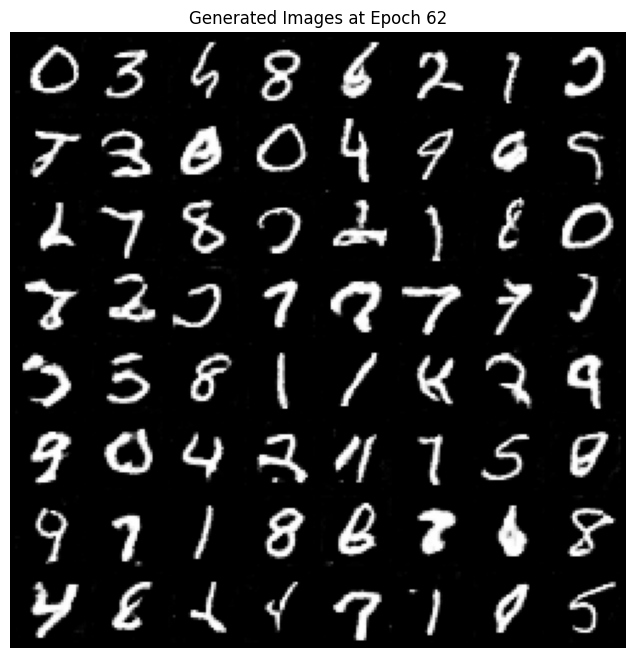

[63/100][0/235] Loss_D: 0.5529 Loss_G: 2.5579 D(x): 0.8017 D(G(z)): 0.2230/0.1276
[63/100][50/235] Loss_D: 0.6995 Loss_G: 1.2888 D(x): 0.6760 D(G(z)): 0.1755/0.3541
[63/100][100/235] Loss_D: 2.0643 Loss_G: 0.3945 D(x): 0.2189 D(G(z)): 0.0415/0.7232
[63/100][150/235] Loss_D: 0.5373 Loss_G: 1.5747 D(x): 0.7361 D(G(z)): 0.1520/0.2668
[63/100][200/235] Loss_D: 0.5581 Loss_G: 2.7134 D(x): 0.8681 D(G(z)): 0.2942/0.1033


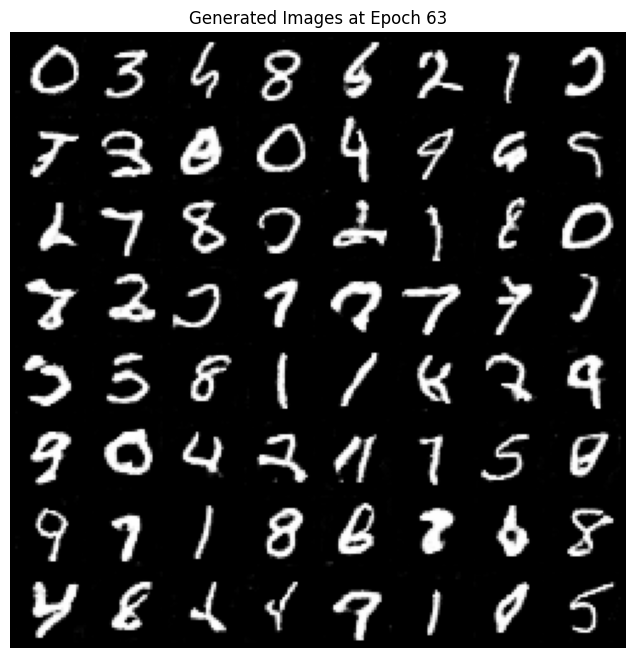

[64/100][0/235] Loss_D: 0.5921 Loss_G: 1.7353 D(x): 0.6655 D(G(z)): 0.1016/0.2448
[64/100][50/235] Loss_D: 0.4982 Loss_G: 3.1124 D(x): 0.8696 D(G(z)): 0.2614/0.0695
[64/100][100/235] Loss_D: 0.4901 Loss_G: 2.2844 D(x): 0.8133 D(G(z)): 0.2078/0.1490
[64/100][150/235] Loss_D: 0.5614 Loss_G: 2.2718 D(x): 0.7403 D(G(z)): 0.1705/0.1610
[64/100][200/235] Loss_D: 0.6682 Loss_G: 2.5393 D(x): 0.8865 D(G(z)): 0.3550/0.1249


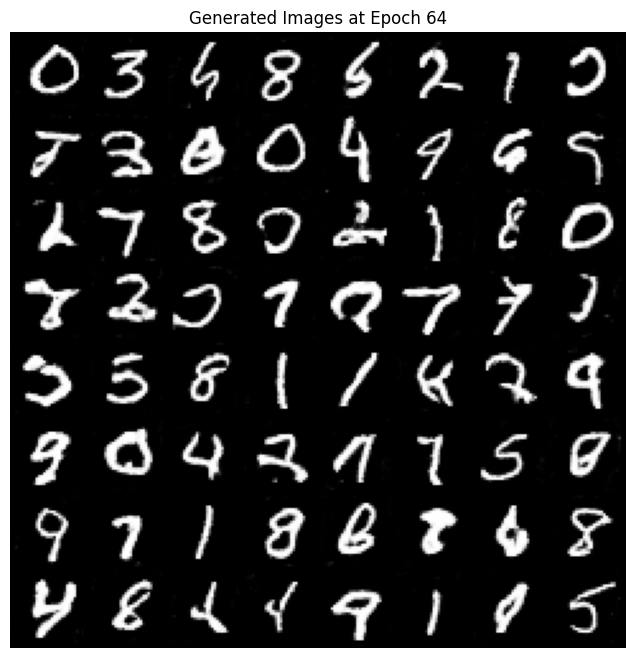

[65/100][0/235] Loss_D: 0.6755 Loss_G: 1.9298 D(x): 0.6912 D(G(z)): 0.1830/0.2112
[65/100][50/235] Loss_D: 0.6963 Loss_G: 0.7130 D(x): 0.5929 D(G(z)): 0.0664/0.5845
[65/100][100/235] Loss_D: 0.5472 Loss_G: 2.7250 D(x): 0.8571 D(G(z)): 0.2718/0.1017
[65/100][150/235] Loss_D: 0.5982 Loss_G: 0.7892 D(x): 0.6468 D(G(z)): 0.0730/0.5218
[65/100][200/235] Loss_D: 0.7723 Loss_G: 1.3209 D(x): 0.6419 D(G(z)): 0.1896/0.3482


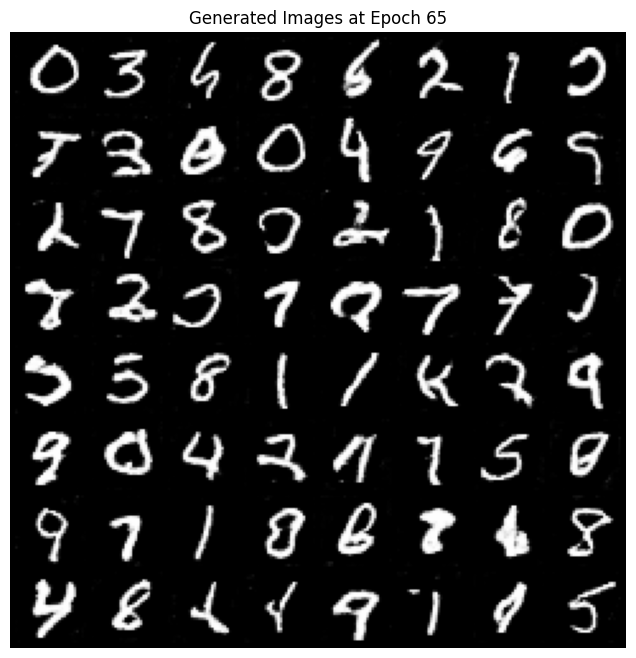

[66/100][0/235] Loss_D: 0.5588 Loss_G: 2.0643 D(x): 0.8379 D(G(z)): 0.2686/0.1878
[66/100][50/235] Loss_D: 0.5585 Loss_G: 1.2234 D(x): 0.6727 D(G(z)): 0.0853/0.3571
[66/100][100/235] Loss_D: 0.6708 Loss_G: 2.6092 D(x): 0.8340 D(G(z)): 0.3252/0.1130
[66/100][150/235] Loss_D: 0.6173 Loss_G: 2.5213 D(x): 0.8344 D(G(z)): 0.3116/0.1107
[66/100][200/235] Loss_D: 0.6233 Loss_G: 1.4353 D(x): 0.6646 D(G(z)): 0.1156/0.3129


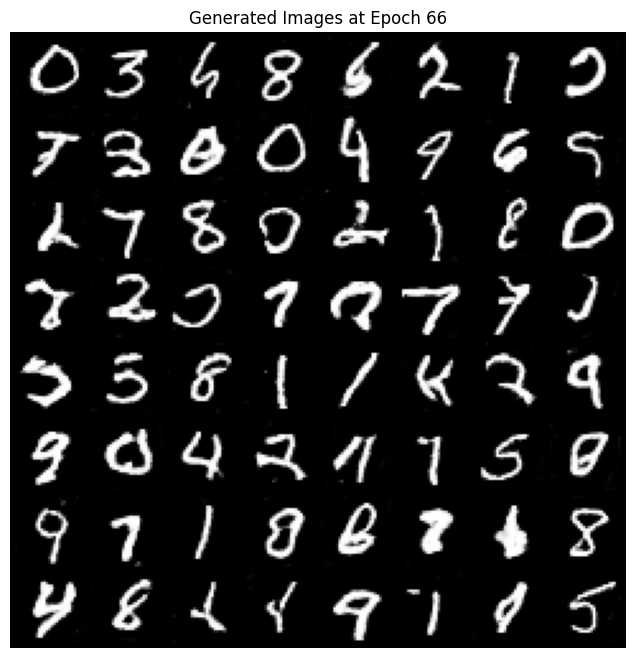

[67/100][0/235] Loss_D: 0.6257 Loss_G: 1.3691 D(x): 0.7087 D(G(z)): 0.1725/0.3439
[67/100][50/235] Loss_D: 0.5807 Loss_G: 1.6126 D(x): 0.6788 D(G(z)): 0.1101/0.2784
[67/100][100/235] Loss_D: 0.6049 Loss_G: 1.3558 D(x): 0.6534 D(G(z)): 0.0962/0.3402
[67/100][150/235] Loss_D: 1.4247 Loss_G: 0.6261 D(x): 0.3563 D(G(z)): 0.0242/0.6438
[67/100][200/235] Loss_D: 1.1320 Loss_G: 3.2213 D(x): 0.9234 D(G(z)): 0.5528/0.0755


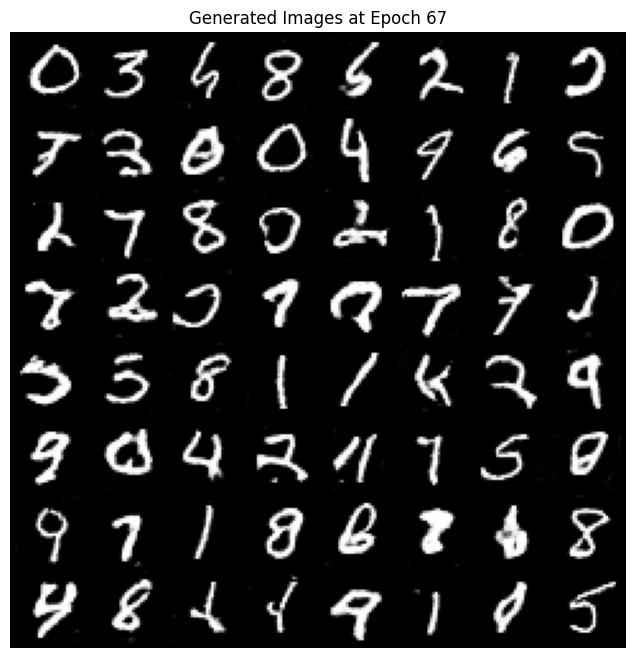

[68/100][0/235] Loss_D: 0.6915 Loss_G: 1.1196 D(x): 0.6344 D(G(z)): 0.1104/0.3986
[68/100][50/235] Loss_D: 0.7988 Loss_G: 0.6722 D(x): 0.5559 D(G(z)): 0.0656/0.5641
[68/100][100/235] Loss_D: 0.5410 Loss_G: 2.3211 D(x): 0.8412 D(G(z)): 0.2611/0.1442
[68/100][150/235] Loss_D: 1.1341 Loss_G: 3.3439 D(x): 0.9552 D(G(z)): 0.5740/0.0594
[68/100][200/235] Loss_D: 0.8924 Loss_G: 1.0775 D(x): 0.5076 D(G(z)): 0.0665/0.4258


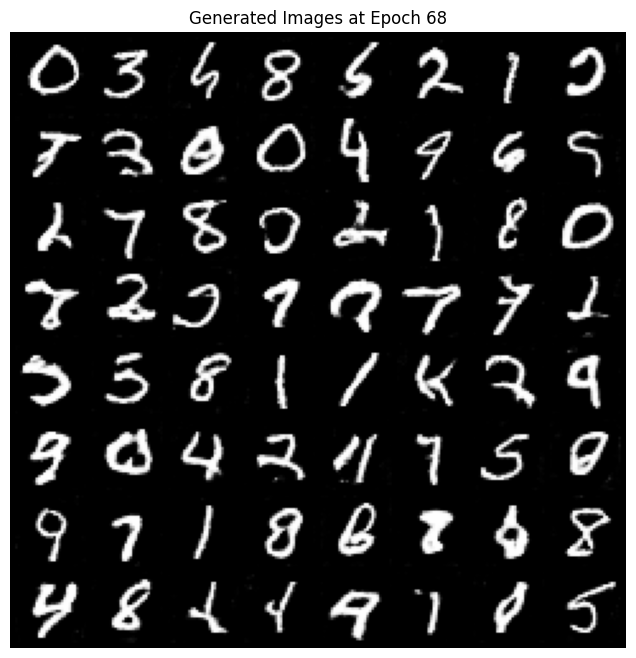

[69/100][0/235] Loss_D: 0.9755 Loss_G: 1.4620 D(x): 0.5045 D(G(z)): 0.0795/0.3376
[69/100][50/235] Loss_D: 0.5351 Loss_G: 2.3003 D(x): 0.8221 D(G(z)): 0.2234/0.1791
[69/100][100/235] Loss_D: 0.7681 Loss_G: 1.4032 D(x): 0.5827 D(G(z)): 0.1007/0.3324
[69/100][150/235] Loss_D: 0.4624 Loss_G: 2.1768 D(x): 0.8261 D(G(z)): 0.1969/0.1570
[69/100][200/235] Loss_D: 0.5381 Loss_G: 1.6630 D(x): 0.7033 D(G(z)): 0.1016/0.2669


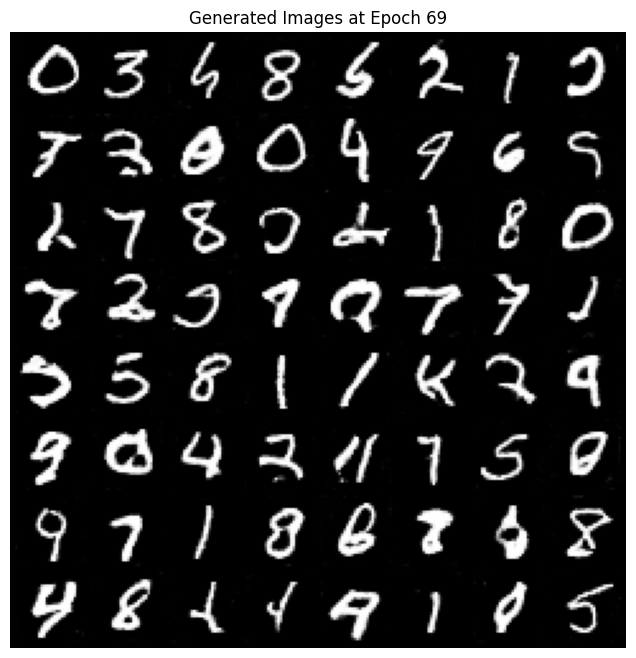

[70/100][0/235] Loss_D: 1.1806 Loss_G: 3.7491 D(x): 0.9613 D(G(z)): 0.5861/0.0518
[70/100][50/235] Loss_D: 0.9877 Loss_G: 0.9087 D(x): 0.4906 D(G(z)): 0.0565/0.5222
[70/100][100/235] Loss_D: 0.6506 Loss_G: 2.6755 D(x): 0.8780 D(G(z)): 0.3517/0.1051
[70/100][150/235] Loss_D: 1.5215 Loss_G: 4.1973 D(x): 0.9733 D(G(z)): 0.7025/0.0255
[70/100][200/235] Loss_D: 0.7138 Loss_G: 3.0581 D(x): 0.9459 D(G(z)): 0.4193/0.0722


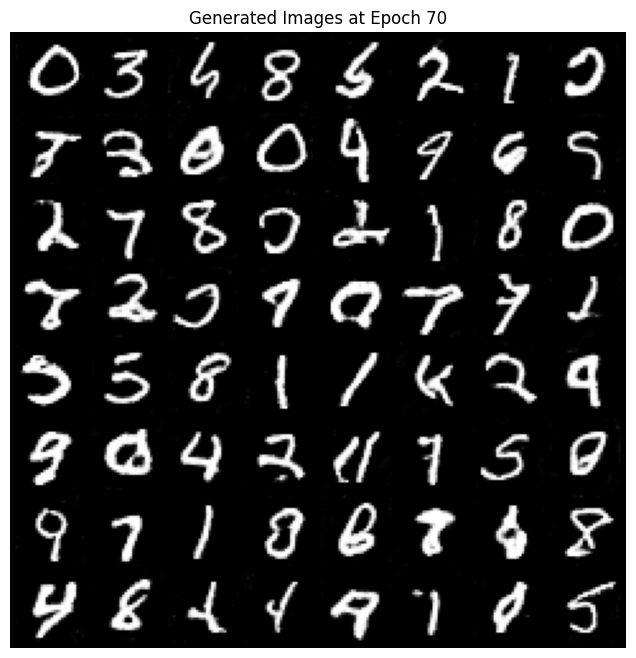

[71/100][0/235] Loss_D: 0.6049 Loss_G: 1.9954 D(x): 0.8185 D(G(z)): 0.2715/0.2035
[71/100][50/235] Loss_D: 0.6504 Loss_G: 2.7295 D(x): 0.9247 D(G(z)): 0.3810/0.0980
[71/100][100/235] Loss_D: 0.7637 Loss_G: 1.3258 D(x): 0.5936 D(G(z)): 0.0630/0.3885
[71/100][150/235] Loss_D: 0.8113 Loss_G: 1.2564 D(x): 0.5818 D(G(z)): 0.1061/0.3685
[71/100][200/235] Loss_D: 0.6797 Loss_G: 1.3177 D(x): 0.6051 D(G(z)): 0.0641/0.3356


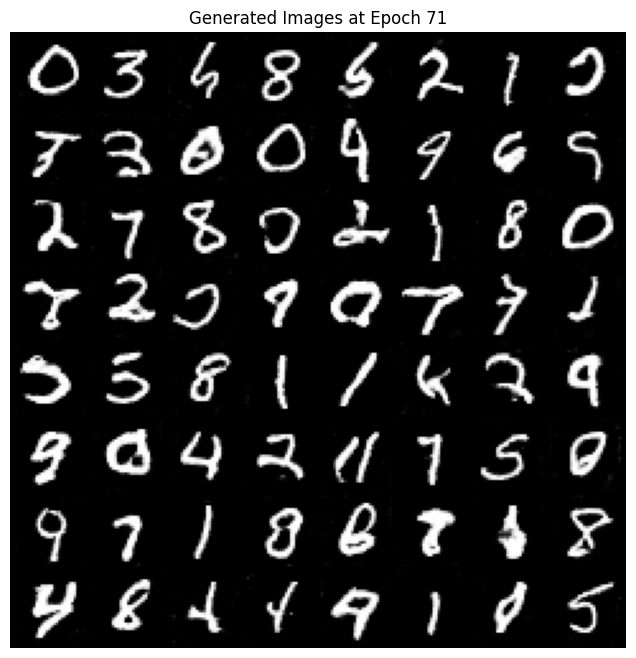

[72/100][0/235] Loss_D: 0.8807 Loss_G: 4.0864 D(x): 0.9543 D(G(z)): 0.4941/0.0319
[72/100][50/235] Loss_D: 0.8622 Loss_G: 2.1697 D(x): 0.7910 D(G(z)): 0.3939/0.1615
[72/100][100/235] Loss_D: 1.0524 Loss_G: 2.8986 D(x): 0.8671 D(G(z)): 0.5040/0.0935
[72/100][150/235] Loss_D: 0.9032 Loss_G: 1.2386 D(x): 0.5203 D(G(z)): 0.0670/0.3636
[72/100][200/235] Loss_D: 1.0113 Loss_G: 3.7830 D(x): 0.9525 D(G(z)): 0.5391/0.0397


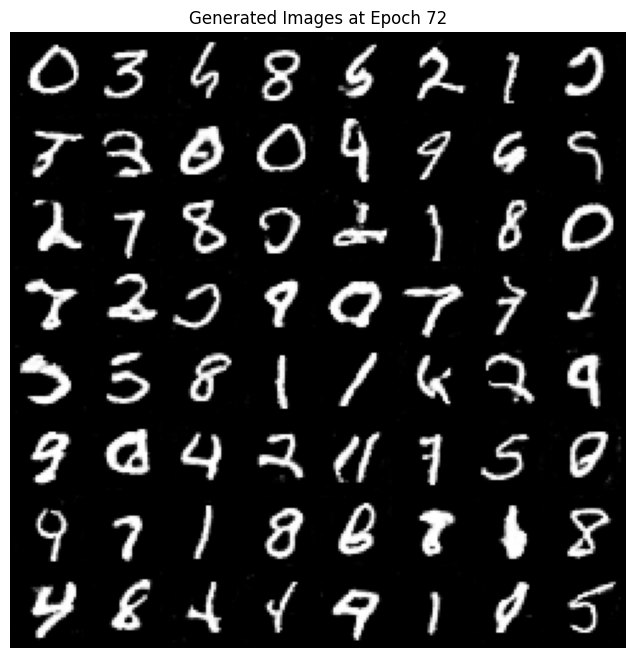

[73/100][0/235] Loss_D: 0.5281 Loss_G: 2.3058 D(x): 0.8308 D(G(z)): 0.2381/0.1500
[73/100][50/235] Loss_D: 0.7613 Loss_G: 3.4871 D(x): 0.9326 D(G(z)): 0.4416/0.0500
[73/100][100/235] Loss_D: 0.9299 Loss_G: 1.0877 D(x): 0.4954 D(G(z)): 0.0468/0.4110
[73/100][150/235] Loss_D: 0.5984 Loss_G: 1.7462 D(x): 0.7008 D(G(z)): 0.1527/0.2362
[73/100][200/235] Loss_D: 0.5254 Loss_G: 2.1484 D(x): 0.8072 D(G(z)): 0.2252/0.1603


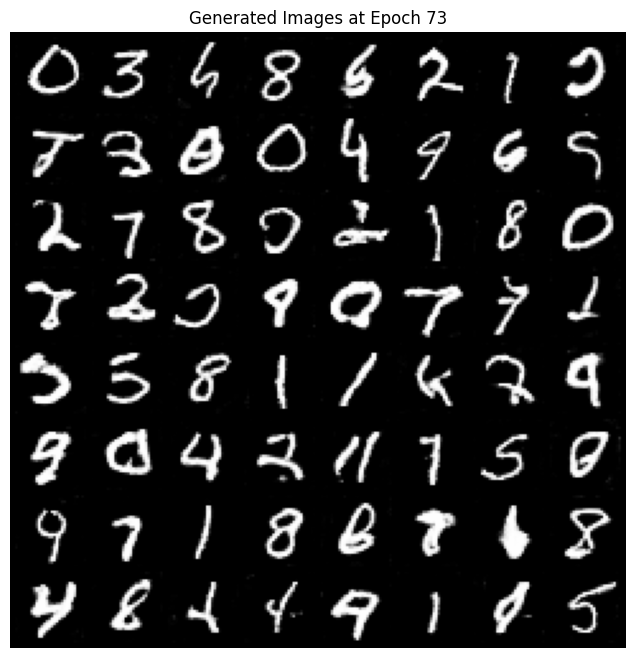

[74/100][0/235] Loss_D: 0.6271 Loss_G: 1.5172 D(x): 0.7267 D(G(z)): 0.1784/0.2959
[74/100][50/235] Loss_D: 0.7250 Loss_G: 3.3993 D(x): 0.9443 D(G(z)): 0.4146/0.0576
[74/100][100/235] Loss_D: 0.4517 Loss_G: 2.2537 D(x): 0.8019 D(G(z)): 0.1672/0.1537
[74/100][150/235] Loss_D: 0.5685 Loss_G: 2.4066 D(x): 0.8707 D(G(z)): 0.2840/0.1463
[74/100][200/235] Loss_D: 0.8048 Loss_G: 3.5890 D(x): 0.8952 D(G(z)): 0.4134/0.0498


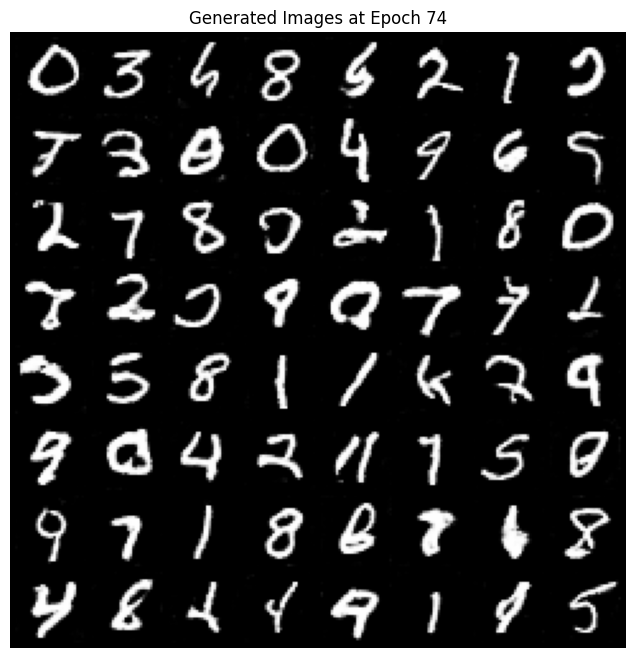

[75/100][0/235] Loss_D: 0.5960 Loss_G: 1.9472 D(x): 0.7504 D(G(z)): 0.2065/0.2101
[75/100][50/235] Loss_D: 0.6619 Loss_G: 3.7720 D(x): 0.9201 D(G(z)): 0.3798/0.0414
[75/100][100/235] Loss_D: 0.5640 Loss_G: 2.2249 D(x): 0.8410 D(G(z)): 0.2697/0.1574
[75/100][150/235] Loss_D: 0.8642 Loss_G: 3.1602 D(x): 0.9074 D(G(z)): 0.4549/0.0715
[75/100][200/235] Loss_D: 0.5962 Loss_G: 2.2625 D(x): 0.7767 D(G(z)): 0.2216/0.1706


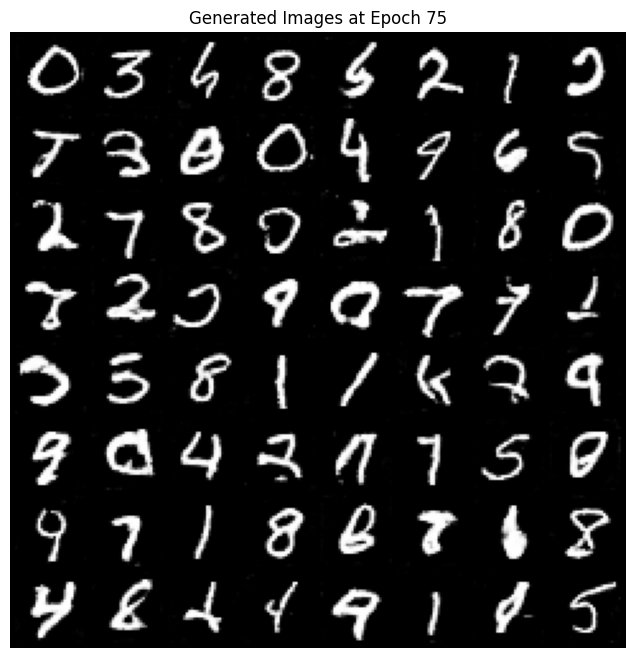

[76/100][0/235] Loss_D: 0.6117 Loss_G: 2.1249 D(x): 0.6752 D(G(z)): 0.1067/0.1827
[76/100][50/235] Loss_D: 0.4822 Loss_G: 2.0442 D(x): 0.7643 D(G(z)): 0.1428/0.1878
[76/100][100/235] Loss_D: 0.6801 Loss_G: 2.5094 D(x): 0.8654 D(G(z)): 0.3516/0.1288
[76/100][150/235] Loss_D: 0.5219 Loss_G: 3.0961 D(x): 0.8933 D(G(z)): 0.2797/0.0739
[76/100][200/235] Loss_D: 0.5405 Loss_G: 2.1337 D(x): 0.8006 D(G(z)): 0.2228/0.1709


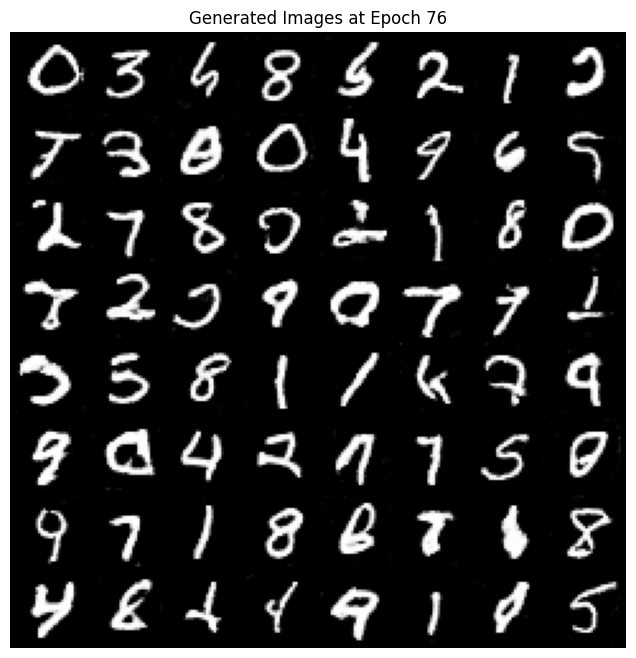

[77/100][0/235] Loss_D: 0.7588 Loss_G: 2.3059 D(x): 0.6375 D(G(z)): 0.1165/0.1750
[77/100][50/235] Loss_D: 0.5603 Loss_G: 2.1037 D(x): 0.8358 D(G(z)): 0.2660/0.1755
[77/100][100/235] Loss_D: 0.6367 Loss_G: 2.2207 D(x): 0.7153 D(G(z)): 0.1744/0.1557
[77/100][150/235] Loss_D: 1.0559 Loss_G: 2.9228 D(x): 0.8880 D(G(z)): 0.5029/0.0944
[77/100][200/235] Loss_D: 0.5105 Loss_G: 2.2214 D(x): 0.7624 D(G(z)): 0.1619/0.1589


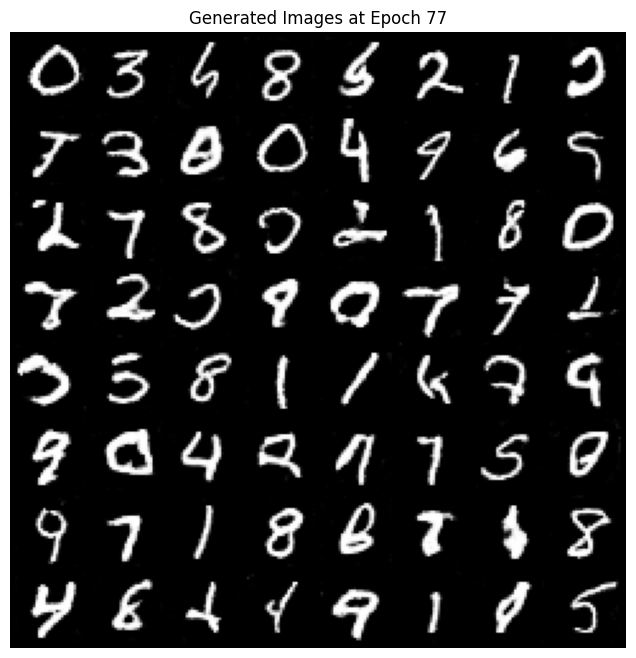

[78/100][0/235] Loss_D: 0.4541 Loss_G: 1.7978 D(x): 0.7879 D(G(z)): 0.1526/0.2363
[78/100][50/235] Loss_D: 0.6096 Loss_G: 1.4627 D(x): 0.6804 D(G(z)): 0.1174/0.3220
[78/100][100/235] Loss_D: 0.7512 Loss_G: 2.1404 D(x): 0.8018 D(G(z)): 0.3502/0.1635
[78/100][150/235] Loss_D: 0.7803 Loss_G: 3.5961 D(x): 0.9431 D(G(z)): 0.4476/0.0463
[78/100][200/235] Loss_D: 0.5047 Loss_G: 1.9443 D(x): 0.7549 D(G(z)): 0.1486/0.2123


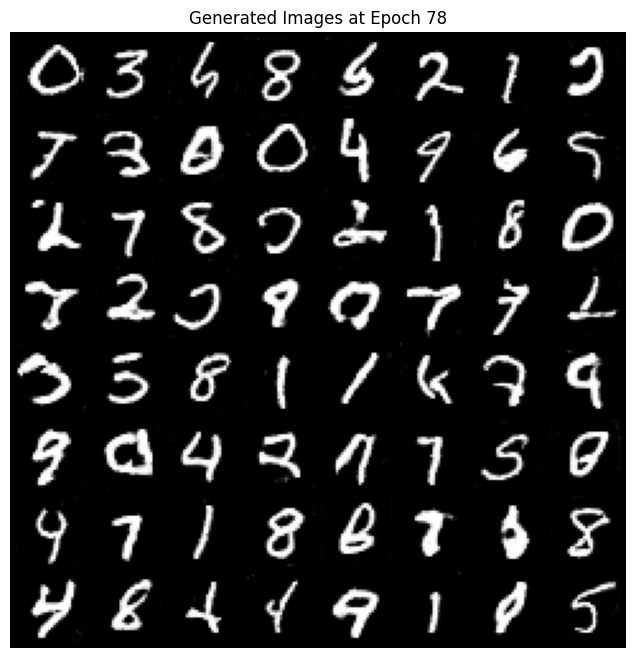

[79/100][0/235] Loss_D: 0.6536 Loss_G: 3.2544 D(x): 0.8724 D(G(z)): 0.3219/0.0695
[79/100][50/235] Loss_D: 0.4978 Loss_G: 3.2980 D(x): 0.8931 D(G(z)): 0.2775/0.0638
[79/100][100/235] Loss_D: 0.5394 Loss_G: 2.3043 D(x): 0.7981 D(G(z)): 0.2130/0.1493
[79/100][150/235] Loss_D: 0.6021 Loss_G: 1.9422 D(x): 0.7984 D(G(z)): 0.2507/0.2156
[79/100][200/235] Loss_D: 0.5124 Loss_G: 3.1487 D(x): 0.8653 D(G(z)): 0.2550/0.0749


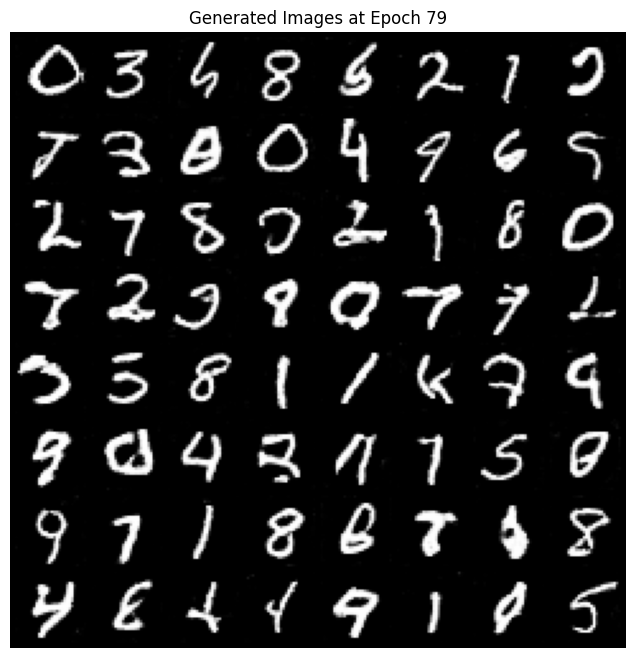

[80/100][0/235] Loss_D: 0.5258 Loss_G: 1.3622 D(x): 0.7077 D(G(z)): 0.1045/0.3387
[80/100][50/235] Loss_D: 0.6346 Loss_G: 2.6019 D(x): 0.8457 D(G(z)): 0.3054/0.1244
[80/100][100/235] Loss_D: 1.6372 Loss_G: 4.7265 D(x): 0.9577 D(G(z)): 0.6861/0.0202
[80/100][150/235] Loss_D: 0.5422 Loss_G: 1.1921 D(x): 0.6949 D(G(z)): 0.0951/0.3989
[80/100][200/235] Loss_D: 0.7480 Loss_G: 3.0035 D(x): 0.9415 D(G(z)): 0.4114/0.0924


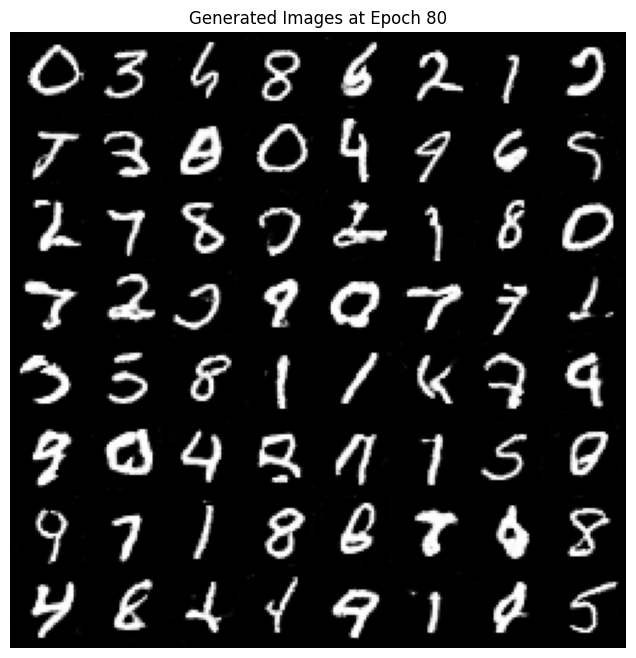

[81/100][0/235] Loss_D: 0.5339 Loss_G: 1.7942 D(x): 0.6971 D(G(z)): 0.0945/0.2444
[81/100][50/235] Loss_D: 0.7363 Loss_G: 2.8063 D(x): 0.9180 D(G(z)): 0.3855/0.1021
[81/100][100/235] Loss_D: 0.4980 Loss_G: 2.4175 D(x): 0.8333 D(G(z)): 0.2272/0.1314
[81/100][150/235] Loss_D: 0.6667 Loss_G: 1.4080 D(x): 0.6717 D(G(z)): 0.1449/0.3242
[81/100][200/235] Loss_D: 0.7043 Loss_G: 1.6117 D(x): 0.6082 D(G(z)): 0.0879/0.2812


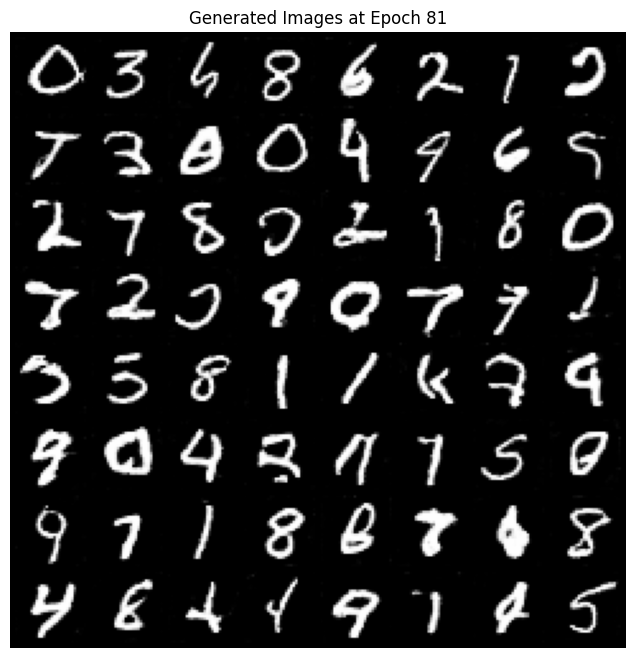

[82/100][0/235] Loss_D: 1.2159 Loss_G: 3.8259 D(x): 0.9619 D(G(z)): 0.5810/0.0479
[82/100][50/235] Loss_D: 0.8822 Loss_G: 1.3378 D(x): 0.5308 D(G(z)): 0.0725/0.3673
[82/100][100/235] Loss_D: 0.5276 Loss_G: 3.3973 D(x): 0.8998 D(G(z)): 0.2879/0.0583
[82/100][150/235] Loss_D: 0.7615 Loss_G: 1.5022 D(x): 0.6211 D(G(z)): 0.1487/0.3056
[82/100][200/235] Loss_D: 0.7116 Loss_G: 1.6503 D(x): 0.6112 D(G(z)): 0.0998/0.2773


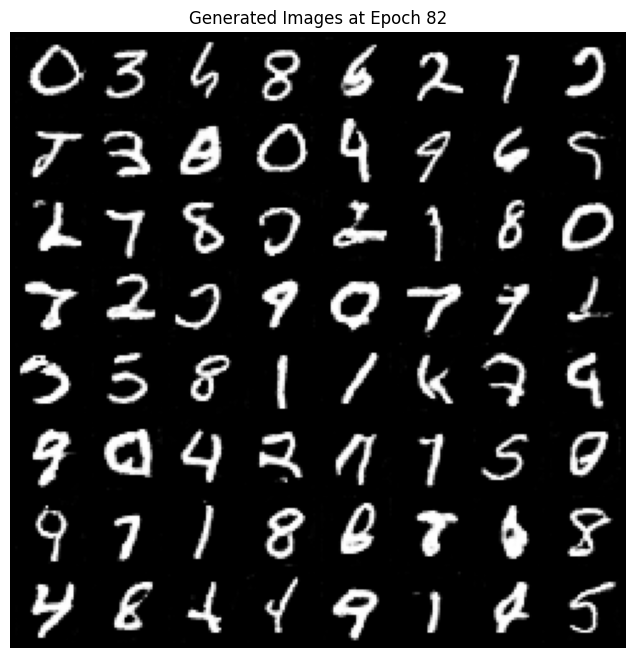

[83/100][0/235] Loss_D: 1.5636 Loss_G: 4.3970 D(x): 0.9650 D(G(z)): 0.6888/0.0262
[83/100][50/235] Loss_D: 0.5023 Loss_G: 2.1164 D(x): 0.7690 D(G(z)): 0.1595/0.1743
[83/100][100/235] Loss_D: 0.4509 Loss_G: 2.6014 D(x): 0.8534 D(G(z)): 0.2117/0.1178
[83/100][150/235] Loss_D: 0.5737 Loss_G: 2.8214 D(x): 0.8741 D(G(z)): 0.3070/0.0923
[83/100][200/235] Loss_D: 0.6675 Loss_G: 2.7632 D(x): 0.8842 D(G(z)): 0.3565/0.1022


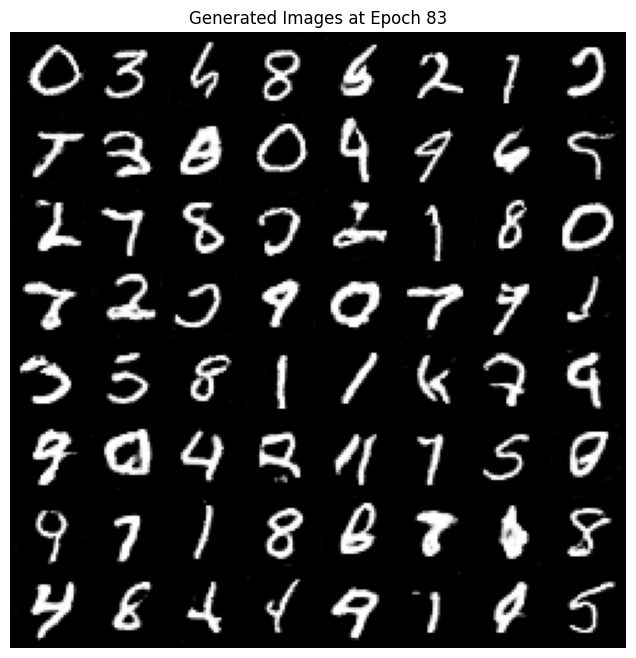

[84/100][0/235] Loss_D: 1.0990 Loss_G: 0.6091 D(x): 0.4257 D(G(z)): 0.0257/0.6208
[84/100][50/235] Loss_D: 0.6898 Loss_G: 3.6571 D(x): 0.9211 D(G(z)): 0.3862/0.0494
[84/100][100/235] Loss_D: 0.5513 Loss_G: 2.4569 D(x): 0.7590 D(G(z)): 0.1792/0.1437
[84/100][150/235] Loss_D: 0.6868 Loss_G: 3.0671 D(x): 0.8692 D(G(z)): 0.3505/0.0786
[84/100][200/235] Loss_D: 0.5660 Loss_G: 1.3488 D(x): 0.6709 D(G(z)): 0.0669/0.3432


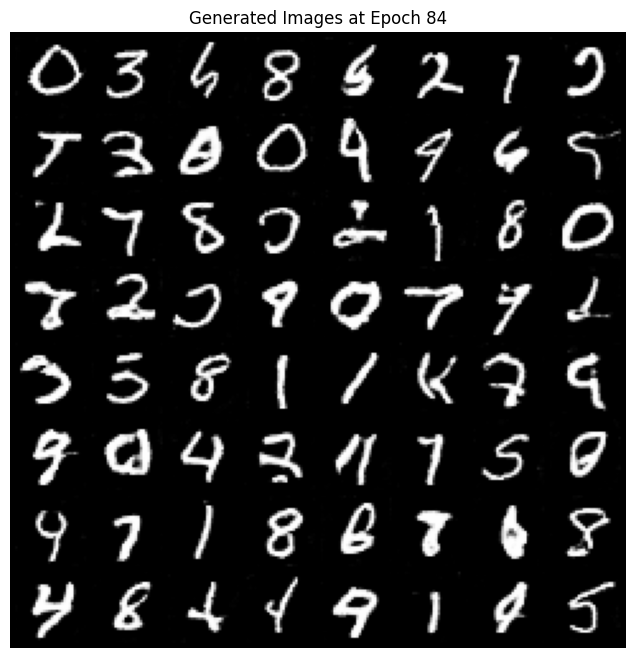

[85/100][0/235] Loss_D: 0.5214 Loss_G: 2.0408 D(x): 0.7516 D(G(z)): 0.1498/0.1873
[85/100][50/235] Loss_D: 0.5792 Loss_G: 1.7412 D(x): 0.7317 D(G(z)): 0.1735/0.2519
[85/100][100/235] Loss_D: 0.5770 Loss_G: 1.4404 D(x): 0.7689 D(G(z)): 0.2159/0.3069
[85/100][150/235] Loss_D: 0.8598 Loss_G: 1.5093 D(x): 0.5618 D(G(z)): 0.0923/0.3038
[85/100][200/235] Loss_D: 0.7467 Loss_G: 2.0637 D(x): 0.7563 D(G(z)): 0.2910/0.1846


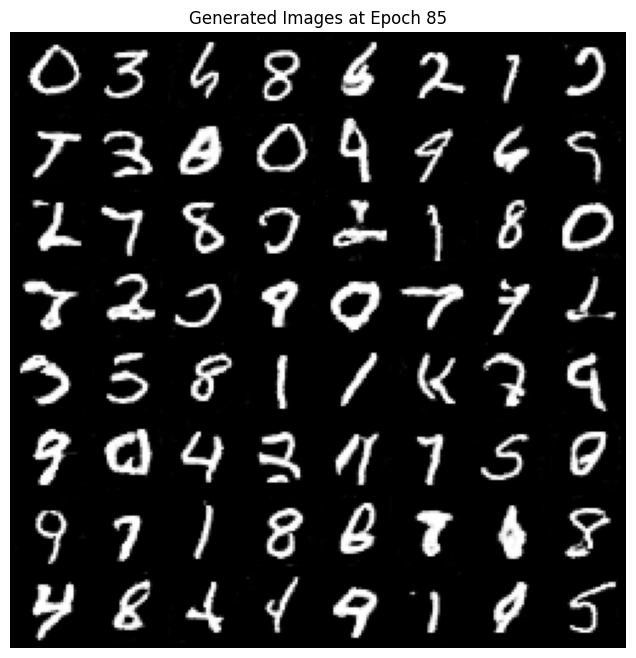

[86/100][0/235] Loss_D: 0.5213 Loss_G: 2.4837 D(x): 0.7972 D(G(z)): 0.1958/0.1311
[86/100][50/235] Loss_D: 0.6826 Loss_G: 1.8228 D(x): 0.7598 D(G(z)): 0.2447/0.2300
[86/100][100/235] Loss_D: 0.5932 Loss_G: 2.4890 D(x): 0.8055 D(G(z)): 0.2568/0.1316
[86/100][150/235] Loss_D: 0.5510 Loss_G: 2.4659 D(x): 0.8570 D(G(z)): 0.2800/0.1278
[86/100][200/235] Loss_D: 0.4665 Loss_G: 2.7533 D(x): 0.8770 D(G(z)): 0.2393/0.1002


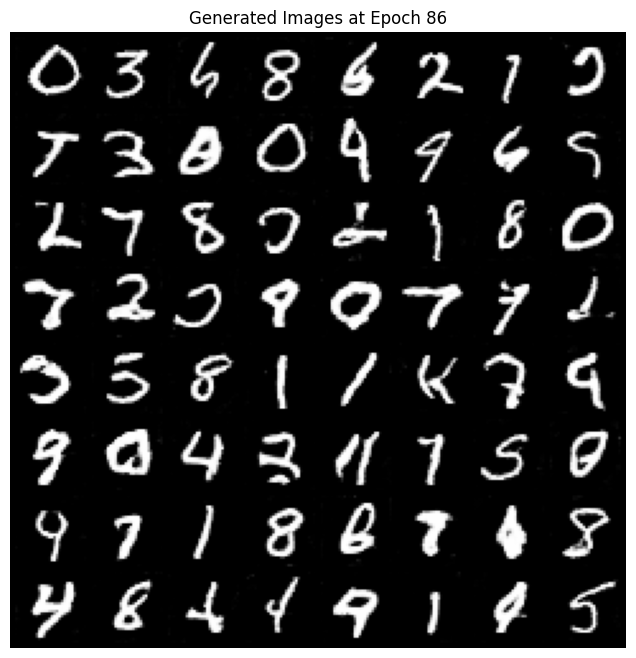

[87/100][0/235] Loss_D: 0.3728 Loss_G: 3.1544 D(x): 0.8795 D(G(z)): 0.1838/0.0691
[87/100][50/235] Loss_D: 0.9347 Loss_G: 1.5114 D(x): 0.4942 D(G(z)): 0.0454/0.3257
[87/100][100/235] Loss_D: 0.8287 Loss_G: 2.9215 D(x): 0.9339 D(G(z)): 0.4507/0.0879
[87/100][150/235] Loss_D: 0.4539 Loss_G: 2.3298 D(x): 0.8257 D(G(z)): 0.1850/0.1469
[87/100][200/235] Loss_D: 0.6592 Loss_G: 1.8387 D(x): 0.6241 D(G(z)): 0.0770/0.2309


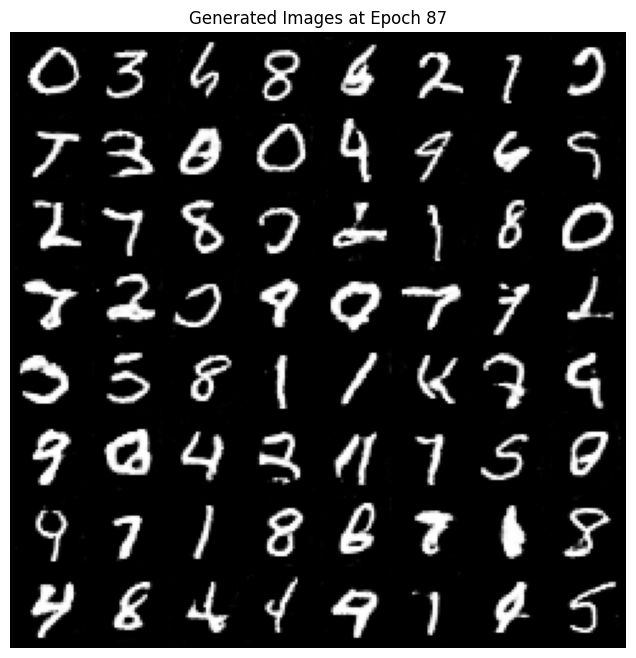

[88/100][0/235] Loss_D: 0.8206 Loss_G: 2.8492 D(x): 0.8895 D(G(z)): 0.4079/0.1046
[88/100][50/235] Loss_D: 0.4560 Loss_G: 2.3515 D(x): 0.8209 D(G(z)): 0.1788/0.1548
[88/100][100/235] Loss_D: 0.7362 Loss_G: 1.5696 D(x): 0.6098 D(G(z)): 0.0826/0.3140
[88/100][150/235] Loss_D: 0.7172 Loss_G: 1.8665 D(x): 0.6327 D(G(z)): 0.1461/0.2127
[88/100][200/235] Loss_D: 0.5685 Loss_G: 1.3676 D(x): 0.7023 D(G(z)): 0.1249/0.3319


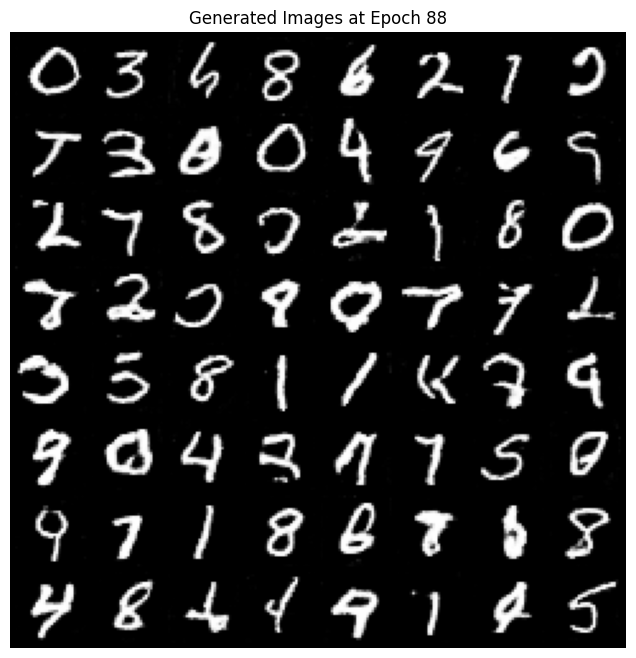

[89/100][0/235] Loss_D: 0.5648 Loss_G: 1.7476 D(x): 0.7264 D(G(z)): 0.1503/0.2396
[89/100][50/235] Loss_D: 0.5106 Loss_G: 2.3173 D(x): 0.8058 D(G(z)): 0.2105/0.1451
[89/100][100/235] Loss_D: 0.5983 Loss_G: 1.2859 D(x): 0.6639 D(G(z)): 0.0891/0.3698
[89/100][150/235] Loss_D: 0.7022 Loss_G: 1.0925 D(x): 0.6168 D(G(z)): 0.0859/0.4383
[89/100][200/235] Loss_D: 0.7834 Loss_G: 1.3850 D(x): 0.5667 D(G(z)): 0.0780/0.3346


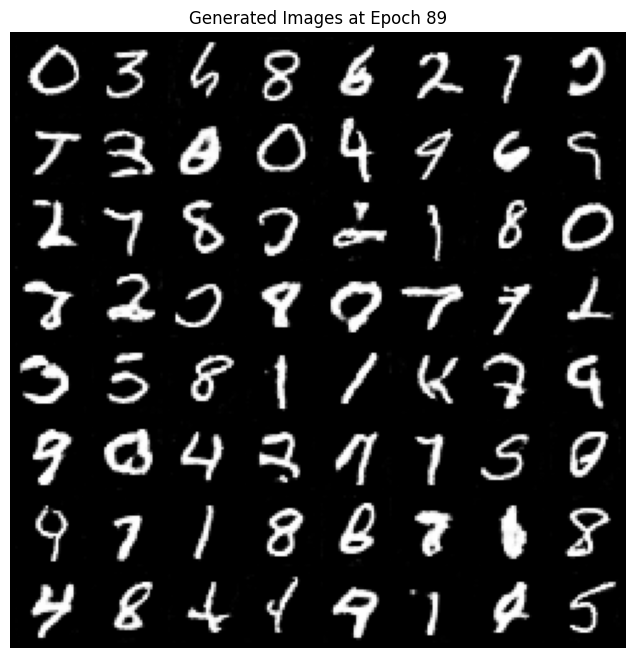

[90/100][0/235] Loss_D: 0.7677 Loss_G: 3.6812 D(x): 0.8752 D(G(z)): 0.3825/0.0515
[90/100][50/235] Loss_D: 0.5713 Loss_G: 2.0362 D(x): 0.8004 D(G(z)): 0.2292/0.1921
[90/100][100/235] Loss_D: 0.6347 Loss_G: 1.8654 D(x): 0.7692 D(G(z)): 0.2336/0.2160
[90/100][150/235] Loss_D: 0.3967 Loss_G: 1.8001 D(x): 0.8045 D(G(z)): 0.1300/0.2264
[90/100][200/235] Loss_D: 0.6241 Loss_G: 3.1076 D(x): 0.8909 D(G(z)): 0.3218/0.0880


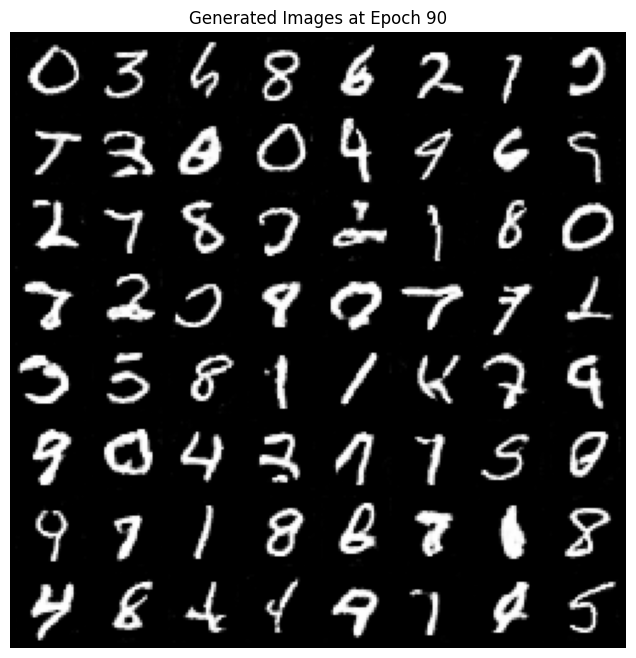

[91/100][0/235] Loss_D: 0.6074 Loss_G: 2.2555 D(x): 0.7427 D(G(z)): 0.1680/0.1709
[91/100][50/235] Loss_D: 0.3911 Loss_G: 2.2421 D(x): 0.8413 D(G(z)): 0.1636/0.1558
[91/100][100/235] Loss_D: 1.4501 Loss_G: 0.6744 D(x): 0.3807 D(G(z)): 0.0474/0.5822
[91/100][150/235] Loss_D: 0.8679 Loss_G: 2.8579 D(x): 0.9513 D(G(z)): 0.4756/0.0955
[91/100][200/235] Loss_D: 0.5123 Loss_G: 1.8420 D(x): 0.7425 D(G(z)): 0.1239/0.2375


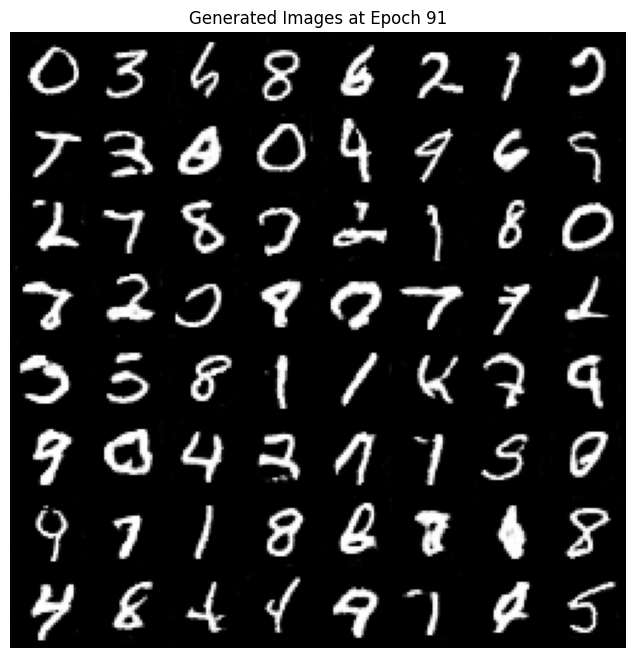

[92/100][0/235] Loss_D: 0.5922 Loss_G: 2.3565 D(x): 0.7634 D(G(z)): 0.1997/0.1561
[92/100][50/235] Loss_D: 0.7523 Loss_G: 1.7471 D(x): 0.7811 D(G(z)): 0.3081/0.2456
[92/100][100/235] Loss_D: 0.5805 Loss_G: 3.3065 D(x): 0.9277 D(G(z)): 0.3353/0.0669
[92/100][150/235] Loss_D: 1.2383 Loss_G: 5.0882 D(x): 0.9594 D(G(z)): 0.5966/0.0159
[92/100][200/235] Loss_D: 0.5050 Loss_G: 2.2728 D(x): 0.7611 D(G(z)): 0.1513/0.1622


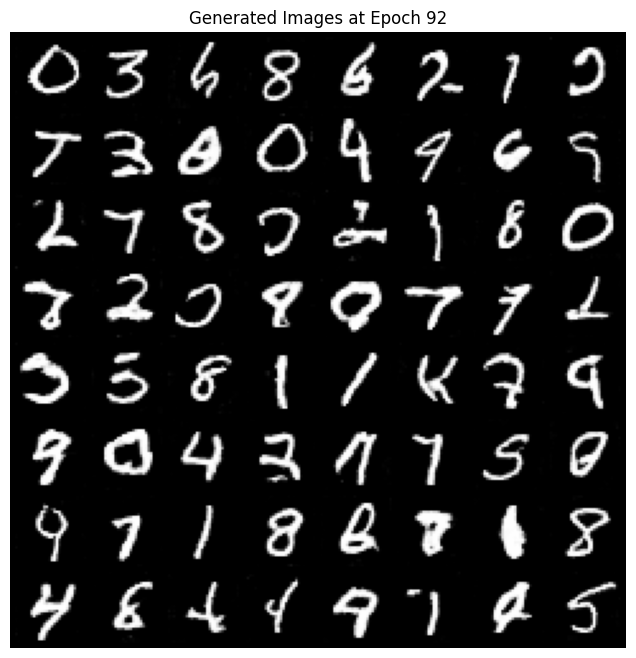

[93/100][0/235] Loss_D: 0.5582 Loss_G: 2.5691 D(x): 0.8281 D(G(z)): 0.2501/0.1194
[93/100][50/235] Loss_D: 0.5143 Loss_G: 1.6807 D(x): 0.7463 D(G(z)): 0.1384/0.2557
[93/100][100/235] Loss_D: 0.6681 Loss_G: 1.7085 D(x): 0.7230 D(G(z)): 0.2065/0.2603
[93/100][150/235] Loss_D: 1.0359 Loss_G: 1.6684 D(x): 0.4719 D(G(z)): 0.0679/0.2915
[93/100][200/235] Loss_D: 0.6181 Loss_G: 1.8865 D(x): 0.6630 D(G(z)): 0.1083/0.2215


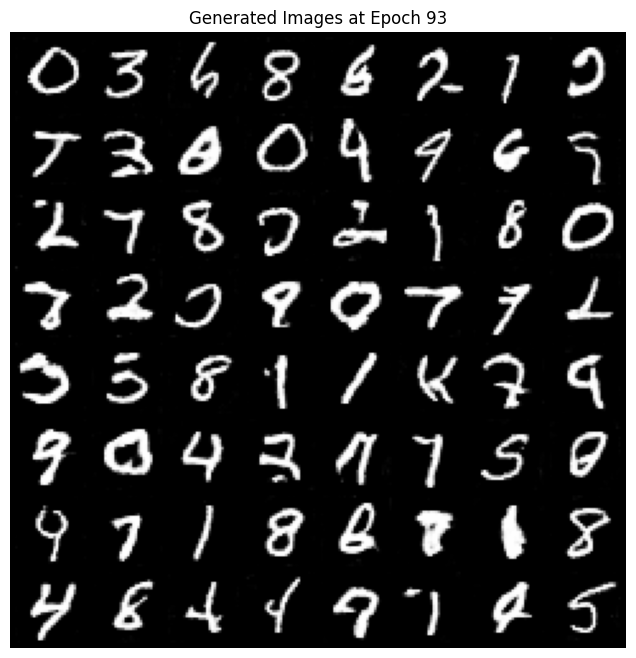

[94/100][0/235] Loss_D: 0.5892 Loss_G: 2.4062 D(x): 0.8511 D(G(z)): 0.2875/0.1372
[94/100][50/235] Loss_D: 0.4969 Loss_G: 2.7892 D(x): 0.8217 D(G(z)): 0.2116/0.1011
[94/100][100/235] Loss_D: 0.6478 Loss_G: 1.6010 D(x): 0.6456 D(G(z)): 0.0985/0.2855
[94/100][150/235] Loss_D: 0.4300 Loss_G: 2.6226 D(x): 0.8342 D(G(z)): 0.1797/0.1156
[94/100][200/235] Loss_D: 0.5562 Loss_G: 1.5109 D(x): 0.6980 D(G(z)): 0.1102/0.2949


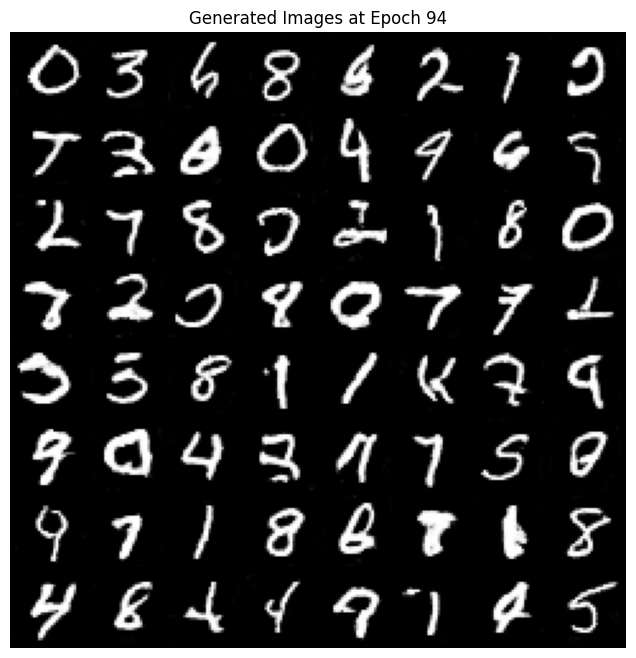

[95/100][0/235] Loss_D: 0.5089 Loss_G: 1.6415 D(x): 0.7437 D(G(z)): 0.1222/0.2836
[95/100][50/235] Loss_D: 0.8434 Loss_G: 1.8683 D(x): 0.5414 D(G(z)): 0.0631/0.2473
[95/100][100/235] Loss_D: 0.4235 Loss_G: 2.3648 D(x): 0.8209 D(G(z)): 0.1579/0.1445
[95/100][150/235] Loss_D: 0.5042 Loss_G: 2.0025 D(x): 0.7429 D(G(z)): 0.1239/0.1886
[95/100][200/235] Loss_D: 0.4788 Loss_G: 2.7854 D(x): 0.8298 D(G(z)): 0.2051/0.1110


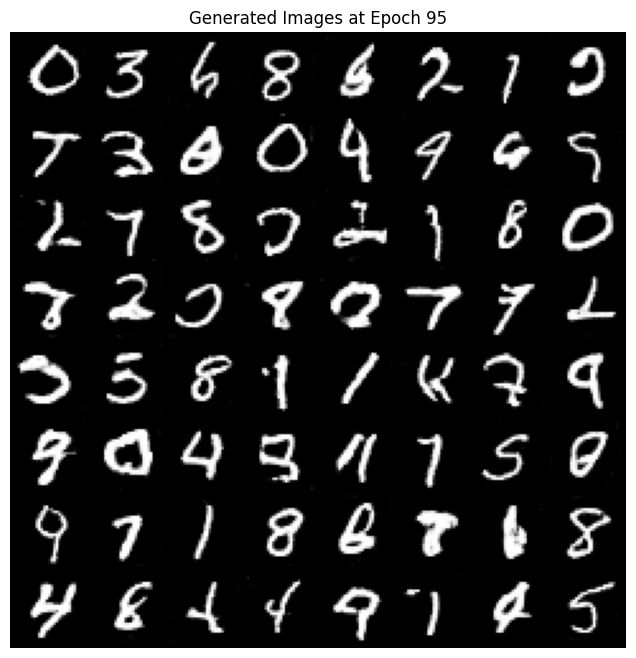

[96/100][0/235] Loss_D: 0.7054 Loss_G: 1.6865 D(x): 0.6143 D(G(z)): 0.0714/0.2750
[96/100][50/235] Loss_D: 0.4817 Loss_G: 2.6725 D(x): 0.8327 D(G(z)): 0.2036/0.1204
[96/100][100/235] Loss_D: 0.7873 Loss_G: 3.5824 D(x): 0.9364 D(G(z)): 0.4389/0.0489
[96/100][150/235] Loss_D: 0.4815 Loss_G: 1.4807 D(x): 0.7118 D(G(z)): 0.0693/0.3008
[96/100][200/235] Loss_D: 0.5996 Loss_G: 1.7015 D(x): 0.7351 D(G(z)): 0.1756/0.2730


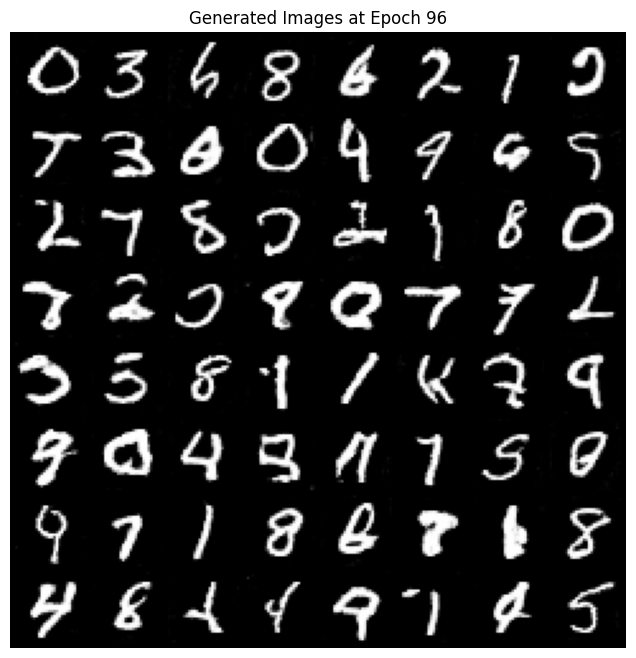

[97/100][0/235] Loss_D: 0.9532 Loss_G: 3.1663 D(x): 0.8954 D(G(z)): 0.4796/0.0774
[97/100][50/235] Loss_D: 0.5260 Loss_G: 2.3089 D(x): 0.8338 D(G(z)): 0.2430/0.1511
[97/100][100/235] Loss_D: 0.5602 Loss_G: 3.0852 D(x): 0.8889 D(G(z)): 0.2948/0.0820
[97/100][150/235] Loss_D: 0.4284 Loss_G: 2.8377 D(x): 0.8563 D(G(z)): 0.1978/0.0954
[97/100][200/235] Loss_D: 0.4952 Loss_G: 1.9211 D(x): 0.7628 D(G(z)): 0.1464/0.2138


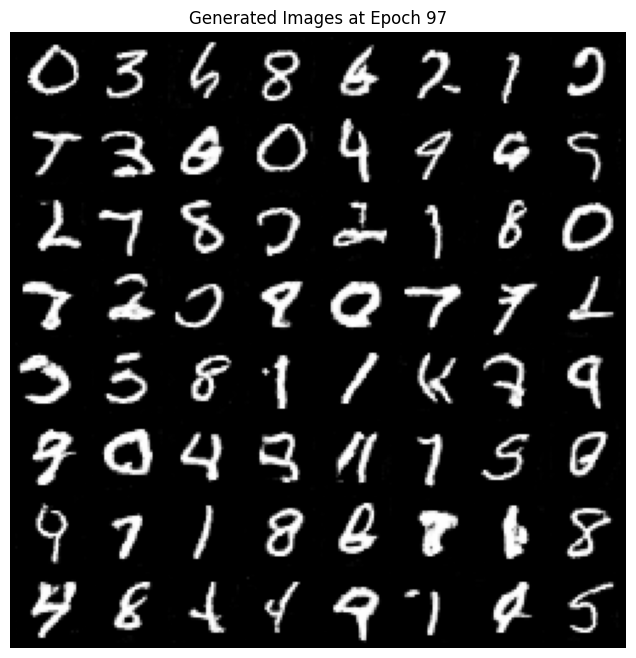

[98/100][0/235] Loss_D: 0.7457 Loss_G: 2.6774 D(x): 0.8368 D(G(z)): 0.3281/0.1246
[98/100][50/235] Loss_D: 0.5172 Loss_G: 2.8302 D(x): 0.8487 D(G(z)): 0.2363/0.0998
[98/100][100/235] Loss_D: 0.6298 Loss_G: 2.2089 D(x): 0.8264 D(G(z)): 0.2905/0.1767
[98/100][150/235] Loss_D: 0.5118 Loss_G: 1.9628 D(x): 0.7455 D(G(z)): 0.1391/0.2200
[98/100][200/235] Loss_D: 0.8764 Loss_G: 4.0067 D(x): 0.9517 D(G(z)): 0.4712/0.0386


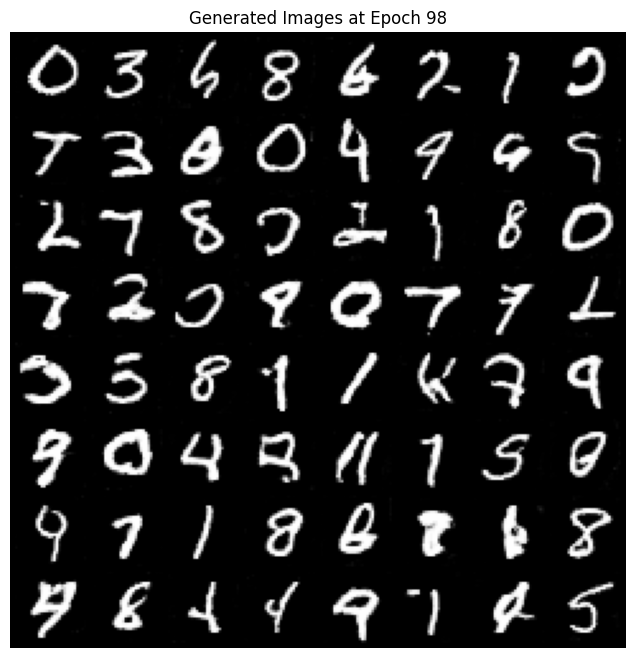

[99/100][0/235] Loss_D: 0.4569 Loss_G: 2.8773 D(x): 0.8386 D(G(z)): 0.1896/0.1066
[99/100][50/235] Loss_D: 0.4231 Loss_G: 1.9848 D(x): 0.7956 D(G(z)): 0.1352/0.2109
[99/100][100/235] Loss_D: 0.5279 Loss_G: 3.1600 D(x): 0.8374 D(G(z)): 0.2351/0.0785
[99/100][150/235] Loss_D: 0.5817 Loss_G: 3.3746 D(x): 0.9034 D(G(z)): 0.2988/0.0722
[99/100][200/235] Loss_D: 0.6728 Loss_G: 1.2973 D(x): 0.6097 D(G(z)): 0.0630/0.3624


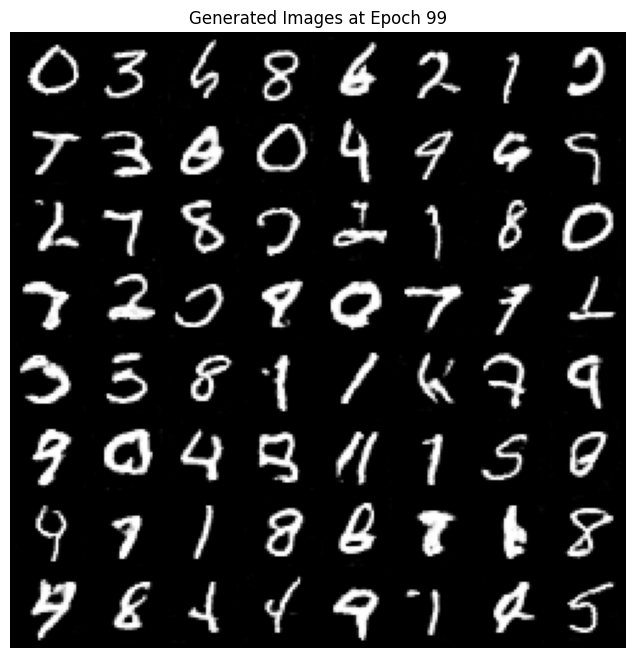

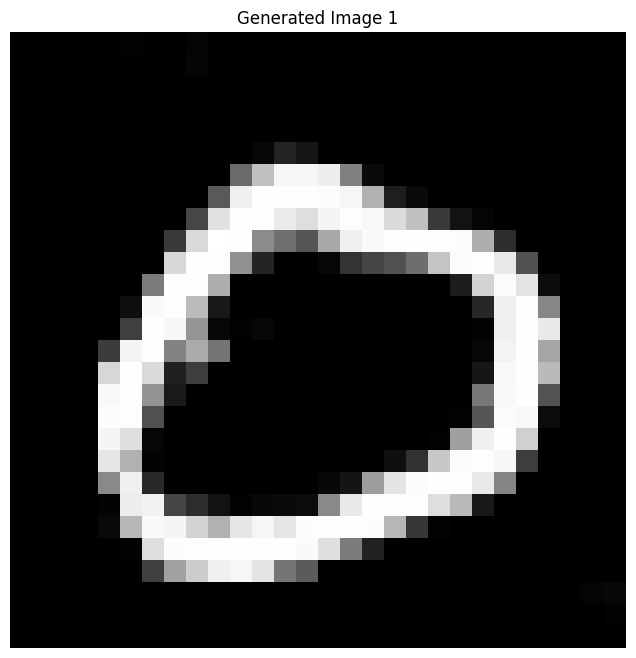

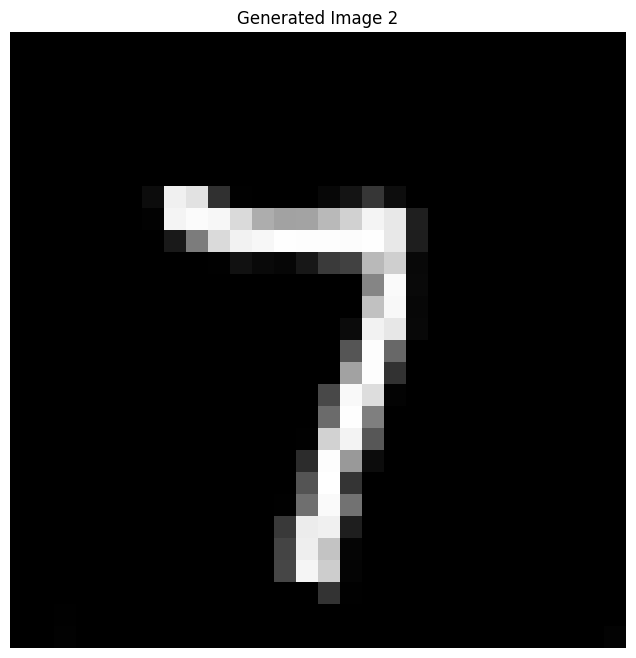

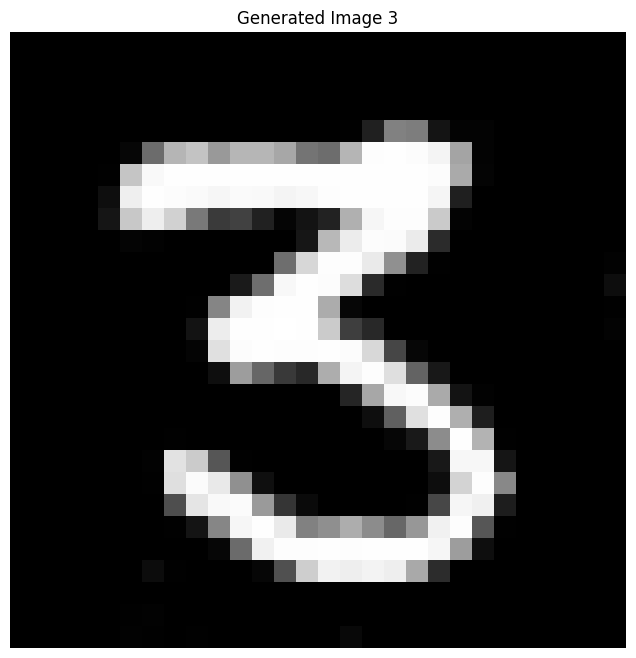

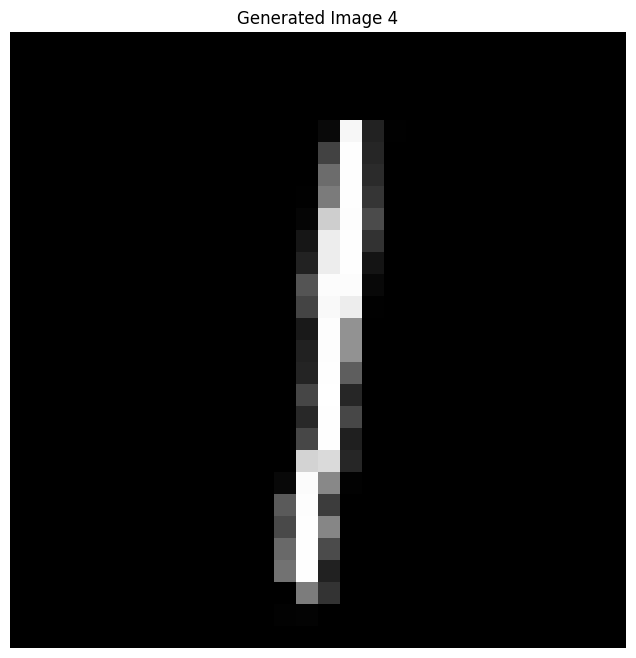

...

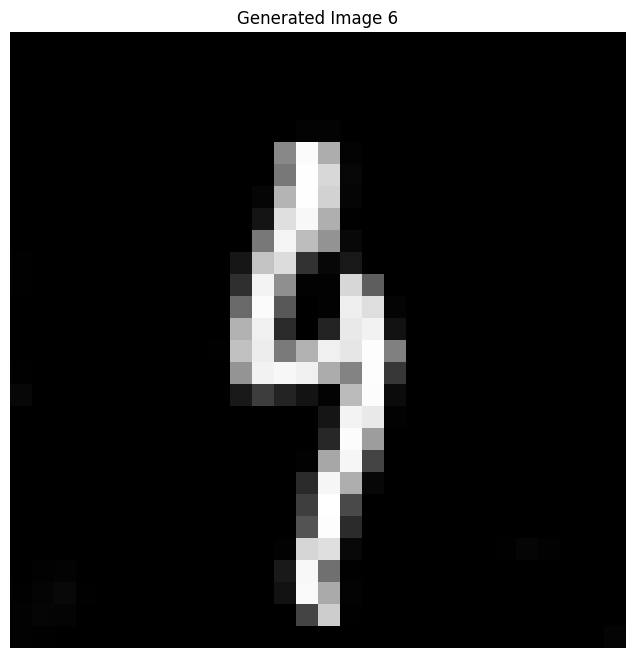

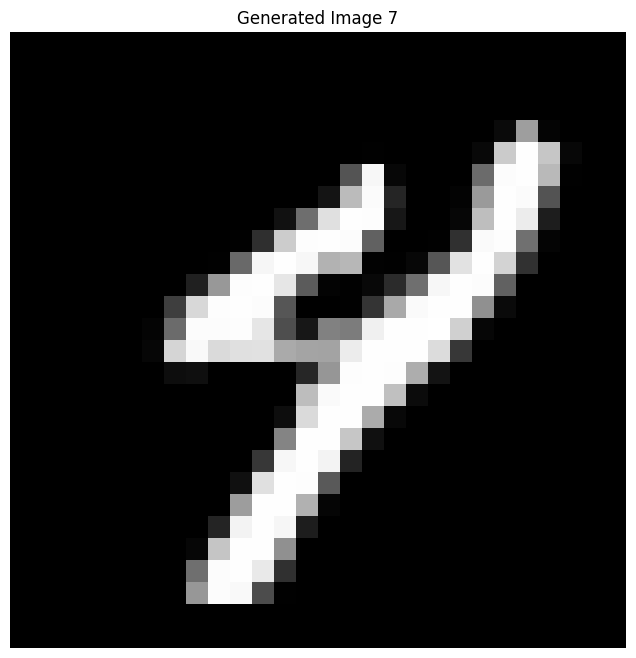

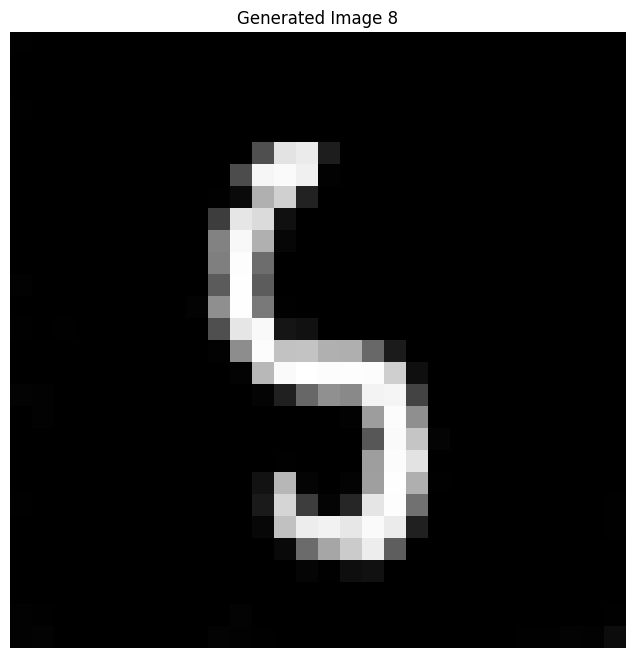

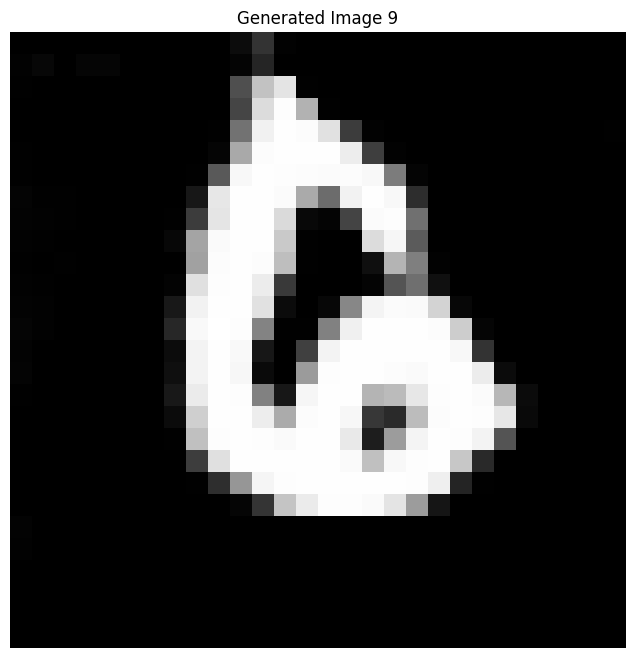

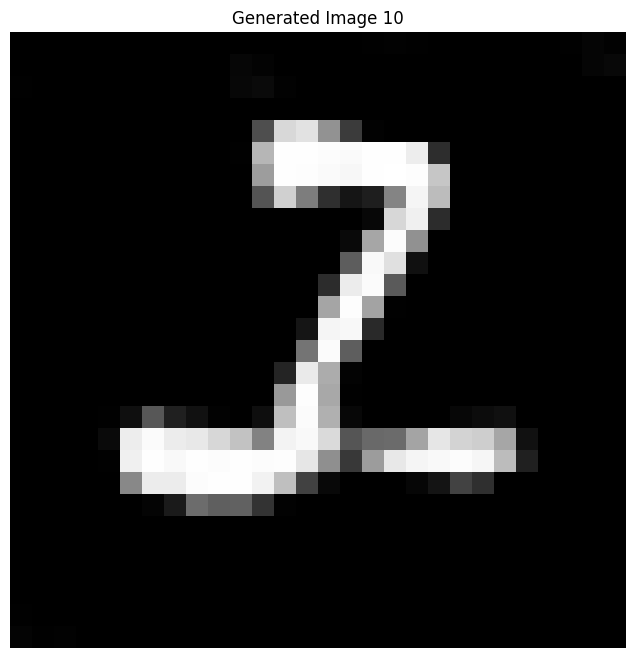

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

# ==================== Parameter Settings ====================
# Hyperparameters
image_size = 28         # Image size for MNIST
batch_size = 256        # Batch size
nz = 100            # Dimension of the noise vector
num_epochs = 100        # Number of training epochs
lr = 0.0005           # Learning rate
beta1 = 0.5           # Beta1 parameter for Adam optimizer

# GPU or CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# ==================== Data Preparation ====================
# Load MNIST dataset
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

mnist_data = datasets.MNIST(root='./data', train=True, download=True, transform=transform)
dataloader = DataLoader(mnist_data, batch_size=batch_size, shuffle=True)

# ==================== Model Definition ====================
# Discriminator model
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 1, 7, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1)

# Generator model
class Generator(nn.Module):
    def __init__(self, nz):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, 128, 7, 1, 0, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 1, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

# Initialize models
netD = Discriminator().to(device)
netG = Generator(nz).to(device)

# Weight initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

netD.apply(weights_init)
netG.apply(weights_init)

# ==================== Loss Function and Optimizer ====================
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

# ==================== Image Display Function ====================
def show_images(images, title):
    grid = make_grid(images, nrow=8, normalize=True)
    np_grid = grid.cpu().numpy().transpose((1, 2, 0))
    plt.figure(figsize=(8, 8))
    plt.imshow(np_grid)
    plt.title(title)
    plt.axis('off')
    plt.show()

# ==================== Generate Pre-training Images ====================
# Use the generator to apply fixed noise vector before training
with torch.no_grad():
    pre_train_fake = netG(fixed_noise).detach().cpu()
    show_images(pre_train_fake, "Pre-trained Generator Output")

# ==================== Training Loop ====================
print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader):
        ############################
        # (1) Update Discriminator: maximize log(D(x)) + log(1 - D(G(z)))
        ############################
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), 1.0, dtype=torch.float, device=device)

        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(0.0)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update Generator: maximize log(D(G(z)))
        ############################
        netG.zero_grad()
        label.fill_(1.0)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] '
                  f'Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} '
                  f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}/{D_G_z2:.4f}')

    # Display generated images for Each Epoch
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    show_images(fake, f"Generated Images at Epoch {epoch}")

# ==================== Generate New Images ====================
def generate_images(generator, num_images, nz, device):
    generator.eval()
    with torch.no_grad():
        for i in range(num_images):
            noise = torch.randn(1, nz, 1, 1, device=device)
            fake_image = generator(noise).detach().cpu()
            show_images(fake_image, f"Generated Image {i + 1}")

# Generate 10 new images by random noises
generate_images(netG, 10, nz, device)


In [ ]:
## Data Augmentation ##
## Audio Data Augmentation ##
## DNN Training ##

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/m

Epoch 1/100, Loss: 17.8992, Precision: 0.2500, Recall: 0.5000, F1: 0.3333
Epoch 2/100, Loss: 3.3734, Precision: 0.2500, Recall: 0.5000, F1: 0.3333
Epoch 3/100, Loss: 2.8785, Precision: 0.2500, Recall: 0.5000, F1: 0.3333
Epoch 4/100, Loss: 2.3485, Precision: 0.2500, Recall: 0.5000, F1: 0.3333
Epoch 5/100, Loss: 3.9615, Precision: 0.6333, Recall: 0.6250, F1: 0.6190
Epoch 6/100, Loss: 2.5725, Precision: 0.8077, Recall: 0.6875, F1: 0.6537
Epoch 7/100, Loss: 2.2686, Precision: 0.7500, Recall: 0.7500, F1: 0.7500
Epoch 8/100, Loss: 2.1090, Precision: 0.8077, Recall: 0.6875, F1: 0.6537
Epoch 9/100, Loss: 2.4639, Precision: 0.8175, Recall: 0.8125, F1: 0.8118
Epoch 10/100, Loss: 2.1195, Precision: 0.8333, Recall: 0.7500, F1: 0.7333
Epoch 11/100, Loss: 2.3813, Precision: 0.8175, Recall: 0.8125, F1: 0.8118
Epoch 12/100, Loss: 2.2279, Precision: 0.8636, Recall: 0.8125, F1: 0.8057
Epoch 13/100, Loss: 2.5212, Precision: 0.7667, Recall: 0.7500, F1: 0.7460
Epoch 14/100, Loss: 2.1234, Precision: 0.8333,

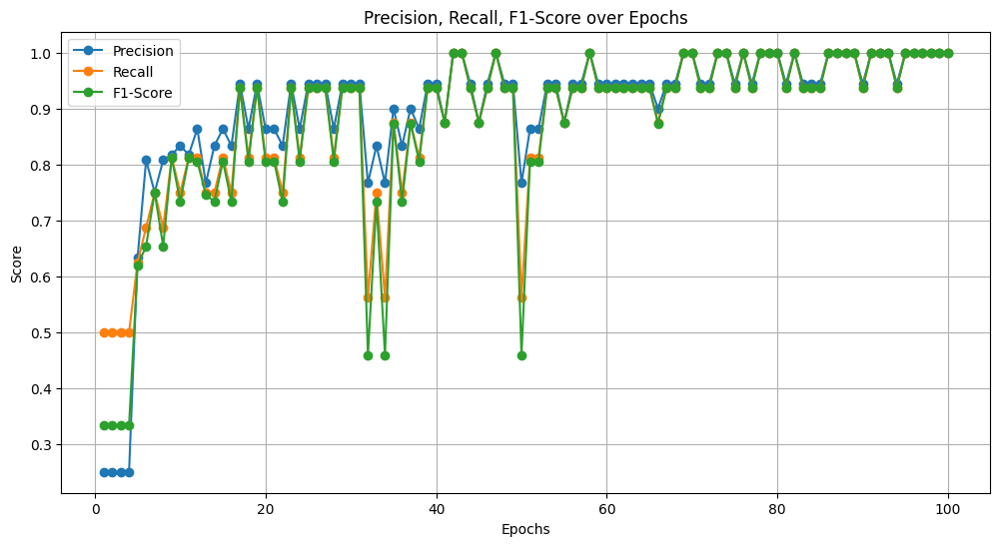

Classification Report:
              precision    recall  f1-score   support

       train       1.00      1.00      1.00         8
      engine       1.00      1.00      1.00         8

    accuracy                           1.00        16
   macro avg       1.00      1.00      1.00        16
weighted avg       1.00      1.00      1.00        16



In [ ]:
import os
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, precision_score, recall_score, f1_score
import librosa
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt

# File paths
audio_path = r"/content/ESC50_MECH"
meta_path = r"/content/esc50.csv"

# Load ESC-50 metadata
metadata = pd.read_csv(meta_path)

# Filter audio files and their categories
available_files = os.listdir(audio_path)
filtered_metadata = metadata[metadata['filename'].isin(available_files)]

# Function to extract audio features (Mel spectrogram)
def extract_features(file_path, sr=44100, n_mels=128, n_fft=2048, hop_length=512):
    """Extract Mel features from audio and compute the mean across the time dimension."""
    try:
        y, sr = librosa.load(file_path, sr=sr)
        # Compute Mel spectrogram
        mel_spectrogram = librosa.feature.melspectrogram(y=y, sr=sr, n_fft=n_fft, hop_length=hop_length, n_mels=n_mels)
        # Convert to log scale
        mel_spectrogram_db = librosa.power_to_db(mel_spectrogram, ref=np.max)
        # Compute the mean of each Mel filter across time
        mel_features = np.mean(mel_spectrogram_db, axis=1)
        return mel_features
    except Exception as e:
        print(f"Error processing {file_path}: {e}")
        return None

# Prepare data
features = []
labels = []

for _, row in filtered_metadata.iterrows():
    file_path = os.path.join(audio_path, row['filename'])
    mel_feature = extract_features(file_path)
    if mel_feature is not None:
        features.append(mel_feature)
        # Assign labels: 0 for 'train', 1 for 'engine'
        if row['category'] == 'train':
            labels.append(0)
        elif row['category'] == 'engine':
            labels.append(1)

# Convert to NumPy arrays
X = np.array(features)
y = np.array(labels)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Convert to PyTorch Dataset
class AudioDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __len__(self):
        return len(self.y)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

train_dataset = AudioDataset(X_train, y_train)
test_dataset = AudioDataset(X_test, y_test)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

# Define a simple DNN model
class AudioClassifier(nn.Module):
    def __init__(self, input_size, num_classes):
        super(AudioClassifier, self).__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, num_classes)
        self.dropout = nn.Dropout(0.5)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.relu(self.fc2(x))
        x = self.dropout(x)
        x = self.fc3(x)
        return x

# Model parameters
input_size = X_train.shape[1]
num_classes = 2  # Two classes: 0 and 1

# Initialize the model
model = AudioClassifier(input_size, num_classes)

# Loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Modify the training function to record precision, recall, and F1-score
def train_model(model, train_loader, test_loader, criterion, optimizer, num_epochs=50):
    model.train()
    epoch_metrics = {
        'precision': [],
        'recall': [],
        'f1': []
    }
    for epoch in range(num_epochs):
        total_loss = 0
        for X_batch, y_batch in train_loader:
            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch)
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        # Evaluate the model at the end of each epoch
        y_test_labels, y_pred_labels = evaluate_model(model, test_loader)
        precision = precision_score(y_test_labels, y_pred_labels, average='macro')
        recall = recall_score(y_test_labels, y_pred_labels, average='macro')
        f1 = f1_score(y_test_labels, y_pred_labels, average='macro')

        # Record metrics for each epoch
        epoch_metrics['precision'].append(precision)
        epoch_metrics['recall'].append(recall)
        epoch_metrics['f1'].append(f1)

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {total_loss:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}")

    # Plot metrics over epochs
    plot_metrics(epoch_metrics)

    # Save the model
    torch.save(model.state_dict(), "/content/Models/audio_classifier_trained.pth")

def plot_metrics(metrics):
    epochs = range(1, len(metrics['precision']) + 1)
    plt.figure(figsize=(12, 6))

    plt.plot(epochs, metrics['precision'], label='Precision', marker='o')
    plt.plot(epochs, metrics['recall'], label='Recall', marker='o')
    plt.plot(epochs, metrics['f1'], label='F1-Score', marker='o')

    plt.xlabel('Epochs')
    plt.ylabel('Score')
    plt.title('Precision, Recall, F1-Score over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

# Test the model
def evaluate_model(model, test_loader):
    model.eval()
    all_preds = []
    all_labels = []
    with torch.no_grad():
        for X_batch, y_batch in test_loader:
            outputs = model(X_batch)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.numpy())
            all_labels.extend(y_batch.numpy())
    return all_labels, all_preds

# Train the model and plot metrics
train_model(model, train_loader, test_loader, criterion, optimizer, num_epochs=100)

# Print classification report
y_test_labels, y_pred_labels = evaluate_model(model, test_loader)
print("Classification Report:")
print(classification_report(y_test_labels, y_pred_labels, target_names=['train', 'engine']))


In [ ]:
## Data Augmentation ##
## Audio Data Augmentation ##
## RL Training ##

<ipython-input-13-c8c700d74f08>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  classifier.load_state_dict(torch.load("/content/Model/audio_classifier_trained.pth", map_lo

Episode 1/100, Total Reward: 40.0000
Episode 2/100, Total Reward: 47.0000
Episode 3/100, Total Reward: 43.0000
Episode 4/100, Total Reward: 48.0000
Episode 5/100, Total Reward: 41.0000
Episode 6/100, Total Reward: 44.0000
Episode 7/100, Total Reward: 38.0000
Episode 8/100, Total Reward: 38.0000
Episode 9/100, Total Reward: 40.0000
Episode 10/100, Total Reward: 44.0000
Episode 11/100, Total Reward: 42.0000
Episode 12/100, Total Reward: 40.0000
Episode 13/100, Total Reward: 38.0000
Episode 14/100, Total Reward: 39.0000
Episode 15/100, Total Reward: 43.0000
Episode 16/100, Total Reward: 38.0000
Episode 17/100, Total Reward: 45.0000
Episode 18/100, Total Reward: 42.0000
Episode 19/100, Total Reward: 45.0000
Episode 20/100, Total Reward: 40.0000
Episode 21/100, Total Reward: 45.0000
Episode 22/100, Total Reward: 42.0000
Episode 23/100, Total Reward: 46.0000
Episode 24/100, Total Reward: 40.0000
Episode 25/100, Total Reward: 46.0000
Episode 26/100, Total Reward: 46.0000
Episode 27/100, Total

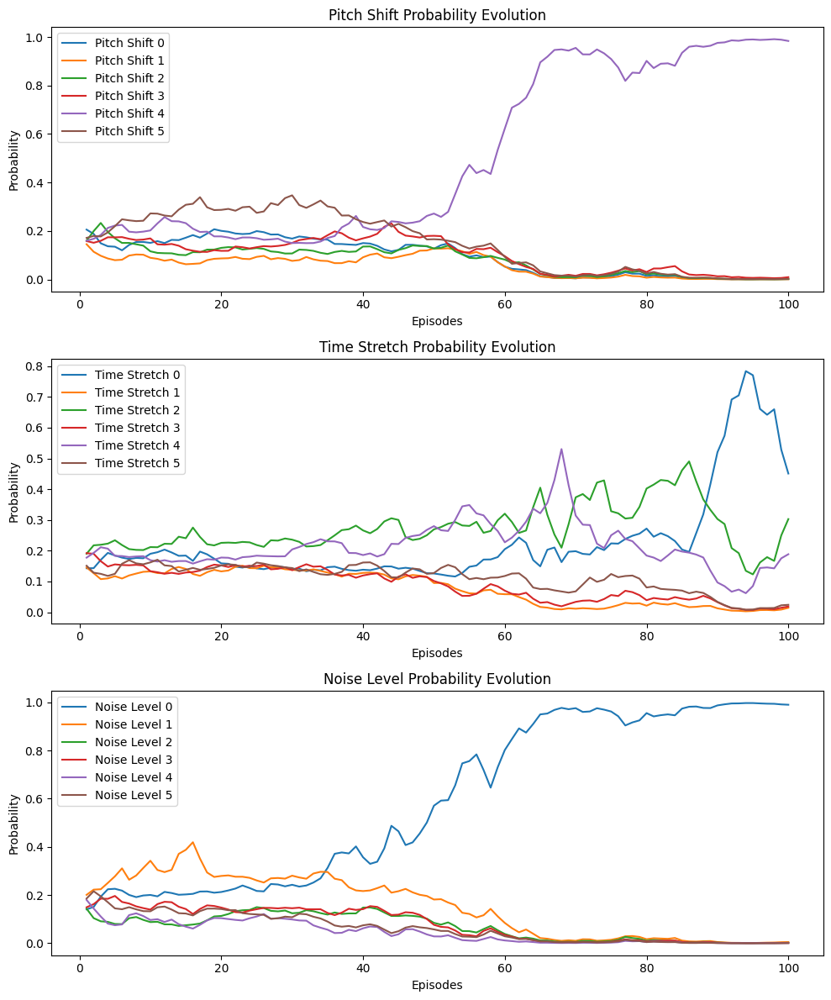

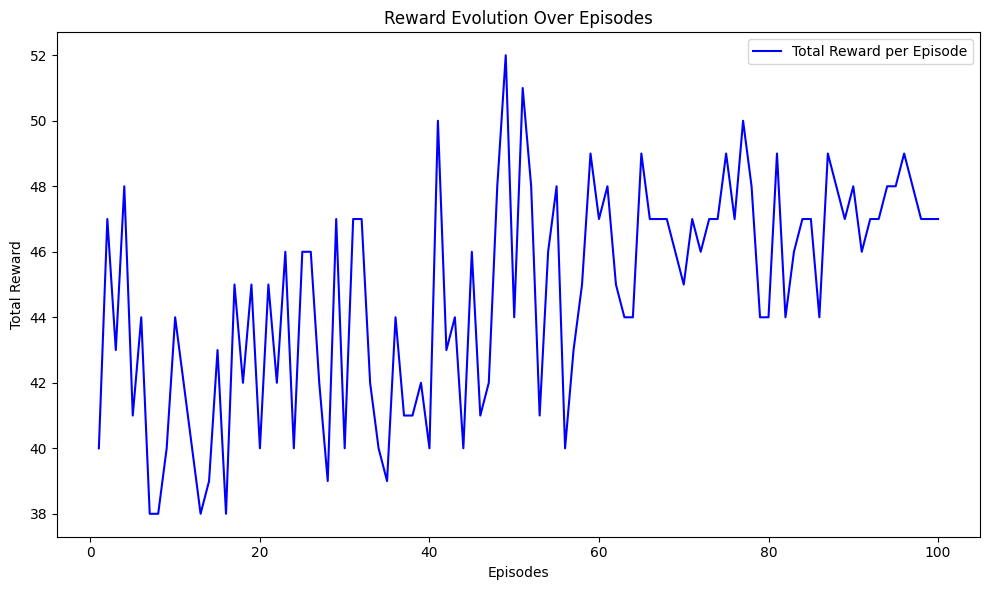

In [ ]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.distributions import Categorical
import librosa
import pandas as pd
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
audio_path = r"/content/ESC50_MECH"

# Define DNN
class AudioClassifier(nn.Module):
    def __init__(self, input_size, num_classes):
        super(AudioClassifier, self).__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, num_classes)
        self.dropout = nn.Dropout(0.5)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.dropout(x)
        x = self.relu(self.fc2(x))
        x = self.dropout(x)
        x = self.fc3(x)
        return x

# Load DNN
input_size = 128
num_classes = 2
classifier = AudioClassifier(input_size, num_classes).to(device)
classifier.load_state_dict(torch.load("/content/Model/audio_classifier_trained.pth", map_location=device))
classifier.eval()

# Policy Network Define
class PolicyNetwork(nn.Module):
    def __init__(self, input_size, output_size):
        super(PolicyNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, 128)
        self.fc2 = nn.Linear(128, 64)
        self.fc3 = nn.Linear(64, output_size)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.fc3(x)
        return x

# Data Augmentation Define
def augment_data(y, sr, pitch_shift, time_stretch, noise_level):
    pitch_shift = np.clip(pitch_shift, -6, 6)
    y_aug = librosa.effects.pitch_shift(y, sr=sr, n_steps=pitch_shift)
    time_stretch = np.clip(time_stretch, 0.7, 1.3)
    y_aug = librosa.effects.time_stretch(y_aug, rate=time_stretch)
    noise_level = np.clip(noise_level, 0, 0.2)
    noise = np.random.normal(0, noise_level, y_aug.shape)
    y_aug = y_aug + noise
    return y_aug

# RL Parameters
policy_net = PolicyNetwork(input_size=4, output_size=18).to(device)
optimizer = optim.Adam(policy_net.parameters(), lr=1e-3)

# Store Action Probability
pitch_shift_prob_history = []
time_stretch_prob_history = []
noise_level_prob_history = []
rewards_history = []

# Training RL model
def train_rl_model(audio_files, labels, num_episodes=20):
    best_reward = -1
    best_parameters = {"pitch_shift": 0, "time_stretch": 1, "noise_level": 0}

    for episode in range(num_episodes):
        total_reward = 0
        pitch_probs, time_probs, noise_probs = [], [], []

        for file, true_label in zip(audio_files, labels):
            file_path = os.path.join(audio_path, file)
            y, sr = librosa.load(file_path, sr=44100)

            state = torch.tensor([0.0, 0.0, 0.0, 0.0], dtype=torch.float32).to(device)

            # Calculate Probability Distribution for Three Parameters
            action_probs = policy_net(state)
            action_probs = action_probs.view(3, 6)
            action_probs_softmax = torch.softmax(action_probs, dim=1)

            # Update PProbability Distribution
            pitch_probs.append(action_probs_softmax[0].cpu().detach().numpy())
            time_probs.append(action_probs_softmax[1].cpu().detach().numpy())
            noise_probs.append(action_probs_softmax[2].cpu().detach().numpy())

            # Augmentation Parameters
            pitch_shift_dist = Categorical(logits=action_probs[0])
            time_stretch_dist = Categorical(logits=action_probs[1])
            noise_level_dist = Categorical(logits=action_probs[2])

            pitch_shift_values = [-6, -4, -2, 2, 4, 6]
            time_stretch_values = [0.75, 0.85, 0.95, 1.05, 1.15, 1.25]
            noise_level_values = [0.0, 0.04, 0.08, 0.12, 0.16, 0.2]

            pitch_shift = pitch_shift_dist.sample().item()
            time_stretch = time_stretch_dist.sample().item()
            noise_level = noise_level_dist.sample().item()

            pitch_shift = pitch_shift_values[pitch_shift]
            time_stretch = time_stretch_values[time_stretch]
            noise_level = noise_level_values[noise_level]

            # Data Augmentation
            y_aug = augment_data(y, sr, pitch_shift, time_stretch, noise_level)

            # Mel Feature from 128 Mel Filters
            mel_spectrogram = librosa.feature.melspectrogram(y=y_aug, sr=sr, n_fft=2048, hop_length=512, n_mels=128)
            mel_features = np.mean(librosa.power_to_db(mel_spectrogram, ref=np.max), axis=1)
            mel_features = torch.tensor(mel_features, dtype=torch.float32).unsqueeze(0).to(device)

            # Classifier Prediction
            with torch.no_grad():
                outputs = classifier(mel_features)
                _, predicted = torch.max(outputs, 1)

            reward = 1 if predicted.item() == int(true_label) else 0
            total_reward += reward

            state = torch.tensor([pitch_shift, time_stretch, noise_level, reward], dtype=torch.float32).to(device)

            # Policy Network Loss and Update
            loss = -(
                pitch_shift_dist.log_prob(torch.tensor(pitch_shift_values.index(pitch_shift)).to(device)) +
                time_stretch_dist.log_prob(torch.tensor(time_stretch_values.index(time_stretch)).to(device)) +
                noise_level_dist.log_prob(torch.tensor(noise_level_values.index(noise_level)).to(device))
            ) * reward

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        pitch_shift_prob_history.append(np.mean(pitch_probs, axis=0))
        time_stretch_prob_history.append(np.mean(time_probs, axis=0))
        noise_level_prob_history.append(np.mean(noise_probs, axis=0))
        rewards_history.append(total_reward)

        if total_reward > best_reward:
            best_reward = total_reward
            best_parameters = {"pitch_shift": pitch_shift, "time_stretch": time_stretch, "noise_level": noise_level}

        print(f"Episode {episode + 1}/{num_episodes}, Total Reward: {total_reward:.4f}")

    # Save Final Parameters
    final_parameters = {"pitch_shift": pitch_shift, "time_stretch": time_stretch, "noise_level": noise_level}

    #  Save best performance and Final parameters
    with open("/content/Model/best_parameters.txt", "w") as f:
        f.write(f"Best Reward: {best_reward}\n")
        f.write(f"Best Parameters:\n")
        f.write(f"Pitch Shift: {best_parameters['pitch_shift']}\n")
        f.write(f"Time Stretch: {best_parameters['time_stretch']}\n")
        f.write(f"Noise Level: {best_parameters['noise_level']}\n")
        f.write("\nFinal Parameters After Training:\n")
        f.write(f"Pitch Shift: {final_parameters['pitch_shift']}\n")
        f.write(f"Time Stretch: {final_parameters['time_stretch']}\n")
        f.write(f"Noise Level: {final_parameters['noise_level']}\n")
    print("Best Performance Parameters Saved")

    plot_prob_history_combined(pitch_shift_prob_history, time_stretch_prob_history, noise_level_prob_history)
    plot_reward_history(rewards_history)

# Visualization
def plot_prob_history_combined(pitch_probs, time_probs, noise_probs):
    episodes = range(1, len(pitch_probs) + 1)

    fig, axes = plt.subplots(3, 1, figsize=(10, 12))

    # Pitch Shift
    for i in range(len(pitch_probs[0])):
        axes[0].plot(episodes, [p[i] for p in pitch_probs], label=f'Pitch Shift {i}')
    axes[0].set_title("Pitch Shift Probability Evolution")
    axes[0].set_xlabel("Episodes")
    axes[0].set_ylabel("Probability")
    axes[0].legend()


    # Time Stretch
    for i in range(len(time_probs[0])):
        axes[1].plot(episodes, [p[i] for p in time_probs], label=f'Time Stretch {i}')
    axes[1].set_title("Time Stretch Probability Evolution")
    axes[1].set_xlabel("Episodes")
    axes[1].set_ylabel("Probability")
    axes[1].legend()


    # Noise Level
    for i in range(len(noise_probs[0])):
        axes[2].plot(episodes, [p[i] for p in noise_probs], label=f'Noise Level {i}')
    axes[2].set_title("Noise Level Probability Evolution")
    axes[2].set_xlabel("Episodes")
    axes[2].set_ylabel("Probability")
    axes[2].legend()


    plt.tight_layout()
    plt.show()

# Reward Plot
def plot_reward_history(rewards_history):
    episodes = range(1, len(rewards_history) + 1)
    plt.figure(figsize=(10, 6))
    plt.plot(episodes, rewards_history, label='Total Reward per Episode', color='b')
    plt.title("Reward Evolution Over Episodes")
    plt.xlabel("Episodes")
    plt.ylabel("Total Reward")
    plt.legend()
    plt.tight_layout()
    plt.show()

# Load all Audios
audio_files = os.listdir(audio_path)

# Load Dataset
meta_path = r"/content/esc50.csv"
metadata = pd.read_csv(meta_path)
filtered_metadata = metadata[metadata['filename'].isin(audio_files)]
labels = filtered_metadata['category'].apply(lambda x: 0 if x == 'train' else 1 if x == 'engine' else -1).tolist()
filtered_files_labels = [(file, label) for file, label in zip(audio_files, labels) if label != -1]
filtered_files, filtered_labels = zip(*filtered_files_labels)

# Training
train_rl_model(filtered_files, filtered_labels, num_episodes=100)


In [ ]:
## Data Augmentation ##
## Text Data Augmentation ##

In [ ]:
import openai

# OpenAI API
openai.api_key = 'API/Key'
# Input Texts
input_texts = [
    "Annealing is a heat treatment method used in metallurgy or materials engineering to alter the microstructure of materials, thereby modifying mechanical properties such as hardness and strength.",
    "Quenching is a heat treatment process applied to metals and glass to enhance the strength and hardness of steel and cast iron.",
    "Tempering involves reheating quenched steel to an appropriate temperature below the austenitic transformation point to reduce brittleness and improve toughness."
]

# For Each Text, Produce Similar Content
for i, input_text in enumerate(input_texts):
    print(f"\n### Original Sentence {i + 1} ###")
    print(f"{input_text}\n")

    response = openai.ChatCompletion.create(
        model="gpt-3.5-turbo",  #GPT Version
        messages=[
            {"role": "system", "content": "You are a detailed and creative assistant."},
            {"role": "user", "content": f"Provide 5 rephrased versions of the following sentence: '{input_text}'"},
        ],
        max_tokens=150,  # Text Length
        temperature=0.7  # Text Variability
    )

    generated_text = response['choices'][0]['message']['content'].strip()
    variations = generated_text.split('\n')

    # Visualization
    print("#### Generated Variations ####")
    for j, variation in enumerate(variations, start=1):
        print(f"{j}. {variation.strip()}")

# ### Original Sentence 1 ###
# Annealing is a heat treatment method used in metallurgy or materials engineering to alter the microstructure of materials, thereby modifying mechanical properties such as hardness and strength.
# #### Generated Variations ####
        #"Annealing, a heat treatment technique employed in metallurgy and materials engineering, is utilized to change the microstructure of materials, hence adjusting mechanical properties like hardness and strength.",
        #"In metallurgy and materials engineering, annealing is a method of heat treatment that is applied to modify the microstructure of materials, thus changing mechanical attributes such as hardness and strength.",
        #"Annealing, a process commonly used in metallurgy and materials engineering, involves heating materials to alter their microstructure, consequently adjusting properties like hardness and strength.",
        #"Metallurgists and materials engineers often utilize annealing, a heat treatment process, to transform the microstructure of materials and modify mechanical characteristics such as hardness and strength.",
        #"In the realm of metallurgy and materials engineering, annealing is a process that modifies the microstructure of materials, impacting properties such as hardness and strength."

# ### Original Sentence 2 ###
# Quenching is a heat treatment process applied to metals and glass to enhance the strength and hardness of steel and cast iron.
# #### Generated Variations ####
        #"The process of quenching is used on metals and glass to increase the strength and hardness of steel and cast iron through heat treatment.",
        #"Quenching is a heat treatment technique utilized on metals and glass to improve the strength and hardness of steel and cast iron.",
        #"Enhancing the strength and hardness of steel and cast iron is achieved through the heat treatment process known as quenching on metals and glass.",
        #"Quenching is a method of heat treatment that is employed on metals and glass to boost the strength and hardness of steel and cast iron.",
        #"The application of quenching on metals and glass is a heat treatment process used to elevate the strength and hardness of steel and cast iron."


# ### Original Sentence 3 ###
# Tempering involves reheating quenched steel to an appropriate temperature below the austenitic transformation point to reduce brittleness and improve toughness.
# #### Generated Variations ####
        #"Tempering includes heating hardened steel to a specific temperature below the austenitic transformation point to enhance toughness and decrease brittleness.",
        #"Tempering is the process of reheating quenched steel to a temperature below the austenitic transformation point in order to enhance toughness and reduce brittleness.",
        #"To improve toughness and reduce brittleness, tempered steel is reheated to a temperature below the austenitic transformation point.",
        #"The act of reheating quenched steel to a temperature below the austenitic transformation point is known as tempering, which aims to enhance toughness and decrease brittleness.",
        #"Tempering is a technique that involves heating hardened steel to a specific temperature below the austenitic transformation point, thus improving toughness and reducing brittleness."




In [ ]:
### Text Augmentation Evaluation

In [ ]:
pip install bert_score

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 5.2 MB/s eta 0:00:00


In [ ]:
from bert_score import score

# Original Sentences
original_sentences = [
    "Annealing is a heat treatment method used in metallurgy or materials engineering to alter the microstructure of materials, thereby modifying mechanical properties such as hardness and strength.",
    "Quenching is a heat treatment process applied to metals and glass to enhance the strength and hardness of steel and cast iron.",
    "Tempering involves reheating quenched steel to an appropriate temperature below the austenitic transformation point to reduce brittleness and improve toughness."
]

# Generated Sentences
generated_sentences = [
    [
        "Annealing, a heat treatment technique employed in metallurgy and materials engineering, is utilized to change the microstructure of materials, hence adjusting mechanical properties like hardness and strength.",
        "In metallurgy and materials engineering, annealing is a method of heat treatment that is applied to modify the microstructure of materials, thus changing mechanical attributes such as hardness and strength.",
        "Annealing, a process commonly used in metallurgy and materials engineering, involves heating materials to alter their microstructure, consequently adjusting properties like hardness and strength.",
        "Metallurgists and materials engineers often utilize annealing, a heat treatment process, to transform the microstructure of materials and modify mechanical characteristics such as hardness and strength.",
        "In the realm of metallurgy and materials engineering, annealing is a process that modifies the microstructure of materials, impacting properties such as hardness and strength."
    ],
    [
        "The process of quenching is used on metals and glass to increase the strength and hardness of steel and cast iron through heat treatment.",
        "Quenching is a heat treatment technique utilized on metals and glass to improve the strength and hardness of steel and cast iron.",
        "Enhancing the strength and hardness of steel and cast iron is achieved through the heat treatment process known as quenching on metals and glass.",
        "Quenching is a method of heat treatment that is employed on metals and glass to boost the strength and hardness of steel and cast iron.",
        "The application of quenching on metals and glass is a heat treatment process used to elevate the strength and hardness of steel and cast iron."
    ],
    [
        "Tempering includes heating hardened steel to a specific temperature below the austenitic transformation point to enhance toughness and decrease brittleness.",
        "Tempering is the process of reheating quenched steel to a temperature below the austenitic transformation point in order to enhance toughness and reduce brittleness.",
        "To improve toughness and reduce brittleness, tempered steel is reheated to a temperature below the austenitic transformation point.",
        "The act of reheating quenched steel to a temperature below the austenitic transformation point is known as tempering, which aims to enhance toughness and decrease brittleness.",
        "Tempering is a technique that involves heating hardened steel to a specific temperature below the austenitic transformation point, thus improving toughness and reducing brittleness."
    ]
]

# Calculate BERTScore
for i, (original, generated) in enumerate(zip(original_sentences, generated_sentences), start=1):
    P, R, F1 = score(generated, [original] * len(generated), lang="en", verbose=False)
    print(f"\nSentence {i} (Original):")
    print(original)
    print("\nGenerated Sentences and F1 Scores:")
    for j, (gen_sentence, f1) in enumerate(zip(generated, F1), start=1):
        print(f"{j}. {gen_sentence}\n   F1 Score: {f1:.4f}")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Sentence 1 (Original):
Annealing is a heat treatment method used in metallurgy or materials engineering to alter the microstructure of materials, thereby modifying mechanical properties such as hardness and strength.

Generated Sentences and F1 Scores:
1. Annealing, a heat treatment technique employed in metallurgy and materials engineering, is utilized to change the microstructure of materials, hence adjusting mechanical properties like hardness and strength.
   F1 Score: 0.9758
2. In metallurgy and materials engineering, annealing is a method of heat treatment that is applied to modify the microstructure of materials, thus changing mechanical attributes such as hardness and strength.
   F1 Score: 0.9519
3. Annealing, a process commonly used in metallurgy and materials engineering, involves heating materials to alter their microstructure, consequently adjusting properties like hardness and strength.
   F1 Score: 0.9595
4. Metallurgists and materials engineers often utilize annealing,

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Sentence 2 (Original):
Quenching is a heat treatment process applied to metals and glass to enhance the strength and hardness of steel and cast iron.

Generated Sentences and F1 Scores:
1. The process of quenching is used on metals and glass to increase the strength and hardness of steel and cast iron through heat treatment.
   F1 Score: 0.9566
2. Quenching is a heat treatment technique utilized on metals and glass to improve the strength and hardness of steel and cast iron.
   F1 Score: 0.9874
3. Enhancing the strength and hardness of steel and cast iron is achieved through the heat treatment process known as quenching on metals and glass.
   F1 Score: 0.9347
4. Quenching is a method of heat treatment that is employed on metals and glass to boost the strength and hardness of steel and cast iron.
   F1 Score: 0.9806
5. The application of quenching on metals and glass is a heat treatment process used to elevate the strength and hardness of steel and cast iron.
   F1 Score: 0.9593


Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



Sentence 3 (Original):
Tempering involves reheating quenched steel to an appropriate temperature below the austenitic transformation point to reduce brittleness and improve toughness.

Generated Sentences and F1 Scores:
1. Tempering includes heating hardened steel to a specific temperature below the austenitic transformation point to enhance toughness and decrease brittleness.
   F1 Score: 0.9680
2. Tempering is the process of reheating quenched steel to a temperature below the austenitic transformation point in order to enhance toughness and reduce brittleness.
   F1 Score: 0.9712
3. To improve toughness and reduce brittleness, tempered steel is reheated to a temperature below the austenitic transformation point.
   F1 Score: 0.9443
4. The act of reheating quenched steel to a temperature below the austenitic transformation point is known as tempering, which aims to enhance toughness and decrease brittleness.
   F1 Score: 0.9464
5. Tempering is a technique that involves heating harden

In [ ]:
## Data Standardization ##
## Multimodal Standardization ##

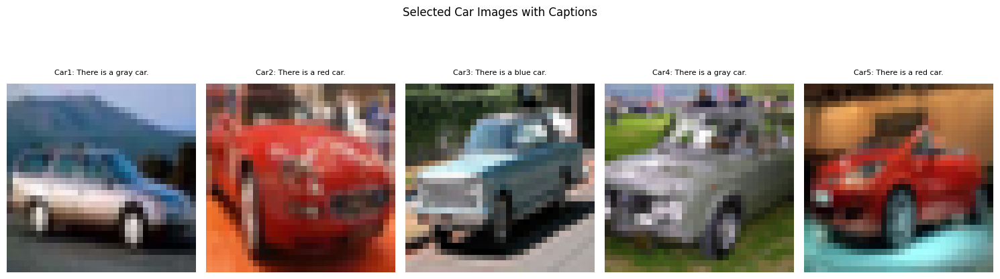

Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['vit.pooler.dense.bias', 'vit.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.


Car 1 Features:
[[ 1.00000008e+00  5.04873008e-01]
 [ 1.00000001e+00  6.89417748e-01]
 [ 2.85416071e-01  1.27602700e-02]
 ...
 [ 3.01813991e-01  6.94231361e-02]
 [ 2.40962671e-01  2.31582748e-01]
 [-3.54491370e-09  9.00163588e-01]]
--------------------------------------------------
Car 2 Features:
[[ 1.87874435e-01  4.07111325e-01]
 [-2.56641357e-08  6.17603119e-01]
 [ 9.89325612e-01  2.11931825e-01]
 ...
 [ 1.00000002e+00  7.38363330e-02]
 [-3.55634988e-09  1.86171902e-01]
 [ 2.21975491e-01  9.99999938e-01]]
--------------------------------------------------
Car 3 Features:
[[0.58976534 0.4518968 ]
 [0.47195506 0.60064944]
 [0.93946149 0.06488795]
 ...
 [0.74349528 0.09059312]
 [0.59525991 0.26093539]
 [0.34971942 0.97283301]]
--------------------------------------------------
Car 4 Features:
[[ 2.49815741e-08  5.01827600e-01]
 [ 3.71077567e-01  7.19073548e-01]
 [ 9.18881460e-01 -1.06238920e-10]
 ...
 [ 5.80020444e-01  7.14535275e-09]
 [ 1.00000001e+00  2.50610322e-01]
 [ 7.82283984e-

In [ ]:
import os
import pickle
import numpy as np
import torch
from torchvision import transforms
from transformers import ViTModel, AutoImageProcessor, BertModel, BertTokenizer
from PIL import Image
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

data_path = r"/content/cifar-10-batches-py"
def load_cifar10_batch(file):
    with open(file, 'rb') as fo:
        data_dict = pickle.load(fo, encoding='bytes')
    data = data_dict[b'data']
    labels = data_dict[b'labels']
    data = data.reshape(len(data), 3, 32, 32).transpose(0, 2, 3, 1)
    return data, labels

def load_cifar10_data(data_path):
    images, labels = [], []
    for batch in range(1, 6):
        file_path = os.path.join(data_path, f"data_batch_{batch}")
        data, batch_labels = load_cifar10_batch(file_path)
        images.append(data)
        labels.extend(batch_labels)
    return np.concatenate(images), labels

images, labels = load_cifar10_data(data_path)
car_images = [images[i] for i in range(len(labels)) if labels[i] == 1][:5]

# Image Captions
captions = [
    "Car1: There is a gray car.",
    "Car2: There is a red car.",
    "Car3: There is a blue car.",
    "Car4: There is a gray car.",
    "Car5: There is a red car."
]

# Filter First 5 Cars
plt.figure(figsize=(15, 5))
for i, (img, caption) in enumerate(zip(car_images, captions)):
    plt.subplot(1, 5, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(caption, fontsize=8, pad=10)
plt.suptitle("Selected Car Images with Captions")
plt.tight_layout()
plt.show()

# Load ViT
vit_model_name = "google/vit-base-patch16-224"
vit_model = ViTModel.from_pretrained(vit_model_name)
vit_feature_extractor = AutoImageProcessor.from_pretrained(vit_model_name)
vit_model.eval()

# Load BERT
bert_model_name = "bert-base-uncased"
bert_model = BertModel.from_pretrained(bert_model_name)
bert_tokenizer = BertTokenizer.from_pretrained(bert_model_name)
bert_model.eval()

# Image Preprocessing
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=vit_feature_extractor.image_mean, std=vit_feature_extractor.image_std)
])

# Extract Image Features
image_features = []
for img_array in car_images:
    img = Image.fromarray(img_array)
    input_tensor = preprocess(img).unsqueeze(0)
    with torch.no_grad():
        output = vit_model(input_tensor)
        feature = output.last_hidden_state[:, 0, :]
        image_features.append(feature.squeeze().numpy())

# Extract Text Features
text_features = []
for caption in captions:
    inputs = bert_tokenizer(caption, return_tensors="pt")
    with torch.no_grad():
        output = bert_model(**inputs)
        feature = output.last_hidden_state[:, 0, :]  # [CLS] Global token
        text_features.append(feature.squeeze().numpy())

# Min-Max Standardization
scaler = MinMaxScaler()
all_features = np.vstack(image_features + text_features)
scaler.fit(all_features)

image_features_scaled = scaler.transform(image_features)
text_features_scaled = scaler.transform(text_features)

# Preserve Image-Text Matrix
paired_features = []
for img_feat, txt_feat in zip(image_features_scaled, text_features_scaled):
    paired_feature = np.stack([img_feat, txt_feat], axis=1)  # [768, 2]
    paired_features.append(paired_feature)

# Print Matrix
for i, paired_feature in enumerate(paired_features):
    print(f"Car {i + 1} Features:")
    print(paired_feature)
    print("-" * 50)
